In [1]:
import git
import sys
import os
sys.path.append("../python")
sys.path.append(os.path.join(os.environ["ALSVINN_BUILD_PATH"], "python"))


import alsvinn
import numpy as np
import plot_info
import matplotlib.pyplot as plt

# The sample solution will be generated at SAMPLE_SOLUTION_FACTOR*highest_resolution_in_convergence
SAMPLE_SOLUTION_FACTOR=int(os.environ.get("FVM_TV_CONVERGENCE_SAMPLE_SOLUTION_FACTOR", 32))

# This should be the highest resolution you can afford to run one sample of (or 50 samples rather)
# MUST BE A POWER OF 2
COMPUTATIONAL_BUDGET=int(os.environ.get("FVM_TV_CONVERGENCE_COMPUTATIONAL_BUDGET", 2**15))

# This should be the highest resolution you can afford to run one sample with t=0
# MUST BE A POWER OF 2
COMPUTATIONAL_T0_BUDGET=int(os.environ.get("FVM_TV_CONVERGENCE_COMPUTATIONAL_T0_BUDGET", 2**15))

# Number of samples for uq runs
NUMBER_OF_SAMPLES=int(os.environ.get("FVM_TV_CONVERGENCE_NUMBER_OF_SAMPLES", 512))

#################################################################################################

# Highest single resolution for deterministic convergence
CONVERGENCE_DET_HIGHEST_RESOLUTION=int(COMPUTATIONAL_BUDGET/SAMPLE_SOLUTION_FACTOR)

# Highest single resolution for uq convergence (we estimate the runtime)
CONVERGENCE_UQ_HIGHEST_RESOLUTION=2**int(np.log2(COMPUTATIONAL_BUDGET/(SAMPLE_SOLUTION_FACTOR)/(np.sqrt(NUMBER_OF_SAMPLES))))


START_CONVERGENCE_DET_LOG=int(max(2, int(np.log2(CONVERGENCE_DET_HIGHEST_RESOLUTION))-7))
END_CONVERGENCE_DET_LOG=int(np.log2(CONVERGENCE_DET_HIGHEST_RESOLUTION))

START_CONVERGENCE_UQ_LOG=int(max(2, int(np.log2(CONVERGENCE_UQ_HIGHEST_RESOLUTION))-7))
END_CONVERGENCE_UQ_LOG=int(np.log2(CONVERGENCE_UQ_HIGHEST_RESOLUTION))

HIGHEST_RESOLUTION_UQ_T0 = 2**int(np.log2(COMPUTATIONAL_T0_BUDGET/np.sqrt(NUMBER_OF_SAMPLES)))

START_CAUCHY_UQ_T0_LOG=int(max(2, int(np.log2(HIGHEST_RESOLUTION_UQ_T0))-7))
END_CAUCHY_UQ_T0_LOG=int(np.log2(HIGHEST_RESOLUTION_UQ_T0))

START_CAUCHY_DET_T0_LOG=int(max(2, int(np.log2(COMPUTATIONAL_T0_BUDGET))-7))
END_CAUCHY_DET_T0_LOG=int(np.log2(COMPUTATIONAL_T0_BUDGET))




plot_info.console_log_show("SAMPLE_SOLUTION_FACTOR={}".format(SAMPLE_SOLUTION_FACTOR))
plot_info.console_log_show("COMPUTATIONAL_BUDGET={}".format(COMPUTATIONAL_BUDGET))
plot_info.console_log_show("COMPUTATIONAL_T0_BUDGET={}".format(COMPUTATIONAL_T0_BUDGET))
plot_info.console_log_show("NUMBER_OF_SAMPLES={}".format(NUMBER_OF_SAMPLES))
plot_info.console_log_show("CONVERGENCE_DET_HIGHEST_RESOLUTION={}".format(CONVERGENCE_DET_HIGHEST_RESOLUTION))
plot_info.console_log_show("CONVERGENCE_UQ_HIGHEST_RESOLUTION={}".format(CONVERGENCE_UQ_HIGHEST_RESOLUTION))
plot_info.console_log_show("START_CONVERGENCE_DET_LOG={}".format(START_CONVERGENCE_DET_LOG))
plot_info.console_log_show("END_CONVERGENCE_DET_LOG={}".format(END_CONVERGENCE_DET_LOG))
plot_info.console_log_show("START_CONVERGENCE_UQ_LOG={}".format(START_CONVERGENCE_UQ_LOG))
plot_info.console_log_show("END_CONVERGENCE_UQ_LOG={}".format(END_CONVERGENCE_UQ_LOG))
plot_info.console_log_show("HIGHEST_RESOLUTION_UQ_T0={}".format(HIGHEST_RESOLUTION_UQ_T0))
plot_info.console_log_show("START_CAUCHY_UQ_T0_LOG={}".format(START_CAUCHY_UQ_T0_LOG))
plot_info.console_log_show("END_CAUCHY_UQ_T0_LOG={}".format(END_CAUCHY_UQ_T0_LOG))
plot_info.console_log_show("START_CAUCHY_DET_T0_LOG={}".format(START_CAUCHY_DET_T0_LOG))
plot_info.console_log_show("END_CAUCHY_DET_T0_LOG={}".format(END_CAUCHY_DET_T0_LOG))

alsvinn_repo = git.Repo(path=os.environ["ALSVINN_BUILD_PATH"], search_parent_directories=True)

alsvinn_commit_sha = alsvinn_repo.head.object.hexsha
alsvinn_short_commit_sha =  alsvinn_repo.git.rev_parse(alsvinn_commit_sha, short=1)

plot_info.set_alsvinn_sha(alsvinn_commit_sha, alsvinn_short_commit_sha)

2019-04-25 09:41:35.589402 (in <module>): SAMPLE_SOLUTION_FACTOR=32
2019-04-25 09:41:36.000539 (in <module>): COMPUTATIONAL_BUDGET=32768
2019-04-25 09:41:36.006215 (in <module>): COMPUTATIONAL_T0_BUDGET=32768
2019-04-25 09:41:36.011515 (in <module>): NUMBER_OF_SAMPLES=512
2019-04-25 09:41:36.016808 (in <module>): CONVERGENCE_DET_HIGHEST_RESOLUTION=1024
2019-04-25 09:41:36.022105 (in <module>): CONVERGENCE_UQ_HIGHEST_RESOLUTION=32
2019-04-25 09:41:36.027396 (in <module>): START_CONVERGENCE_DET_LOG=3
2019-04-25 09:41:36.032706 (in <module>): END_CONVERGENCE_DET_LOG=10
2019-04-25 09:41:36.038002 (in <module>): START_CONVERGENCE_UQ_LOG=2
2019-04-25 09:41:36.043298 (in <module>): END_CONVERGENCE_UQ_LOG=5
2019-04-25 09:41:36.048618 (in <module>): HIGHEST_RESOLUTION_UQ_T0=1024
2019-04-25 09:41:36.053927 (in <module>): START_CAUCHY_UQ_T0_LOG=3
2019-04-25 09:41:36.059233 (in <module>): END_CAUCHY_UQ_T0_LOG=10
2019-04-25 09:41:36.064541 (in <module>): START_CAUCHY_DET_T0_LOG=8
2019-04-25 09:41:3

In [2]:
class ExactLinearSolution(object):
    def __init__(self, initial_data):
        self.initial_data = np.copy(np.array(initial_data))
        self.x, self.dx = np.linspace(0, 1, initial_data.shape[0], retstep=True)
        
    def __call__(self, t):
        x_shift = int(t/self.dx)

        u = np.roll(np.copy(self.initial_data), x_shift)
        
        return u
    

In [3]:
equations = ["burgers", "cubic", "linear"]

numerical_fluxes = {}

numerical_fluxes["burgers"] = ["rusanov", "godunov", "roe"]
numerical_fluxes["linear"] = ["rusanov", "upwind"]
numerical_fluxes["cubic"] = ["rusanov", "roe"]

exact_solutions = {}
exact_solutions["burgers"] = None
exact_solutions["linear"] = ExactLinearSolution
exact_solutions["cubic"] = None

def run_all_configurations(function_to_call, T):
    for equation in equations:
        plot_info.display(plot_info.HTML("<h1>{}<h1>".format(equation)))
        for numerical_flux in numerical_fluxes[equation]:
            plot_info.display(plot_info.HTML("<h2>{}<h2>".format(numerical_flux)))
            
            function_to_call(equation, numerical_flux, exact_solutions[equation], T)

# Convergence runs

In [4]:
def run_convergence(base_xml, title, T, 
                    exact_solution_class=None,
                    numerical_flux="rusanov",
                    equation="burgers"):
    resolutions = 2**np.arange(START_CONVERGENCE_DET_LOG, END_CONVERGENCE_DET_LOG)
    errors = []
    
    
    
    ## Make sample solution
    sample_solution_run = alsvinn.run(name="sample_solution",
        base_xml=base_xml,
        number_of_saves=1,
        dimension=[SAMPLE_SOLUTION_FACTOR*resolutions[-1],1,1],
        flux=numerical_flux,
        equation=equation,
        uq=True, # notice that since we have Brownian initial data, we need to enable uq
        T=T)
    
    if exact_solution_class is None:
        sample_solution = sample_solution_run.get_data("u", 1)
    else:
        initial_data = sample_solution_run.get_data("u", 0)

        exact_solution_object = exact_solution_class(initial_data)
        
        sample_solution = exact_solution_object(T)
        
    r_sample = sample_solution.shape[0]
    
    
    ## Loop over resolutions
    for r in resolutions:
        ## Just some progress output, can be deleted
        sys.stdout.write("Resolution = {}\r".format(r))
        sys.stdout.flush()
        
        ## This is where we run alsvinn for the given resolution
        run = alsvinn.run(name="convergence_run",
                         base_xml=base_xml,
                         number_of_saves=1,
                         dimension=[r,1,1],
                         flux=numerical_flux,
                         equation=equation,
                         uq=True, # notice that since we have Brownian initial data, we need to enable uq
                         T=T)
        
        u_approx = run.get_data("u", 1)
        
        u_approx_upscaled = np.repeat(u_approx, r_sample//r)
        
        ## Compute L^1 error
        errors.append(np.sum(abs(u_approx_upscaled-sample_solution))/r_sample)
        
    errors = np.array(errors)
    sys.stdout.write("\r")
    plt.figure(0)
    ## Plot results, enable basex=2 to get nicer x axis
    line_info = plt.loglog(resolutions, errors, '-o',basex=2, basey=2,
                           label=title)
    plt.grid(True)
    
    poly = np.polyfit(np.log(resolutions), np.log(errors), 1)
    plt.loglog(resolutions, np.exp(poly[1])*resolutions**poly[0], '--', 
               color=line_info[0].get_color(), 
               label='$\\mathcal{O}(M^{%.2f})$' % poly[0],
              basex=2, basey=2)
    plt.legend()
    
    
    
    plt.xlabel("Number of cells ($M$)")
    plt.ylabel("Error ($||\\cdot||_{L^1([0,1])}$)")
    plt.legend()
    
    
    plt.figure(1)
    ## Plot results, enable basex=2 to get nicer x axis
    line_info = plt.loglog(1.0/resolutions, errors, '-o',basex=2, basey=2,
                           label=title)
    plt.grid(True)
    
    poly = np.polyfit(np.log(1.0/resolutions), np.log(errors), 1)
    plt.loglog(1.0/resolutions, np.exp(poly[1])*resolutions**(-poly[0]), '--', 
               color=line_info[0].get_color(), 
               label='$\\mathcal{O}(\\Delta x^{%.2f})$' % poly[0],
              basex=2, basey=2)
    plt.legend()
    
    plt.xlabel("$\\Delta x$")
    plt.ylabel("Error ($||\\cdot||_{L^1([0,1])}$)")
    plt.legend()
    
    
    plt.figure(2)
    ## Plot results, enable basex=2 to get nicer x axis
    line_info = plt.loglog(1.0/resolutions, errors, '-o',basex=2, basey=2,
                           label=title)
    plt.grid(True)
    
    poly = np.polyfit(np.log(1.0/resolutions), np.log(-errors/np.log(1/resolutions)), 1)
    plt.loglog(1.0/resolutions, -np.log(1/resolutions)*np.exp(poly[1])*resolutions**(-poly[0]), '--', 
               color=line_info[0].get_color(), 
               label='$\\mathcal{O}(-\\log(\\Delta x)\\Delta x^{%.2f})$' % poly[0],
              basex=2, basey=2)
    plt.legend()
    
    plt.xlabel("$\\Delta x$")
    plt.ylabel("Error ($||\\cdot||_{L^1([0,1])}$)")
    plt.legend()
   
    plot_info.console_log_show("Done configuration {} {} {} {}".format(base_xml, equation, numerical_flux, T))
        
        

# Sanity check with sine initial data



2019-04-25 09:48:13.387904 (in run_convergence): Done configuration ../configs/sine/sine.xml burgers rusanov 0.25


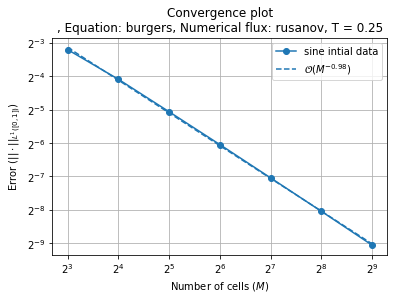

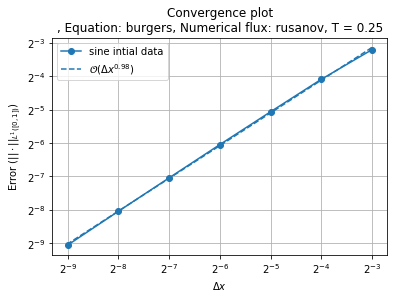

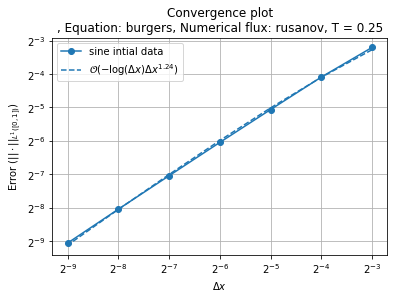

2019-04-25 09:55:05.779501 (in run_convergence): Done configuration ../configs/sine/sine.xml burgers godunov 0.25


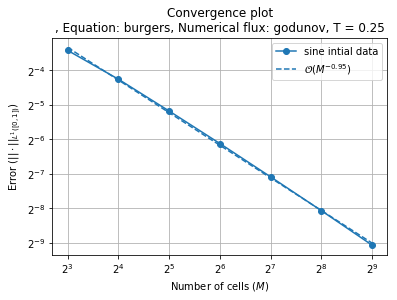

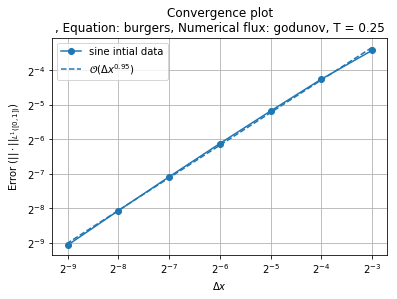

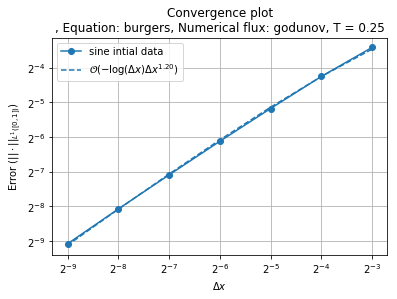

2019-04-25 10:01:44.021394 (in run_convergence): Done configuration ../configs/sine/sine.xml burgers roe 0.25


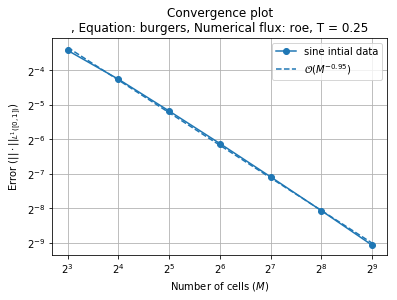

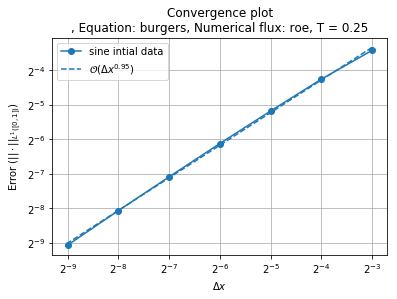

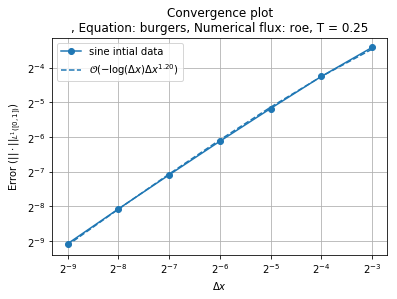

2019-04-25 10:13:23.516887 (in run_convergence): Done configuration ../configs/sine/sine.xml cubic rusanov 0.25


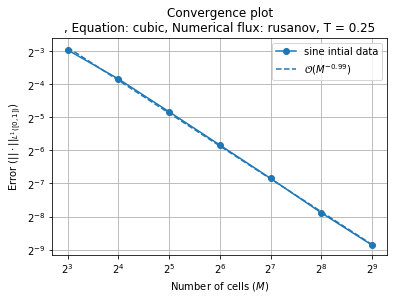

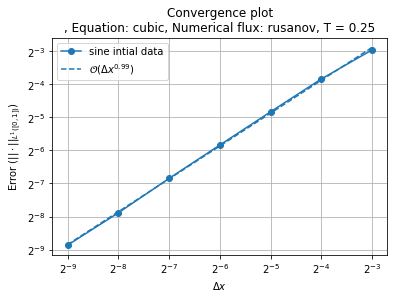

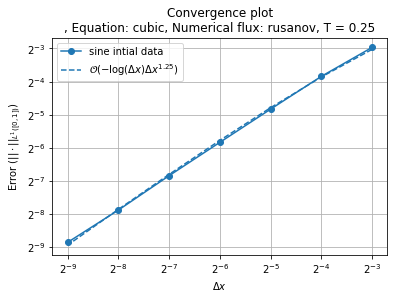

2019-04-25 10:23:08.320223 (in run_convergence): Done configuration ../configs/sine/sine.xml cubic roe 0.25


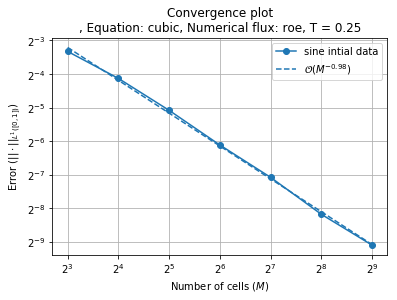

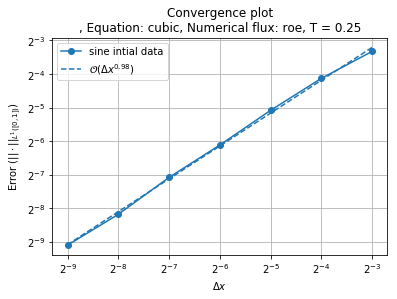

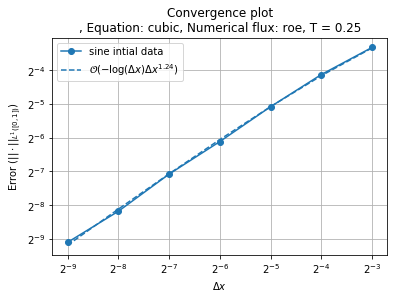

2019-04-25 10:27:31.932832 (in run_convergence): Done configuration ../configs/sine/sine.xml linear rusanov 0.25


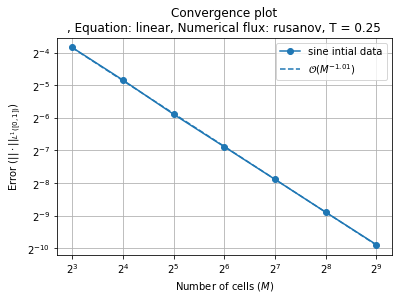

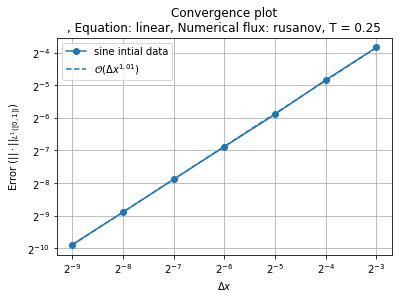

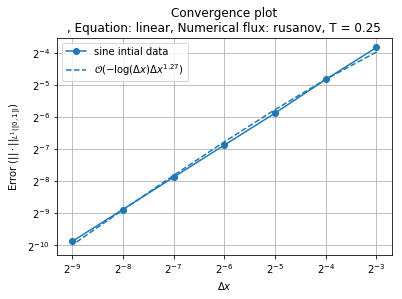

2019-04-25 10:31:55.399679 (in run_convergence): Done configuration ../configs/sine/sine.xml linear upwind 0.25


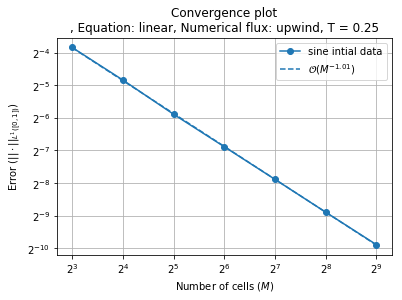

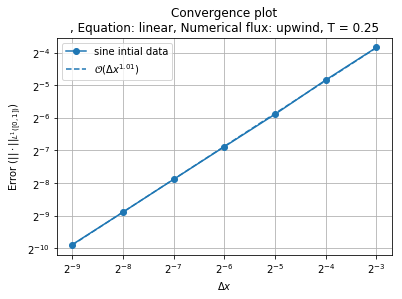

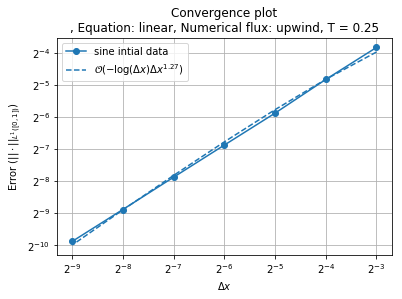

2019-04-25 10:31:57.127409 (in <module>): Done with sine


In [5]:
def run_sine_convergence(equation, numerical_flux, exact_solution, T):
    base_xml_format_string = '../configs/sine/sine.xml'



    base_xml = base_xml_format_string
     
    name = "sine intial data"
    run_convergence(base_xml, name, T, numerical_flux=numerical_flux,
                   equation=equation, exact_solution_class=exact_solution)
    
    plt.figure(0)
    plt.title("Convergence plot\n, Equation: {equation}, Numerical flux: {numerical_flux}, T = {T}"\
              .format(equation=equation, numerical_flux=numerical_flux, T=T))

    plt.figure(1)
    plt.title("Convergence plot\n, Equation: {equation}, Numerical flux: {numerical_flux}, T = {T}"\
              .format(equation=equation, numerical_flux=numerical_flux, T=T))
    
    plt.figure(2)
    plt.title("Convergence plot\n, Equation: {equation}, Numerical flux: {numerical_flux}, T = {T}"\
              .format(equation=equation, numerical_flux=numerical_flux, T=T))
    
    plt.show()

    
run_all_configurations(run_sine_convergence, 0.25)
plot_info.console_log_show("Done with sine")
        
        

# Convergence runs for fBm

2019-04-25 10:32:21.991142 (in run_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml burgers rusanov 0.00048828125
2019-04-25 10:32:46.672436 (in run_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml burgers rusanov 0.00048828125
2019-04-25 10:33:12.440294 (in run_convergence): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml burgers rusanov 0.00048828125
2019-04-25 10:33:37.387097 (in run_convergence): Done configuration ../configs/fractional_brownian_0_75/fractional_brownian.xml burgers rusanov 0.00048828125


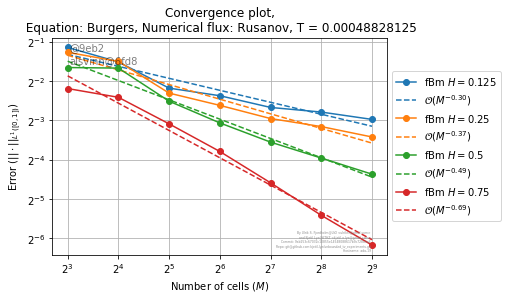

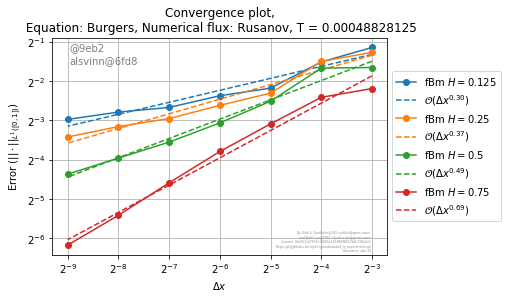

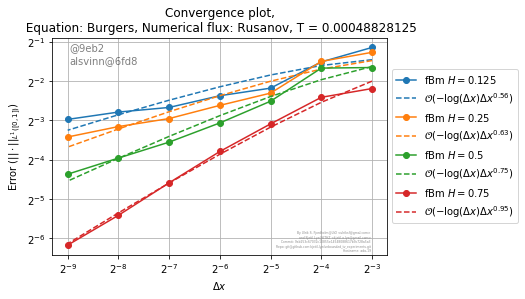

2019-04-25 10:34:16.471592 (in run_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml burgers godunov 0.00048828125
2019-04-25 10:34:41.688080 (in run_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml burgers godunov 0.00048828125
2019-04-25 10:35:06.888475 (in run_convergence): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml burgers godunov 0.00048828125
2019-04-25 10:35:31.826038 (in run_convergence): Done configuration ../configs/fractional_brownian_0_75/fractional_brownian.xml burgers godunov 0.00048828125


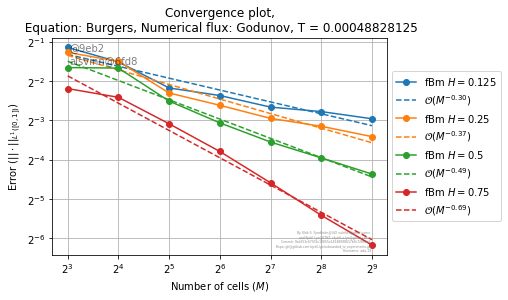

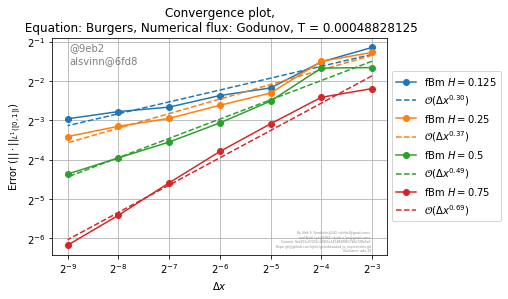

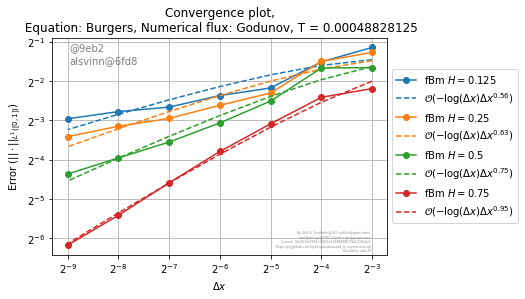

2019-04-25 10:36:10.374919 (in run_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml burgers roe 0.00048828125
2019-04-25 10:36:35.989653 (in run_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml burgers roe 0.00048828125
2019-04-25 10:37:31.593674 (in run_convergence): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml burgers roe 0.00048828125
2019-04-25 10:38:21.423337 (in run_convergence): Done configuration ../configs/fractional_brownian_0_75/fractional_brownian.xml burgers roe 0.00048828125


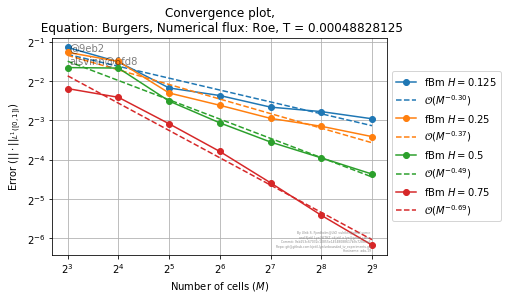

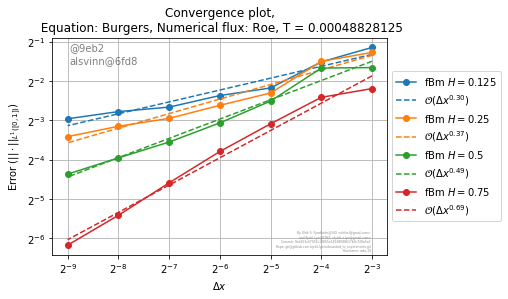

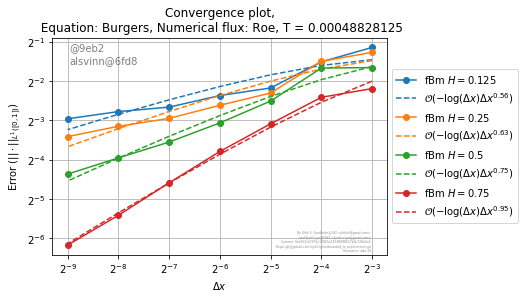

2019-04-25 10:39:03.445926 (in run_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml cubic rusanov 0.00048828125
2019-04-25 10:39:28.017297 (in run_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml cubic rusanov 0.00048828125
2019-04-25 10:39:53.003504 (in run_convergence): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml cubic rusanov 0.00048828125
2019-04-25 10:40:17.556936 (in run_convergence): Done configuration ../configs/fractional_brownian_0_75/fractional_brownian.xml cubic rusanov 0.00048828125


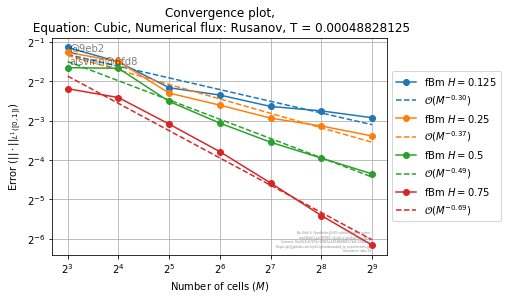

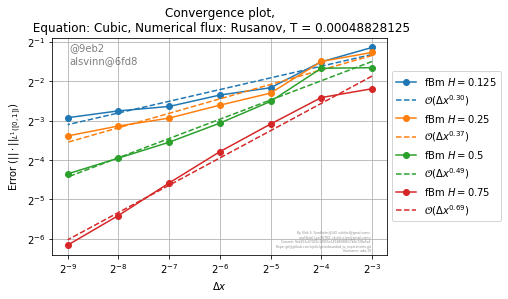

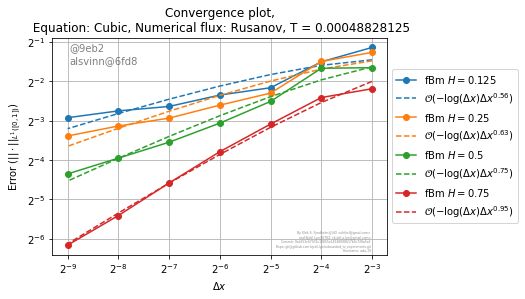

2019-04-25 10:40:55.390575 (in run_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml cubic roe 0.00048828125
2019-04-25 10:41:19.445290 (in run_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml cubic roe 0.00048828125
2019-04-25 10:41:44.560026 (in run_convergence): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml cubic roe 0.00048828125
2019-04-25 10:42:10.018871 (in run_convergence): Done configuration ../configs/fractional_brownian_0_75/fractional_brownian.xml cubic roe 0.00048828125


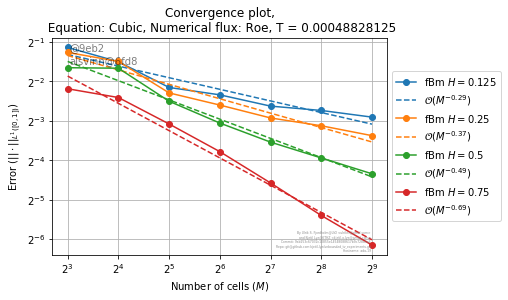

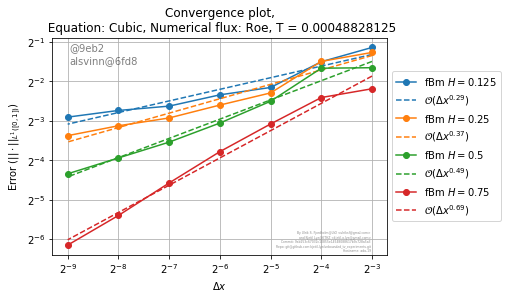

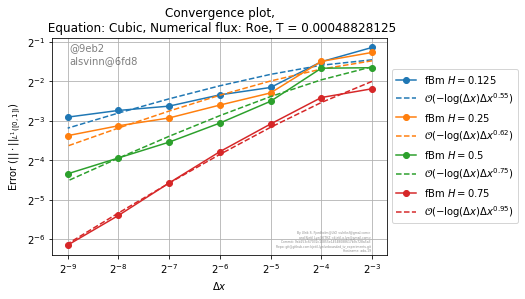

2019-04-25 10:42:48.563623 (in run_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml linear rusanov 0.00048828125
2019-04-25 10:43:13.533319 (in run_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml linear rusanov 0.00048828125
2019-04-25 10:43:39.160638 (in run_convergence): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml linear rusanov 0.00048828125
2019-04-25 10:44:04.204884 (in run_convergence): Done configuration ../configs/fractional_brownian_0_75/fractional_brownian.xml linear rusanov 0.00048828125


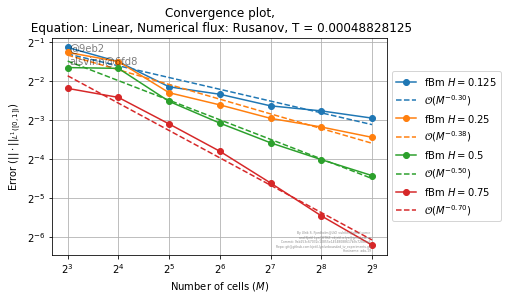

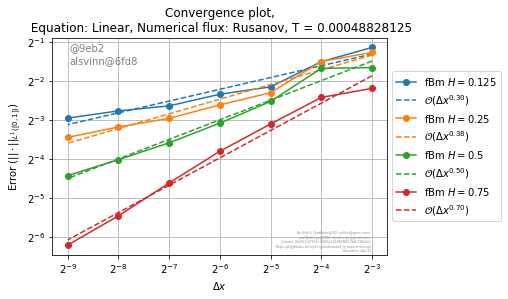

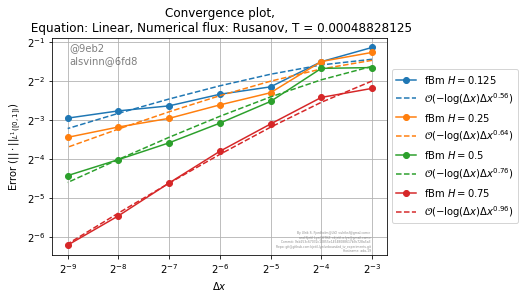

2019-04-25 10:44:42.902604 (in run_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml linear upwind 0.00048828125
2019-04-25 10:45:07.209257 (in run_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml linear upwind 0.00048828125
2019-04-25 10:46:01.017929 (in run_convergence): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml linear upwind 0.00048828125
2019-04-25 10:46:26.430142 (in run_convergence): Done configuration ../configs/fractional_brownian_0_75/fractional_brownian.xml linear upwind 0.00048828125


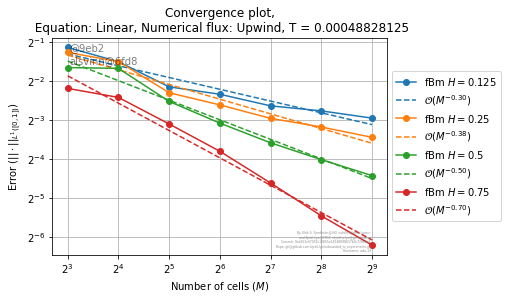

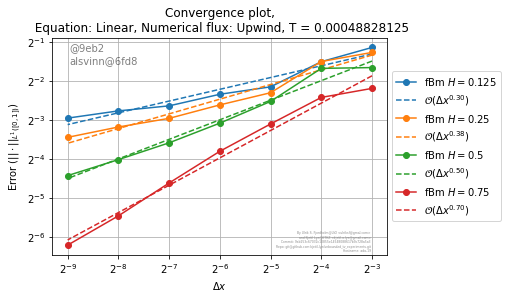

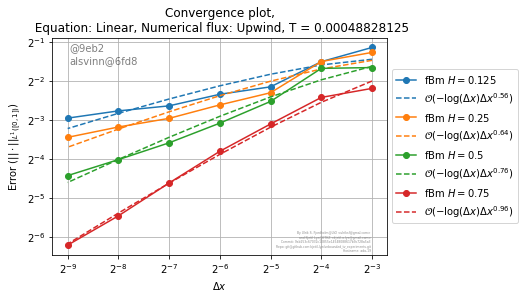

2019-04-25 10:48:04.730566 (in run_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml burgers rusanov 0.00390625
2019-04-25 10:49:33.485559 (in run_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml burgers rusanov 0.00390625
2019-04-25 10:51:06.169766 (in run_convergence): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml burgers rusanov 0.00390625
2019-04-25 10:52:39.430708 (in run_convergence): Done configuration ../configs/fractional_brownian_0_75/fractional_brownian.xml burgers rusanov 0.00390625


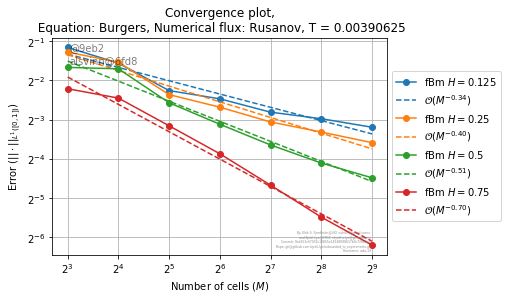

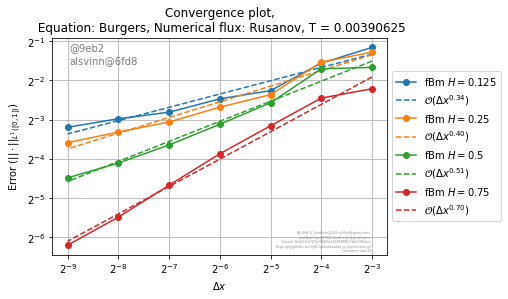

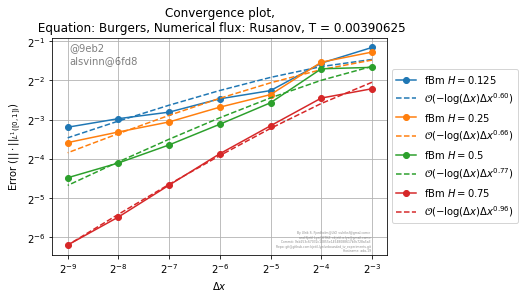

2019-04-25 10:54:20.129684 (in run_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml burgers godunov 0.00390625
2019-04-25 10:55:53.148467 (in run_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml burgers godunov 0.00390625
2019-04-25 10:57:30.238110 (in run_convergence): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml burgers godunov 0.00390625
2019-04-25 10:59:09.056393 (in run_convergence): Done configuration ../configs/fractional_brownian_0_75/fractional_brownian.xml burgers godunov 0.00390625


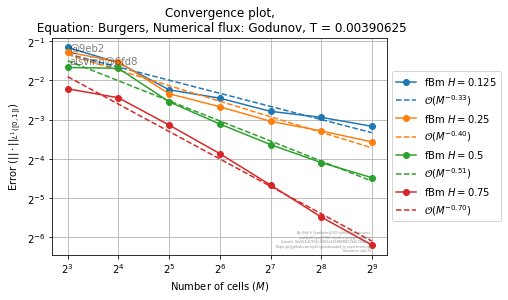

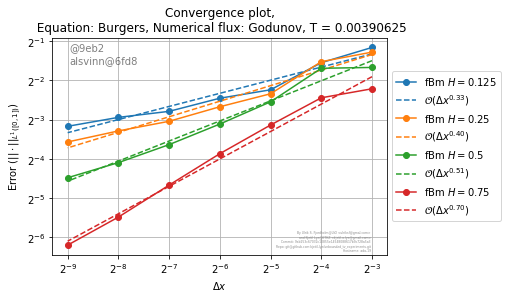

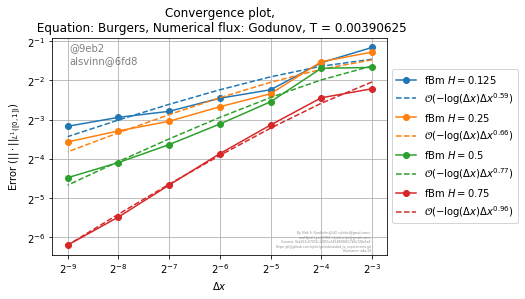

2019-04-25 11:00:53.203048 (in run_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml burgers roe 0.00390625
2019-04-25 11:02:26.587859 (in run_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml burgers roe 0.00390625
2019-04-25 11:04:04.192685 (in run_convergence): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml burgers roe 0.00390625
2019-04-25 11:05:42.260308 (in run_convergence): Done configuration ../configs/fractional_brownian_0_75/fractional_brownian.xml burgers roe 0.00390625


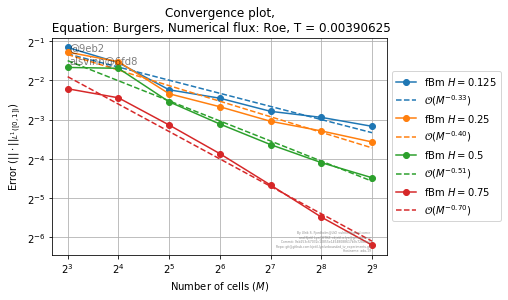

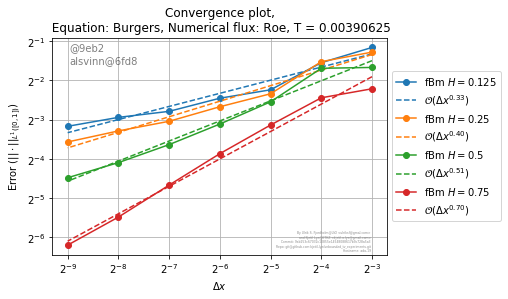

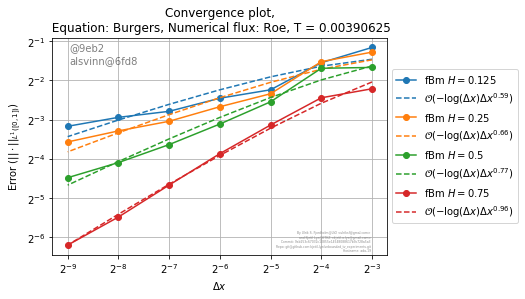

2019-04-25 11:07:15.508728 (in run_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml cubic rusanov 0.00390625
2019-04-25 11:08:43.808428 (in run_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml cubic rusanov 0.00390625
2019-04-25 11:10:21.215143 (in run_convergence): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml cubic rusanov 0.00390625
2019-04-25 11:11:58.682161 (in run_convergence): Done configuration ../configs/fractional_brownian_0_75/fractional_brownian.xml cubic rusanov 0.00390625


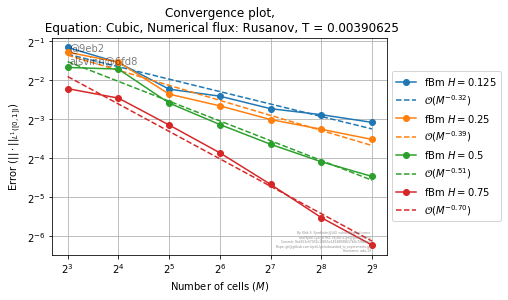

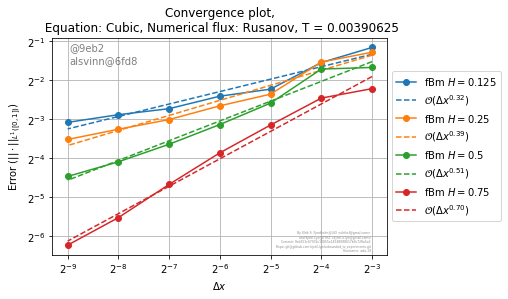

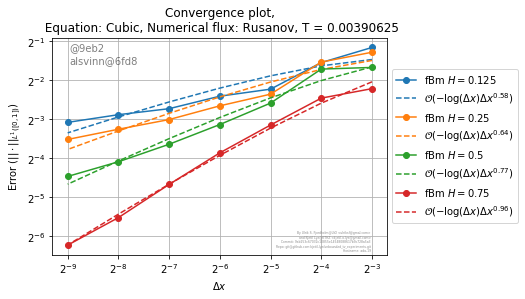

2019-04-25 11:13:31.924878 (in run_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml cubic roe 0.00390625
2019-04-25 11:15:00.050872 (in run_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml cubic roe 0.00390625
2019-04-25 11:16:36.503848 (in run_convergence): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml cubic roe 0.00390625
2019-04-25 11:18:14.289708 (in run_convergence): Done configuration ../configs/fractional_brownian_0_75/fractional_brownian.xml cubic roe 0.00390625


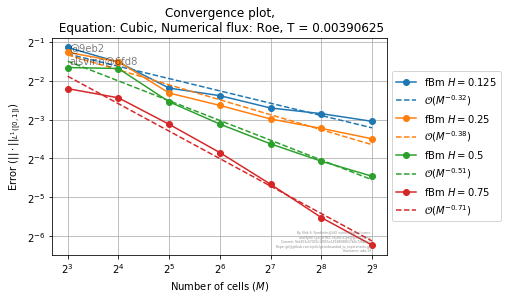

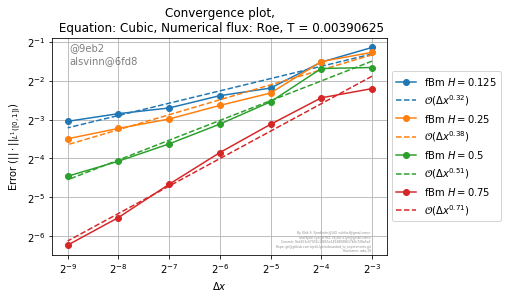

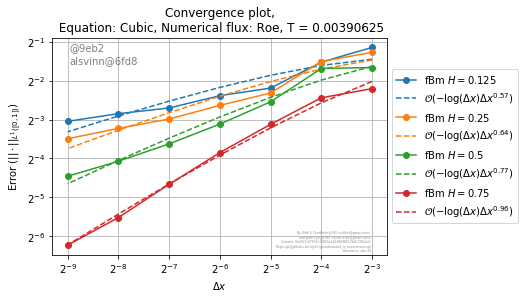

2019-04-25 11:20:06.770086 (in run_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml linear rusanov 0.00390625
2019-04-25 11:21:45.045388 (in run_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml linear rusanov 0.00390625
2019-04-25 11:23:23.648431 (in run_convergence): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml linear rusanov 0.00390625
2019-04-25 11:25:01.544241 (in run_convergence): Done configuration ../configs/fractional_brownian_0_75/fractional_brownian.xml linear rusanov 0.00390625


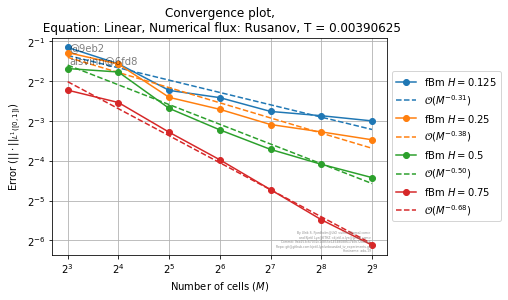

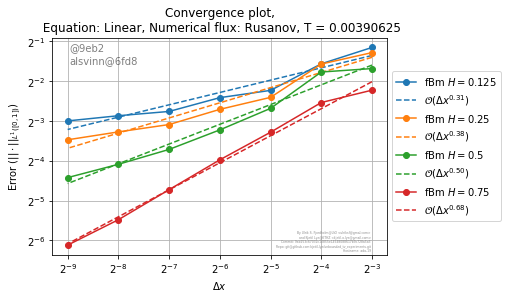

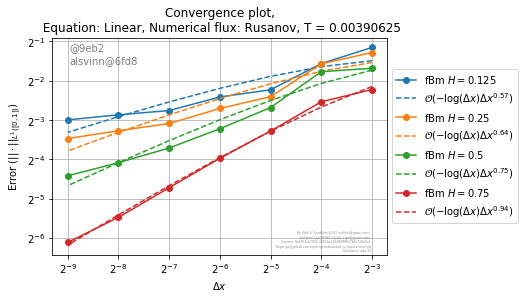

2019-04-25 11:26:53.229096 (in run_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml linear upwind 0.00390625
2019-04-25 11:28:31.272880 (in run_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml linear upwind 0.00390625
2019-04-25 11:30:08.899340 (in run_convergence): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml linear upwind 0.00390625
2019-04-25 11:31:46.470027 (in run_convergence): Done configuration ../configs/fractional_brownian_0_75/fractional_brownian.xml linear upwind 0.00390625


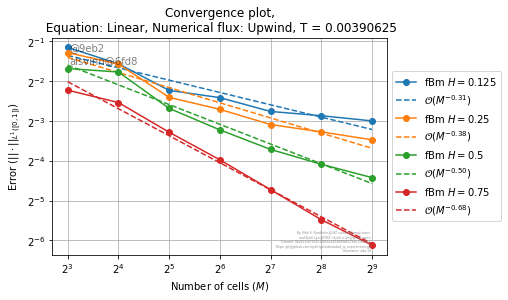

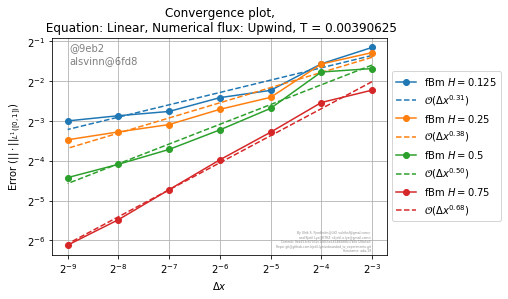

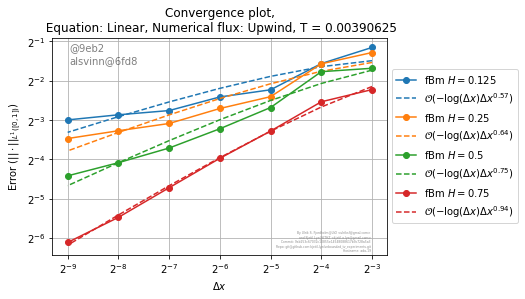

2019-04-25 12:02:50.467688 (in run_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml burgers rusanov 0.125
2019-04-25 12:37:59.981022 (in run_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml burgers rusanov 0.125
2019-04-25 13:18:40.592393 (in run_convergence): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml burgers rusanov 0.125
2019-04-25 14:01:28.588570 (in run_convergence): Done configuration ../configs/fractional_brownian_0_75/fractional_brownian.xml burgers rusanov 0.125


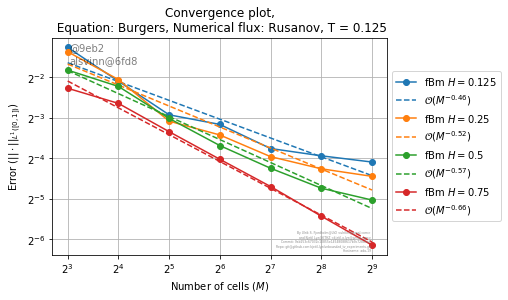

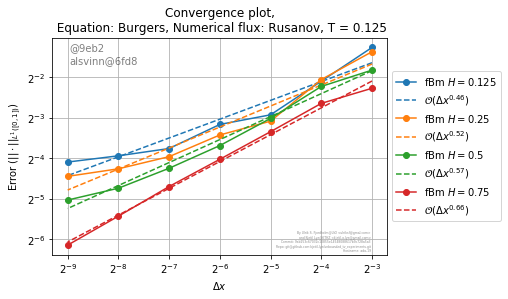

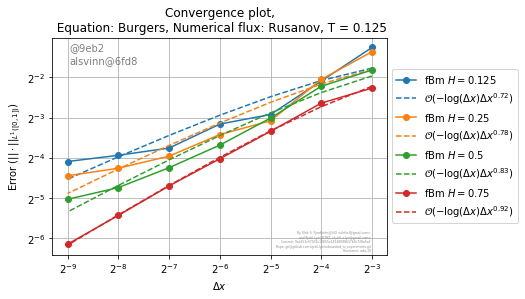

2019-04-25 14:30:24.002088 (in run_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml burgers godunov 0.125
2019-04-25 15:05:28.728434 (in run_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml burgers godunov 0.125
2019-04-25 15:49:10.710930 (in run_convergence): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml burgers godunov 0.125
2019-04-25 16:35:39.096258 (in run_convergence): Done configuration ../configs/fractional_brownian_0_75/fractional_brownian.xml burgers godunov 0.125


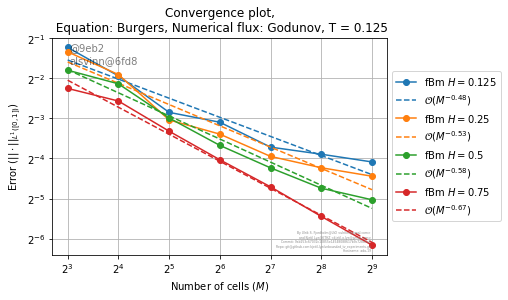

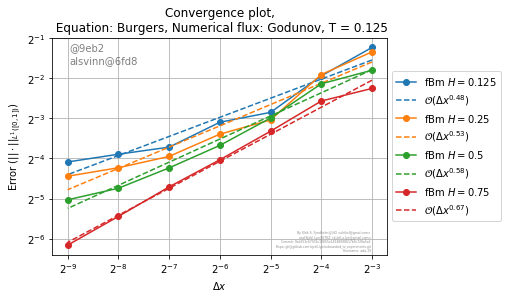

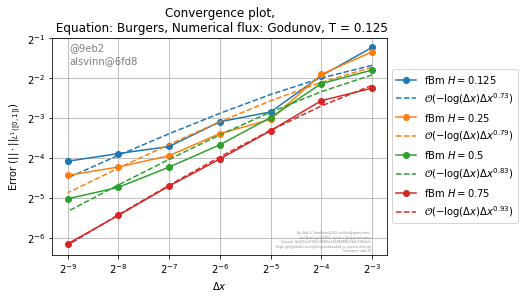

2019-04-25 17:06:01.860049 (in run_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml burgers roe 0.125
2019-04-25 17:41:50.112560 (in run_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml burgers roe 0.125
2019-04-25 18:24:47.558068 (in run_convergence): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml burgers roe 0.125
2019-04-25 19:09:32.753639 (in run_convergence): Done configuration ../configs/fractional_brownian_0_75/fractional_brownian.xml burgers roe 0.125


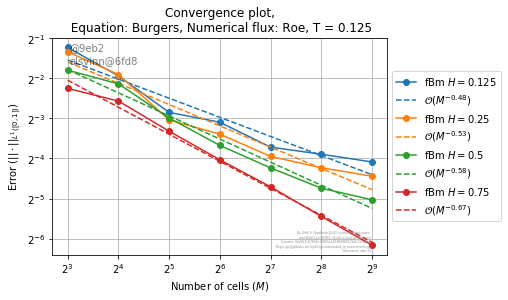

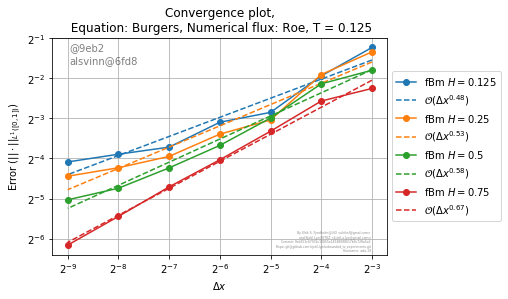

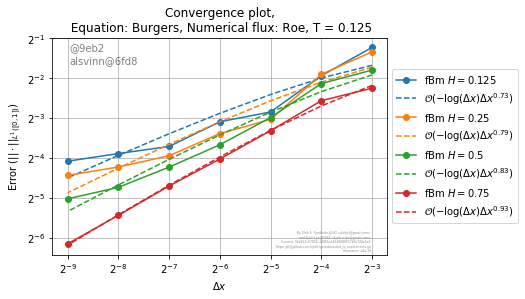

2019-04-25 19:31:08.904447 (in run_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml cubic rusanov 0.125
2019-04-25 19:58:36.452450 (in run_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml cubic rusanov 0.125
2019-04-25 20:35:59.772682 (in run_convergence): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml cubic rusanov 0.125
2019-04-25 21:17:47.444841 (in run_convergence): Done configuration ../configs/fractional_brownian_0_75/fractional_brownian.xml cubic rusanov 0.125


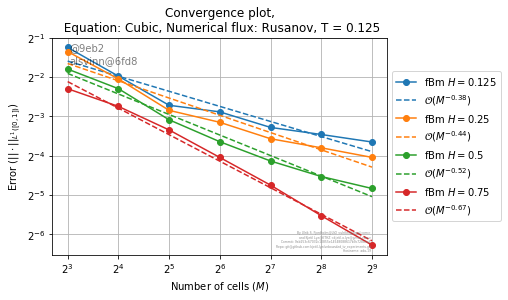

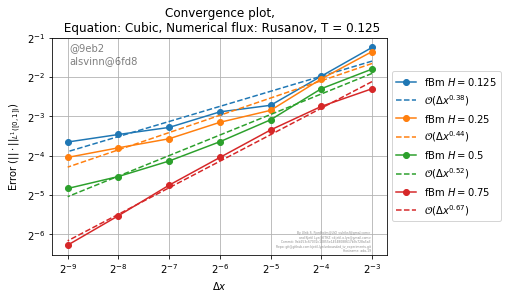

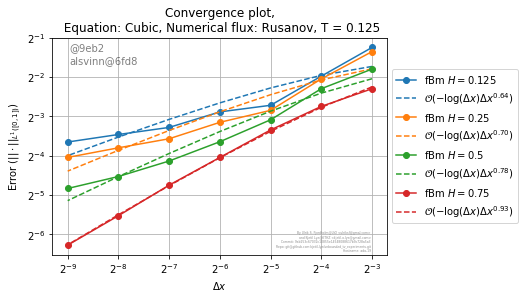

2019-04-25 21:39:24.821076 (in run_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml cubic roe 0.125
2019-04-25 21:52:31.693460 (in run_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml cubic roe 0.125
2019-04-25 21:53:13.831261 (in run_convergence): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml cubic roe 0.125
2019-04-25 21:54:00.062672 (in run_convergence): Done configuration ../configs/fractional_brownian_0_75/fractional_brownian.xml cubic roe 0.125


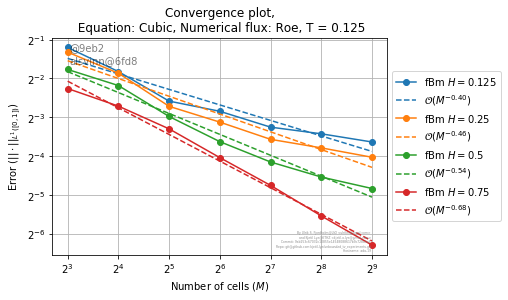

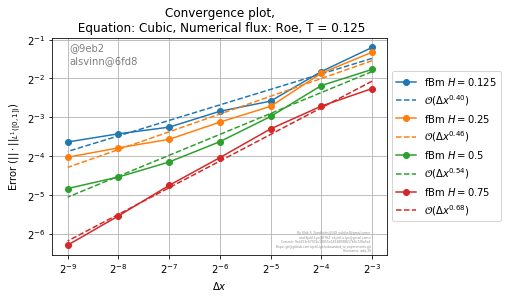

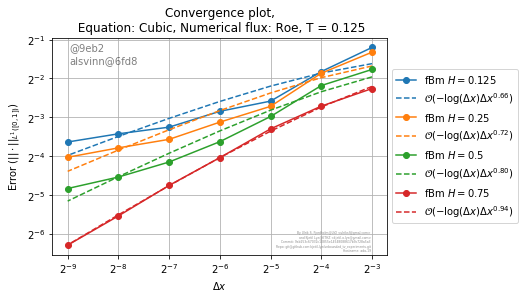

2019-04-25 21:54:51.940841 (in run_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml linear rusanov 0.125
2019-04-25 21:55:34.572961 (in run_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml linear rusanov 0.125
2019-04-25 21:56:13.022787 (in run_convergence): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml linear rusanov 0.125
2019-04-25 21:56:50.898051 (in run_convergence): Done configuration ../configs/fractional_brownian_0_75/fractional_brownian.xml linear rusanov 0.125


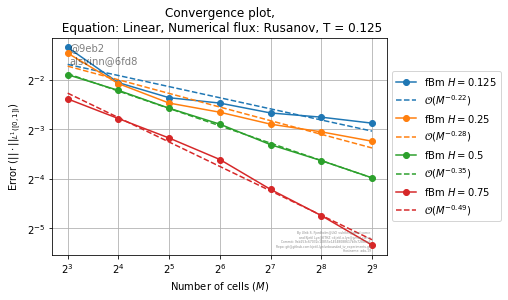

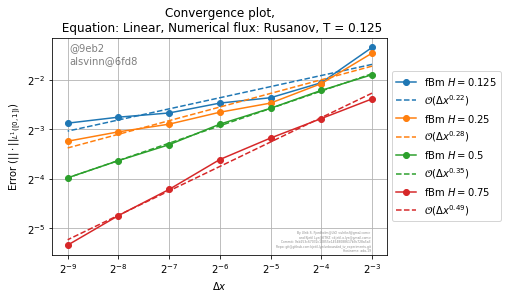

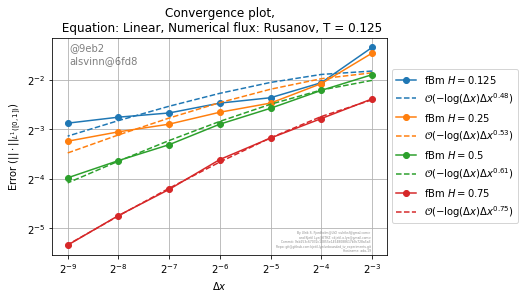

2019-04-25 21:57:43.818308 (in run_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml linear upwind 0.125
2019-04-25 21:58:21.307840 (in run_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml linear upwind 0.125
2019-04-25 21:59:00.566766 (in run_convergence): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml linear upwind 0.125
2019-04-25 21:59:45.236889 (in run_convergence): Done configuration ../configs/fractional_brownian_0_75/fractional_brownian.xml linear upwind 0.125


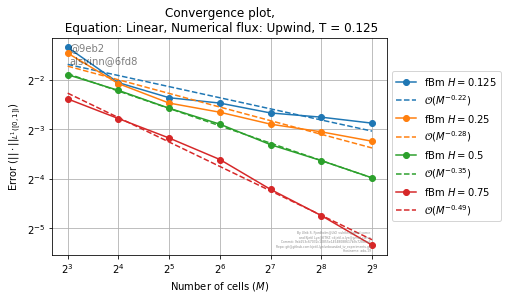

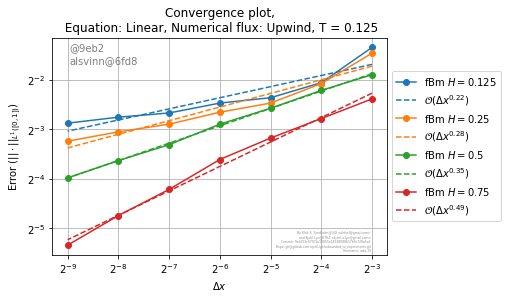

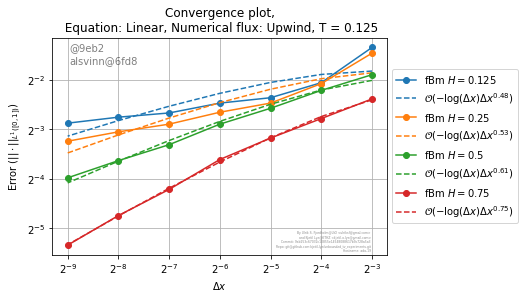

2019-04-25 22:00:52.608821 (in run_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml burgers rusanov 0.25
2019-04-25 22:01:52.088837 (in run_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml burgers rusanov 0.25
2019-04-25 22:03:02.260003 (in run_convergence): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml burgers rusanov 0.25
2019-04-25 22:04:20.920874 (in run_convergence): Done configuration ../configs/fractional_brownian_0_75/fractional_brownian.xml burgers rusanov 0.25


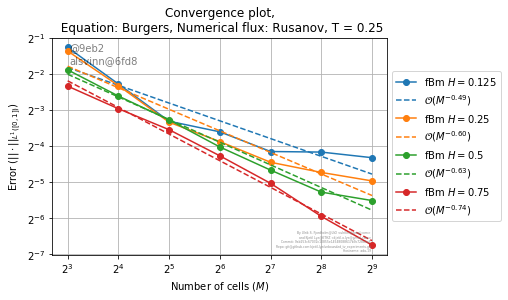

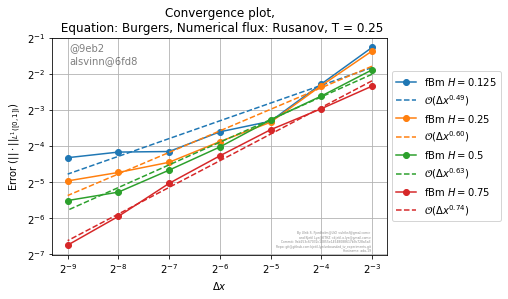

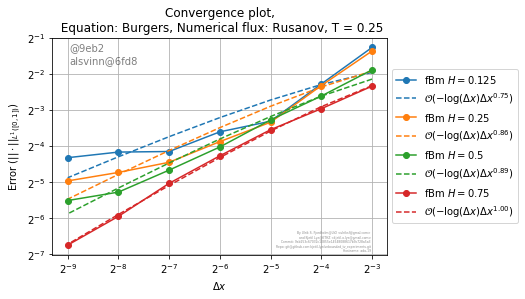

2019-04-25 22:05:29.624205 (in run_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml burgers godunov 0.25
2019-04-25 22:06:33.442110 (in run_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml burgers godunov 0.25
2019-04-25 22:07:53.379344 (in run_convergence): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml burgers godunov 0.25
2019-04-25 22:09:20.827283 (in run_convergence): Done configuration ../configs/fractional_brownian_0_75/fractional_brownian.xml burgers godunov 0.25


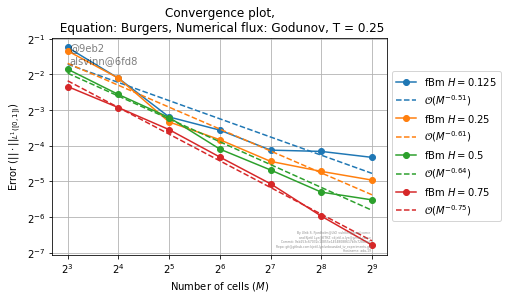

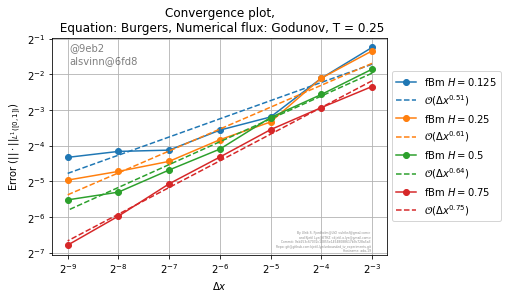

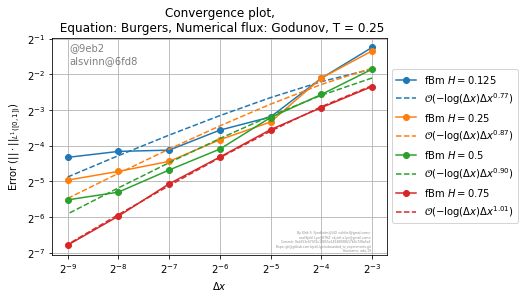

2019-04-25 22:10:28.791507 (in run_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml burgers roe 0.25
2019-04-25 22:11:30.236499 (in run_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml burgers roe 0.25
2019-04-25 22:12:43.103193 (in run_convergence): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml burgers roe 0.25
2019-04-25 22:14:07.856659 (in run_convergence): Done configuration ../configs/fractional_brownian_0_75/fractional_brownian.xml burgers roe 0.25


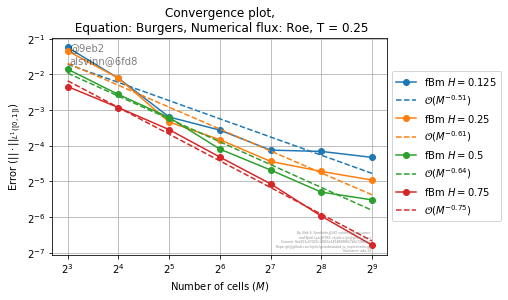

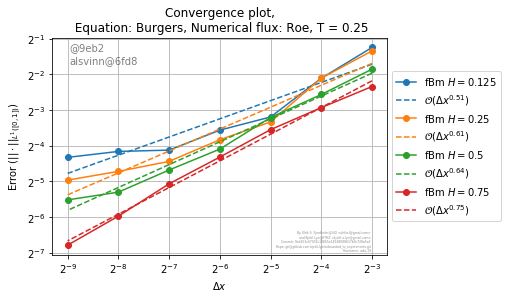

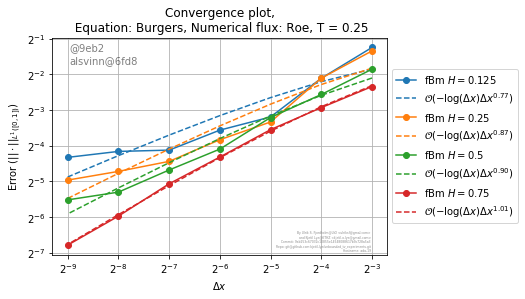

2019-04-25 22:14:58.243238 (in run_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml cubic rusanov 0.25
2019-04-25 22:15:48.153250 (in run_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml cubic rusanov 0.25
2019-04-25 22:16:56.594454 (in run_convergence): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml cubic rusanov 0.25
2019-04-25 22:18:14.593948 (in run_convergence): Done configuration ../configs/fractional_brownian_0_75/fractional_brownian.xml cubic rusanov 0.25


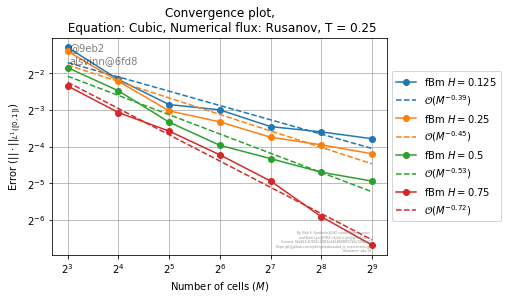

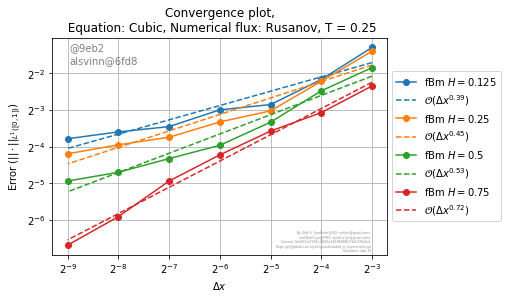

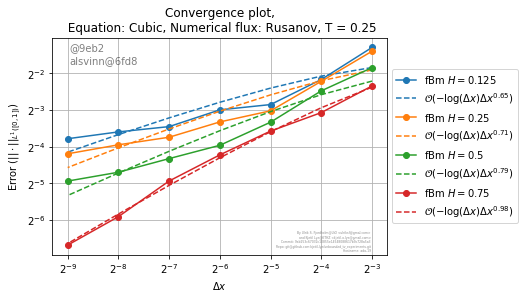

2019-04-25 22:19:07.936093 (in run_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml cubic roe 0.25
2019-04-25 22:20:01.249861 (in run_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml cubic roe 0.25
2019-04-25 22:21:14.586206 (in run_convergence): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml cubic roe 0.25
2019-04-25 22:22:35.240438 (in run_convergence): Done configuration ../configs/fractional_brownian_0_75/fractional_brownian.xml cubic roe 0.25


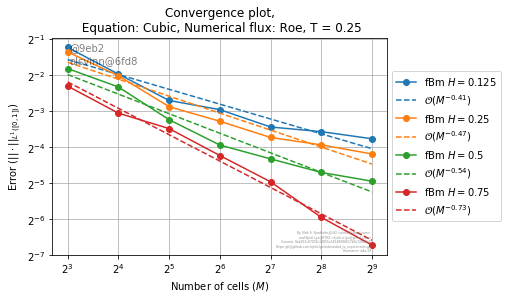

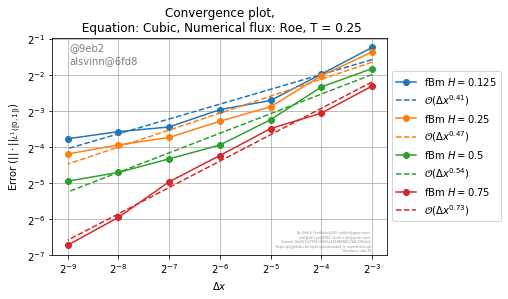

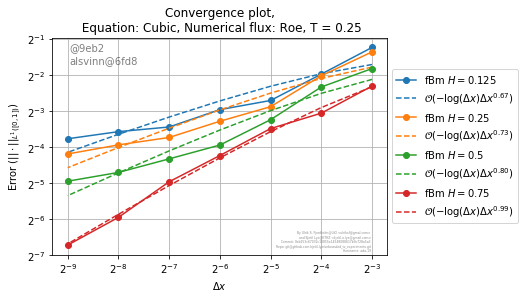

2019-04-25 22:23:58.073669 (in run_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml linear rusanov 0.25
2019-04-25 22:25:08.468957 (in run_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml linear rusanov 0.25
2019-04-25 22:26:17.102885 (in run_convergence): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml linear rusanov 0.25
2019-04-25 22:27:22.956308 (in run_convergence): Done configuration ../configs/fractional_brownian_0_75/fractional_brownian.xml linear rusanov 0.25


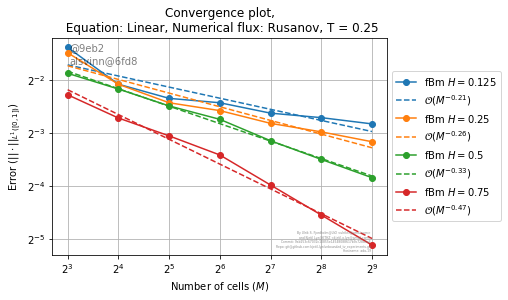

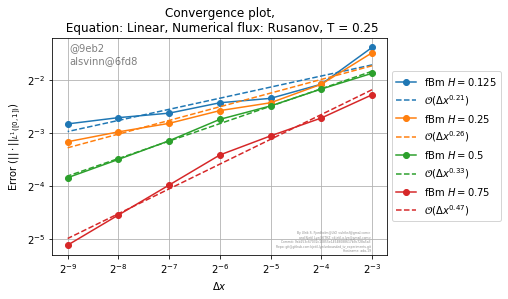

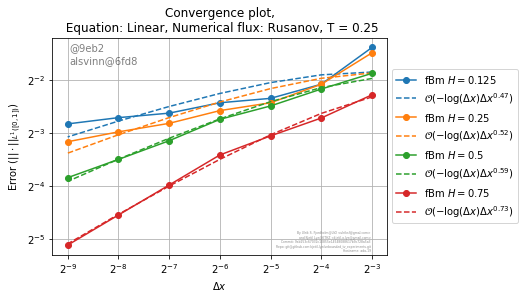

2019-04-25 22:28:43.044750 (in run_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml linear upwind 0.25
2019-04-25 22:29:54.665622 (in run_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml linear upwind 0.25
2019-04-25 22:31:03.159242 (in run_convergence): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml linear upwind 0.25
2019-04-25 22:32:09.723883 (in run_convergence): Done configuration ../configs/fractional_brownian_0_75/fractional_brownian.xml linear upwind 0.25


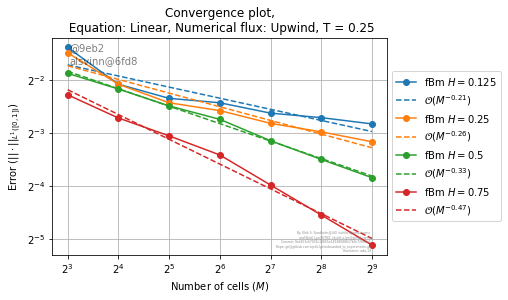

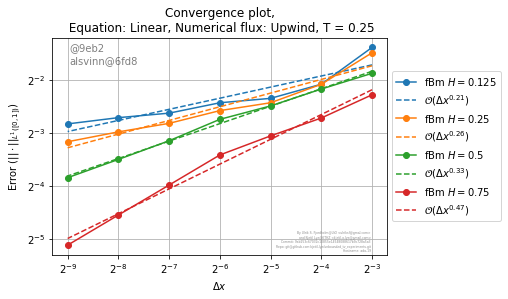

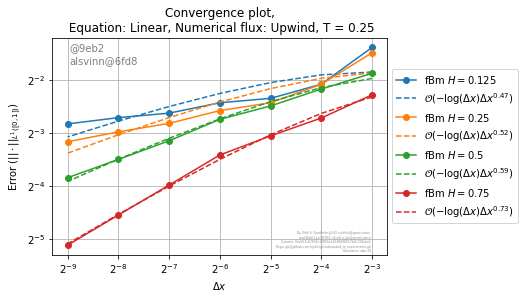

2019-04-25 22:34:40.315962 (in run_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml burgers rusanov 1
2019-04-25 22:37:24.044214 (in run_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml burgers rusanov 1
2019-04-25 22:41:23.977458 (in run_convergence): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml burgers rusanov 1
2019-04-25 22:45:37.362739 (in run_convergence): Done configuration ../configs/fractional_brownian_0_75/fractional_brownian.xml burgers rusanov 1


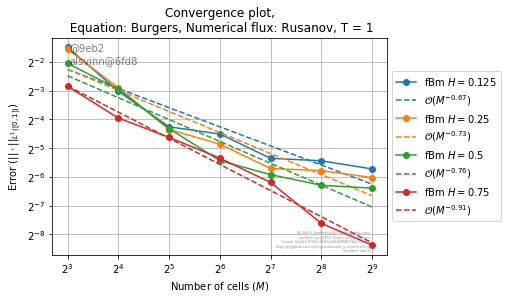

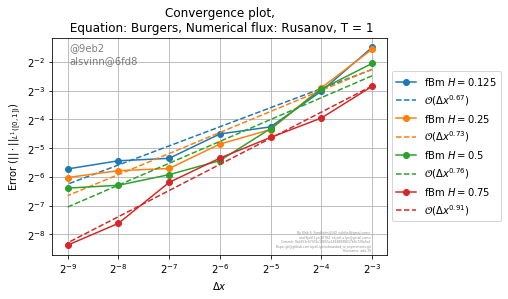

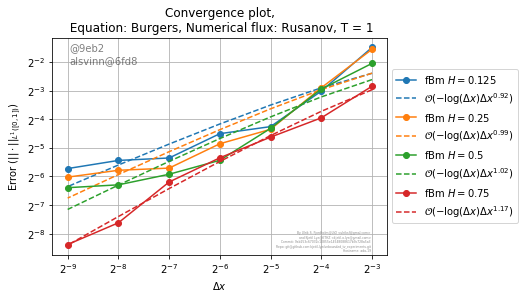

2019-04-25 22:48:18.804255 (in run_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml burgers godunov 1
2019-04-25 22:51:33.594054 (in run_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml burgers godunov 1
2019-04-25 22:55:54.929465 (in run_convergence): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml burgers godunov 1
2019-04-25 23:00:44.900647 (in run_convergence): Done configuration ../configs/fractional_brownian_0_75/fractional_brownian.xml burgers godunov 1


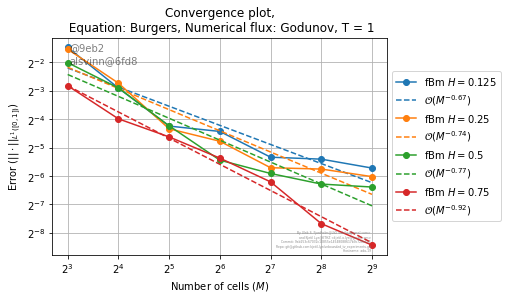

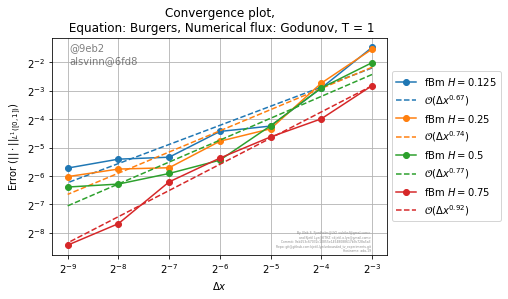

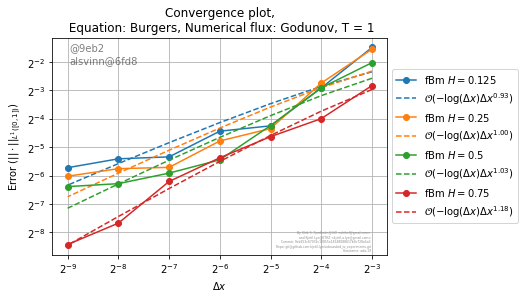

2019-04-25 23:03:10.815226 (in run_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml burgers roe 1
2019-04-25 23:06:03.925822 (in run_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml burgers roe 1
2019-04-25 23:09:55.476854 (in run_convergence): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml burgers roe 1
2019-04-25 23:14:13.182074 (in run_convergence): Done configuration ../configs/fractional_brownian_0_75/fractional_brownian.xml burgers roe 1


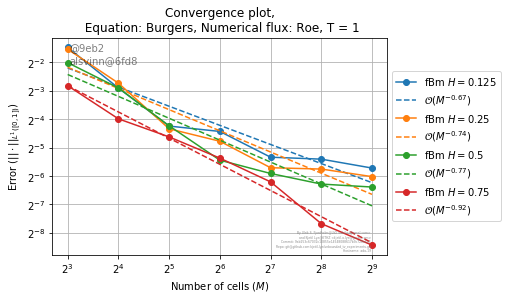

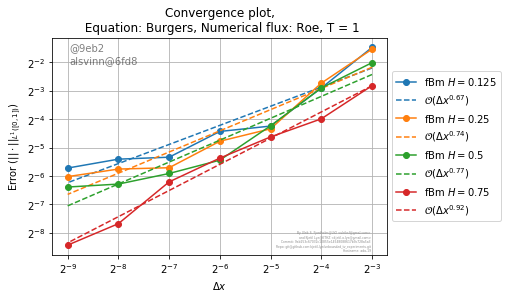

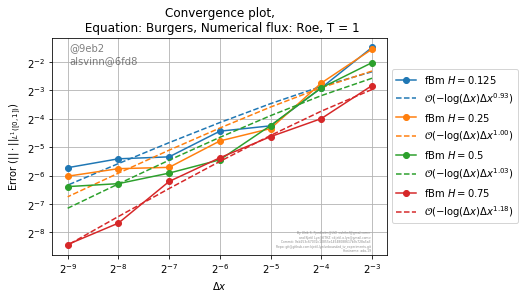

2019-04-25 23:16:01.175740 (in run_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml cubic rusanov 1
2019-04-25 23:18:04.077493 (in run_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml cubic rusanov 1
2019-04-25 23:21:18.192263 (in run_convergence): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml cubic rusanov 1
2019-04-25 23:25:10.269459 (in run_convergence): Done configuration ../configs/fractional_brownian_0_75/fractional_brownian.xml cubic rusanov 1


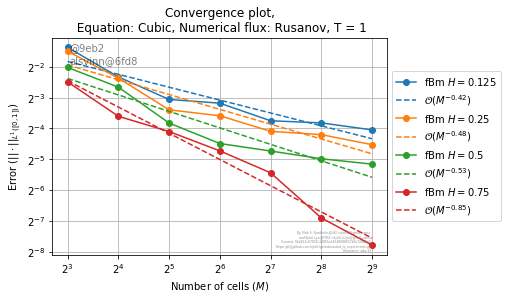

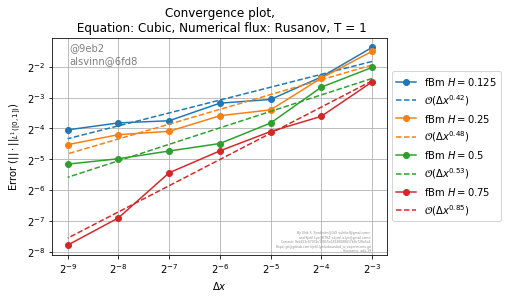

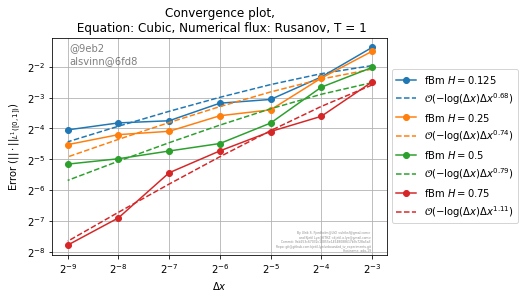

2019-04-25 23:26:50.462451 (in run_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml cubic roe 1
2019-04-25 23:28:57.197944 (in run_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml cubic roe 1
2019-04-25 23:32:15.241526 (in run_convergence): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml cubic roe 1
2019-04-25 23:36:18.940602 (in run_convergence): Done configuration ../configs/fractional_brownian_0_75/fractional_brownian.xml cubic roe 1


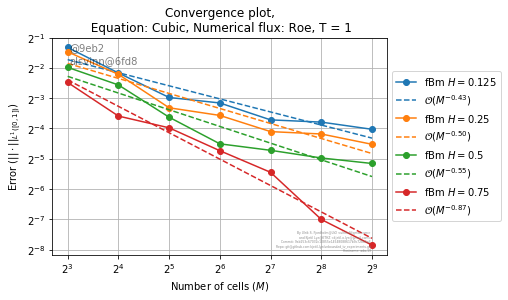

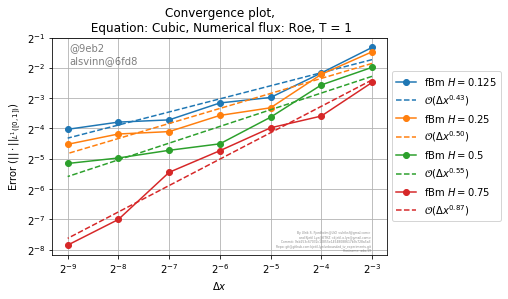

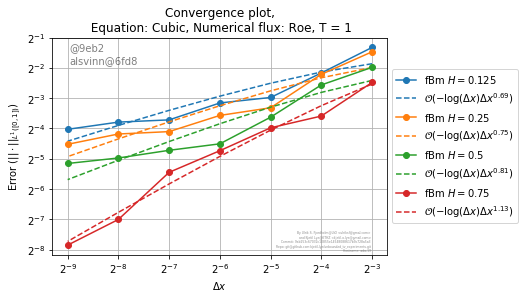

2019-04-25 23:40:46.221909 (in run_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml linear rusanov 1
2019-04-25 23:44:50.205094 (in run_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml linear rusanov 1
2019-04-25 23:48:54.317935 (in run_convergence): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml linear rusanov 1
2019-04-25 23:53:01.955607 (in run_convergence): Done configuration ../configs/fractional_brownian_0_75/fractional_brownian.xml linear rusanov 1


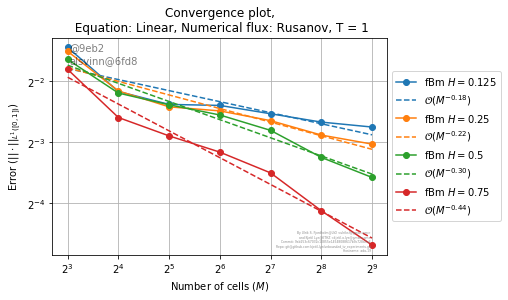

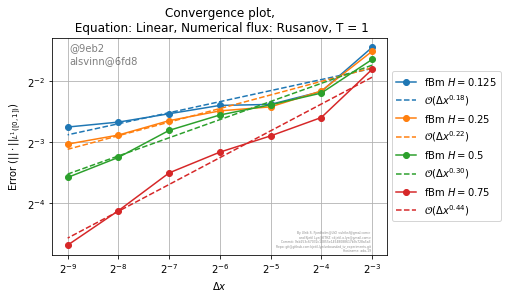

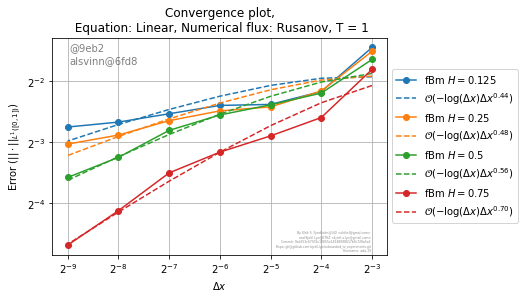

2019-04-25 23:57:15.117334 (in run_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml linear upwind 1
2019-04-26 00:01:18.370979 (in run_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml linear upwind 1
2019-04-26 00:05:17.910706 (in run_convergence): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml linear upwind 1
2019-04-26 00:09:10.991494 (in run_convergence): Done configuration ../configs/fractional_brownian_0_75/fractional_brownian.xml linear upwind 1


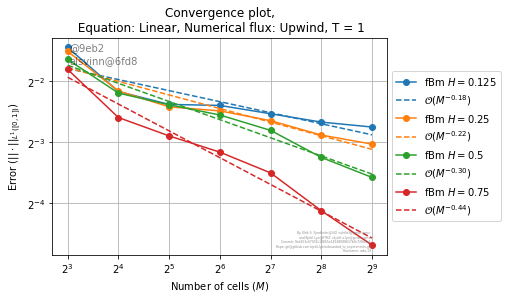

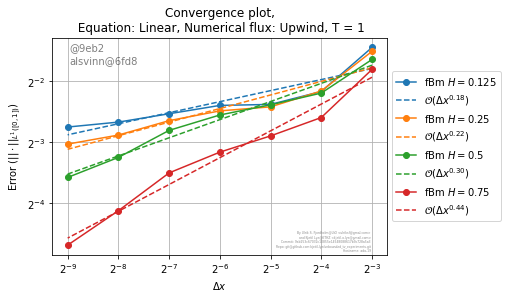

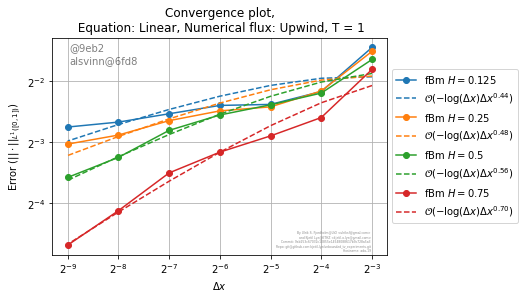

In [6]:
def run_fbm_convergence(equation, numerical_flux, exact_solution, T):
    Hs = [0.125, 0.25, 0.5, 0.75]

    base_xml_format_string = '../configs/fractional_brownian_{H_filename}/fractional_brownian.xml'

   
    for H in Hs:
        base_xml = base_xml_format_string.format(H_filename = str(H).replace(".","_"))
        
        name = "fBm $H={H}$".format(H=H)
        run_convergence(base_xml, name, T, numerical_flux=numerical_flux,
                   equation=equation, exact_solution_class=exact_solution)
        
    plt.figure(0)
    plt.title("Convergence plot,\n Equation: {equation}, Numerical flux: {numerical_flux}, T = {T}"\
              .format(equation=equation.capitalize(), numerical_flux=numerical_flux.capitalize(), T=T))
    
    
    plot_info.legendLeft()
    plot_info.savePlot("fbm_convergence_M_{equation}_{numerical_flux}_{T}"
                .format(equation=equation, numerical_flux=numerical_flux, 
                        T=str(T).replace(".", "_")))
    
    
    plt.figure(1)
    plt.title("Convergence plot,\n Equation: {equation}, Numerical flux: {numerical_flux}, T = {T}"\
              .format(equation=equation.capitalize(), numerical_flux=numerical_flux.capitalize(), T=T))
    
    
    plot_info.legendLeft()
    plot_info.savePlot("fbm_convergence_dx_{equation}_{numerical_flux}_{T}"
                .format(equation=equation, numerical_flux=numerical_flux, 
                        T=str(T).replace(".", "_")))
    
    
    plt.figure(2)
    plt.title("Convergence plot,\n Equation: {equation}, Numerical flux: {numerical_flux}, T = {T}"\
              .format(equation=equation.capitalize(), numerical_flux=numerical_flux.capitalize(), T=T))
    
    
    plot_info.legendLeft()
    plot_info.savePlot("fbm_convergence_log_dx_{equation}_{numerical_flux}_{T}"
                .format(equation=equation, numerical_flux=numerical_flux, 
                        T=str(T).replace(".", "_")))
    
    plt.show()
    
for T in [1/2048., 1/256., 1/8, 1.0/4, 1]:
    run_all_configurations(run_fbm_convergence, T)
                                             

# TV over time

In [7]:
def TV_versus_time(base_xml, title, T, 
                    exact_solution_class=None,
                    numerical_flux="rusanov",
                    equation="burgers"):
    plot_info.console_log_show("Running TV versus time for {}, T={}".format(base_xml, T))
    N = 128
    M = COMPUTATIONAL_BUDGET//N
    
    run = alsvinn.run(name="TV_solution",
        base_xml=base_xml,
        number_of_saves=N,
        dimension=[M,1,1],
        flux=numerical_flux,
        equation=equation,
        uq=True, # notice that since we have Brownian initial data, we need to enable uq
        T=T)
    
    TVs = []
    Ts = np.linspace(0,T,N)
    for t_index in range(N):
        u = run.get_data("u", t_index)
        
        tv_u = np.sum(abs(np.diff(u)))
        TVs.append(tv_u)
    TVs = np.array(TVs)
    
    poly = np.polyfit(Ts[1:], 1.0/TVs[1:], 1)
    
    print(poly)
    
    line_info = plt.plot(Ts, 1.0/TVs, label=title)
    
    plt.plot(Ts[1:], poly[0]*Ts[1:]+poly[1],
             '--',
             color=line_info[0].get_color(),
             label='$%.3f t %+.3f$' % (poly[0], poly[1]))
    plt.title("T = {}".format(T))
    plot_info.legendLeft()
    plt.xlabel("$t$")
    plt.ylabel("$\\left(\\mathrm{TV}(u(\\cdot, t)\\right)^{-1}$")


2019-04-26 00:09:24.486291 (in TV_versus_time): Running TV versus time for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.5
[0.5317174  0.04750267]
2019-04-26 00:09:26.599765 (in TV_versus_time): Running TV versus time for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.5
[0.52508787 0.05626253]
2019-04-26 00:09:28.688314 (in TV_versus_time): Running TV versus time for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.5
[0.52954391 0.07162543]
2019-04-26 00:09:30.892307 (in TV_versus_time): Running TV versus time for ../configs/fractional_brownian_0_75/fractional_brownian.xml, T=0.5
[0.4849991  0.12516299]


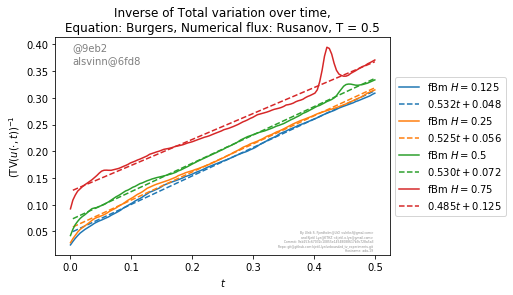

2019-04-26 00:09:36.317974 (in TV_versus_time): Running TV versus time for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.5
[0.53477936 0.03923629]
2019-04-26 00:09:38.369369 (in TV_versus_time): Running TV versus time for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.5
[0.52621512 0.0501209 ]
2019-04-26 00:09:40.455925 (in TV_versus_time): Running TV versus time for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.5
[0.52684658 0.06910439]
2019-04-26 00:09:42.517737 (in TV_versus_time): Running TV versus time for ../configs/fractional_brownian_0_75/fractional_brownian.xml, T=0.5
[0.4851465  0.12382707]


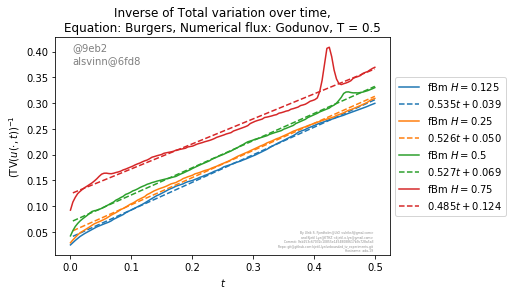

2019-04-26 00:09:49.874945 (in TV_versus_time): Running TV versus time for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.5
[0.53477936 0.03923629]
2019-04-26 00:09:52.057190 (in TV_versus_time): Running TV versus time for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.5
[0.52621512 0.0501209 ]
2019-04-26 00:09:54.117426 (in TV_versus_time): Running TV versus time for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.5
[0.52684658 0.06910439]
2019-04-26 00:09:56.275577 (in TV_versus_time): Running TV versus time for ../configs/fractional_brownian_0_75/fractional_brownian.xml, T=0.5
[0.4851465  0.12382707]


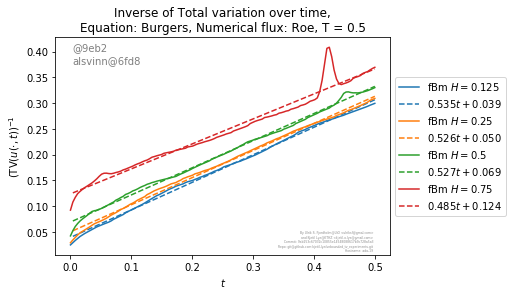

2019-04-26 00:10:01.569957 (in TV_versus_time): Running TV versus time for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.5
[0.17483047 0.03947706]
2019-04-26 00:10:04.183716 (in TV_versus_time): Running TV versus time for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.5
[0.20744925 0.04582369]
2019-04-26 00:10:06.212371 (in TV_versus_time): Running TV versus time for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.5
[0.31305855 0.06594906]
2019-04-26 00:10:08.267890 (in TV_versus_time): Running TV versus time for ../configs/fractional_brownian_0_75/fractional_brownian.xml, T=0.5
[0.23736651 0.1234742 ]


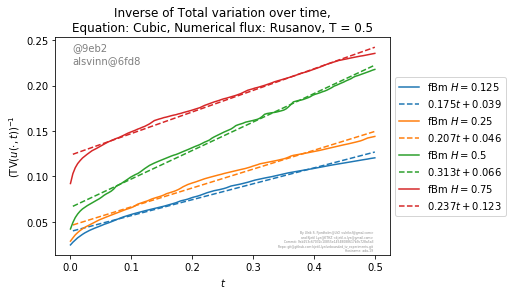

2019-04-26 00:10:13.608326 (in TV_versus_time): Running TV versus time for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.5
[0.15946599 0.03355928]
2019-04-26 00:10:15.629636 (in TV_versus_time): Running TV versus time for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.5
[0.19375848 0.0387164 ]
2019-04-26 00:10:17.660237 (in TV_versus_time): Running TV versus time for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.5
[0.31627159 0.06077256]
2019-04-26 00:10:19.733053 (in TV_versus_time): Running TV versus time for ../configs/fractional_brownian_0_75/fractional_brownian.xml, T=0.5
[0.23719707 0.12158498]


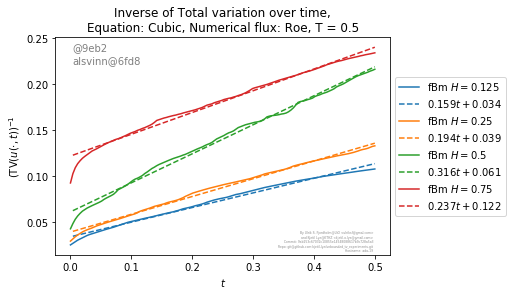

2019-04-26 00:10:24.939474 (in TV_versus_time): Running TV versus time for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.5
[0.28879507 0.10761796]
2019-04-26 00:10:27.297480 (in TV_versus_time): Running TV versus time for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.5
[0.24581601 0.10962279]
2019-04-26 00:10:29.651974 (in TV_versus_time): Running TV versus time for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.5
[0.16651945 0.11542134]
2019-04-26 00:10:32.090242 (in TV_versus_time): Running TV versus time for ../configs/fractional_brownian_0_75/fractional_brownian.xml, T=0.5
[0.13812171 0.17653523]


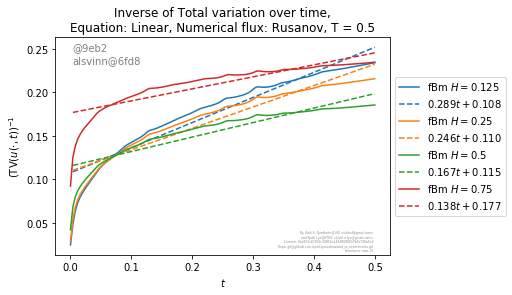

2019-04-26 00:10:37.445898 (in TV_versus_time): Running TV versus time for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.5
[0.28879507 0.10761796]
2019-04-26 00:10:39.763594 (in TV_versus_time): Running TV versus time for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.5
[0.24581601 0.10962279]
2019-04-26 00:10:42.161844 (in TV_versus_time): Running TV versus time for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.5
[0.16651945 0.11542134]
2019-04-26 00:10:44.518360 (in TV_versus_time): Running TV versus time for ../configs/fractional_brownian_0_75/fractional_brownian.xml, T=0.5
[0.13812171 0.17653523]


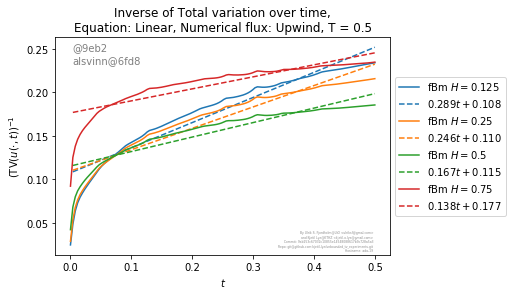

In [8]:
def run_fbm_tv(equation, numerical_flux, exact_solution, T):
    Hs = [0.125, 0.25, 0.5, 0.75]

    base_xml_format_string = '../configs/fractional_brownian_{H_filename}/fractional_brownian.xml'

   
    for H in Hs:
        base_xml = base_xml_format_string.format(H_filename = str(H).replace(".","_"))
        
        name = "fBm $H={H}$".format(H=H)
        TV_versus_time(base_xml, name, T, numerical_flux=numerical_flux,
                   equation=equation, exact_solution_class=exact_solution)
    plt.title("Inverse of Total variation over time,\nEquation: {equation}, Numerical flux: {numerical_flux}, T = {T}"\
              .format(equation=equation.capitalize(), numerical_flux=numerical_flux.capitalize(), T=T))
    
    
    plot_info.legendLeft()
    plot_info.showAndSave("fbm_tv_{equation}_{numerical_flux}_{T}"
                .format(equation=equation, numerical_flux=numerical_flux, 
                        T=str(T).replace(".", "_")))
    
T = 0.5
run_all_configurations(run_fbm_tv, T)
                                             

# Plotting solutions at single times

In [9]:
def plot_solution(base_xml, title, T, M, 
                exact_solution_class=None,
                numerical_flux="rusanov",
                equation="burgers"):
    
    plot_info.console_log_show("Running plot solution for {}, T={}, flux={}, equation={}".format(base_xml,
                                                                                                 T,
                                                                                                numerical_flux,
                                                                                                equation))

    
    run = alsvinn.run(name="TV_solution",
        base_xml=base_xml,
        number_of_saves=1,
        dimension=[M,1,1],
        flux=numerical_flux,
        equation=equation,
        uq=True, # notice that since we have Brownian initial data, we need to enable uq
        T=T)
    
    
    t_indices = [0, 1]
    ts = [0, T]
    for t_index in t_indices:
        t = ts[t_index]
        u = run.get_data("u", t_index)
        x = np.linspace(0, 1, u.shape[0])
        
        plt.figure(t_index)
        plt.plot(x, u)
        plt.xlabel("$x$")
        plt.ylabel("$u(x,{})$".format(t))
        

2019-04-26 00:10:50.033928 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.00390625, flux=rusanov, equation=burgers


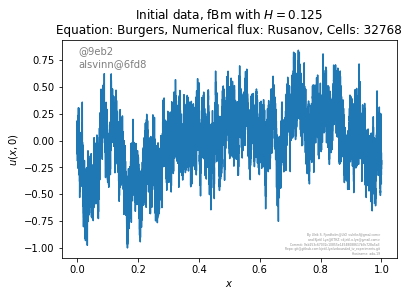

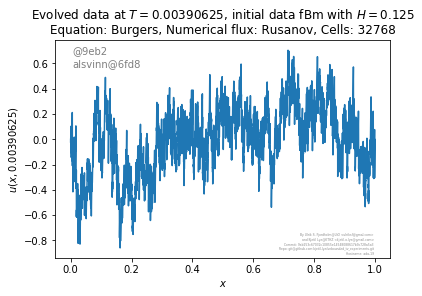

2019-04-26 00:10:59.685108 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.00390625, flux=rusanov, equation=burgers


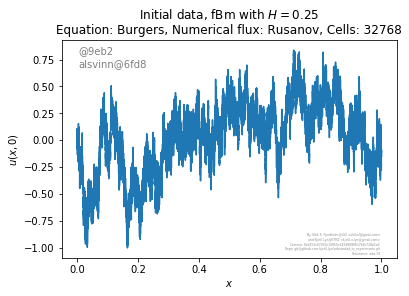

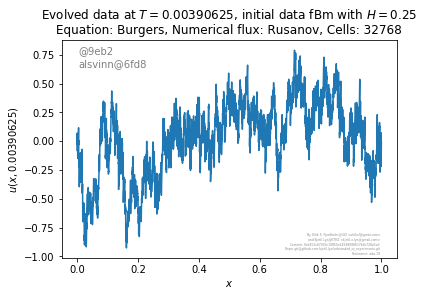

2019-04-26 00:11:09.281227 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.00390625, flux=rusanov, equation=burgers


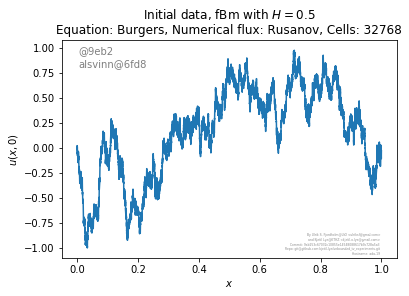

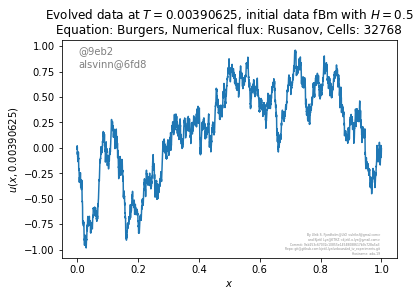

2019-04-26 00:11:18.663182 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_75/fractional_brownian.xml, T=0.00390625, flux=rusanov, equation=burgers


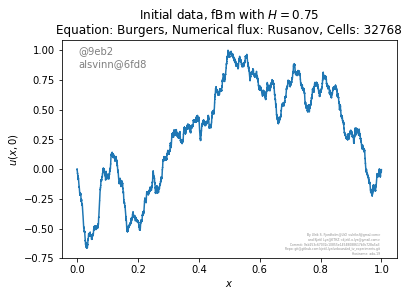

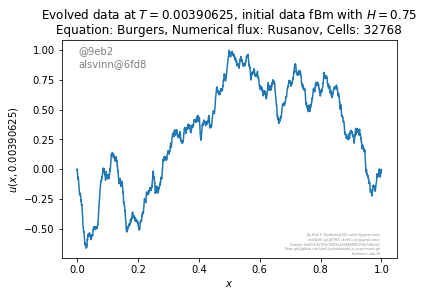

2019-04-26 00:11:27.930907 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.00390625, flux=godunov, equation=burgers


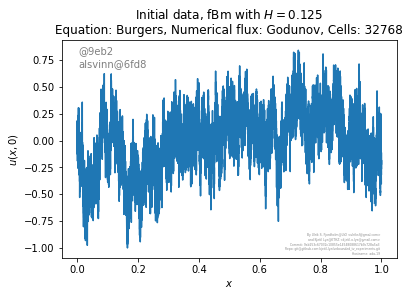

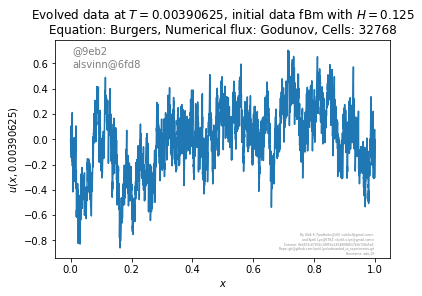

2019-04-26 00:11:38.286358 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.00390625, flux=godunov, equation=burgers


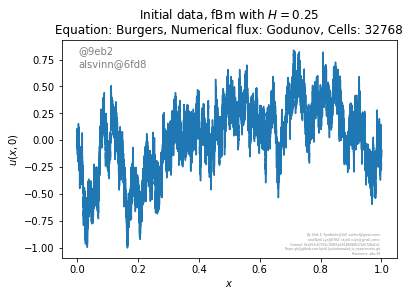

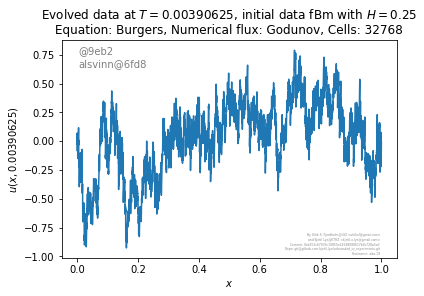

2019-04-26 00:11:49.042604 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.00390625, flux=godunov, equation=burgers


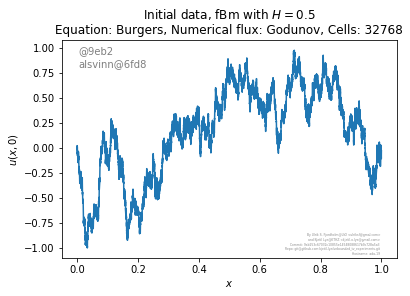

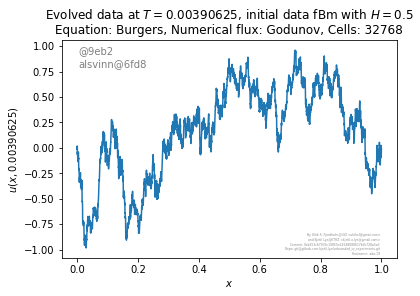

2019-04-26 00:11:59.807770 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_75/fractional_brownian.xml, T=0.00390625, flux=godunov, equation=burgers


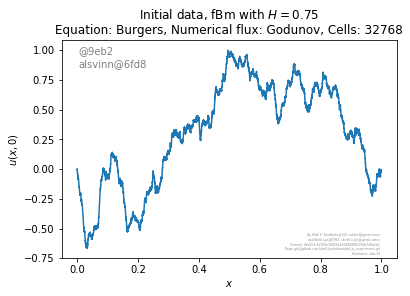

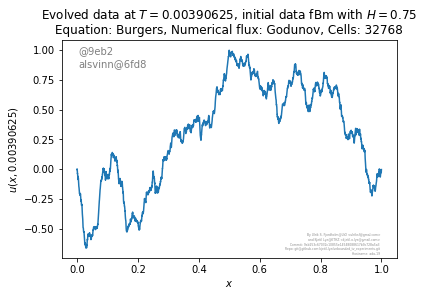

2019-04-26 00:12:12.228321 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.00390625, flux=roe, equation=burgers


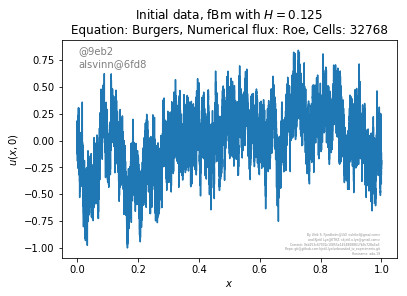

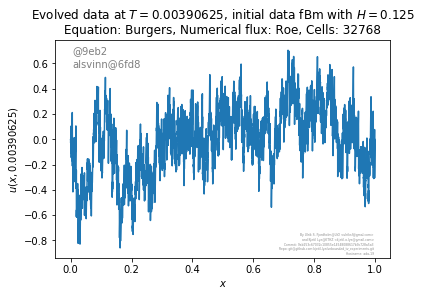

2019-04-26 00:12:55.720004 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.00390625, flux=roe, equation=burgers


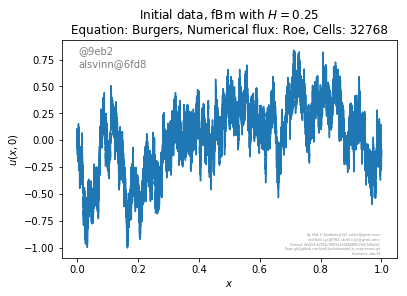

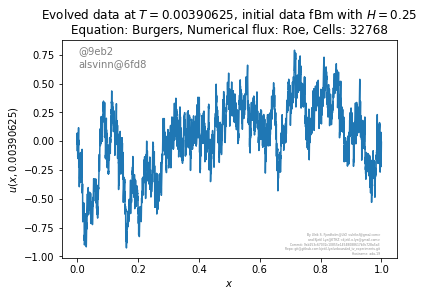

2019-04-26 00:13:05.751671 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.00390625, flux=roe, equation=burgers


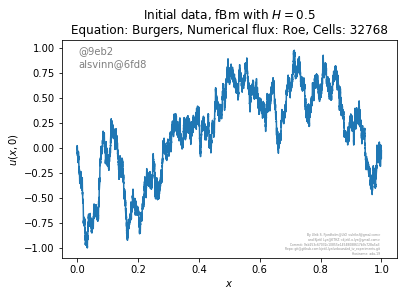

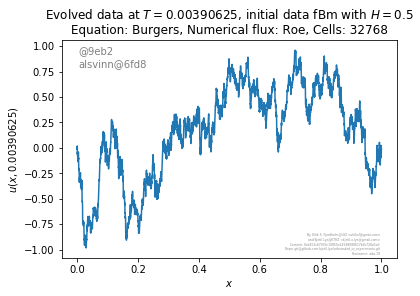

2019-04-26 00:13:15.611176 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_75/fractional_brownian.xml, T=0.00390625, flux=roe, equation=burgers


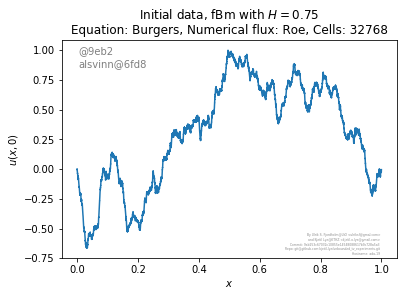

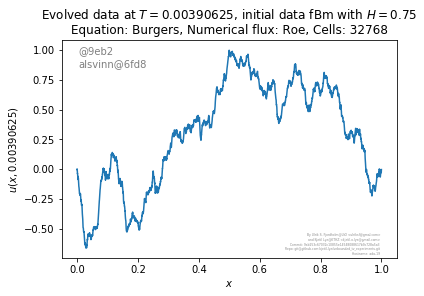

2019-04-26 00:13:29.509327 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.00390625, flux=rusanov, equation=cubic


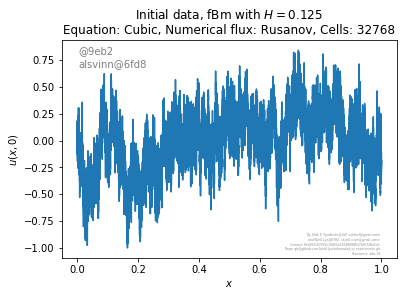

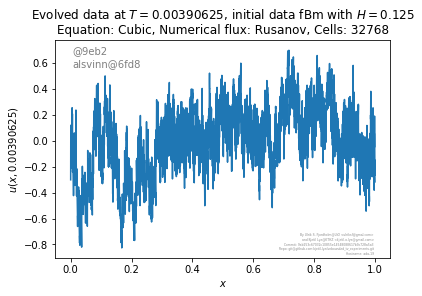

2019-04-26 00:13:39.254674 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.00390625, flux=rusanov, equation=cubic


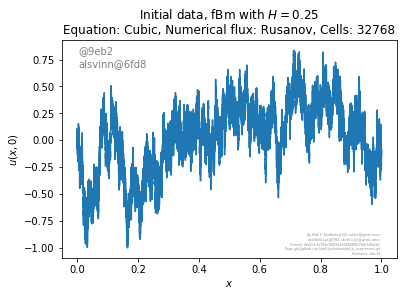

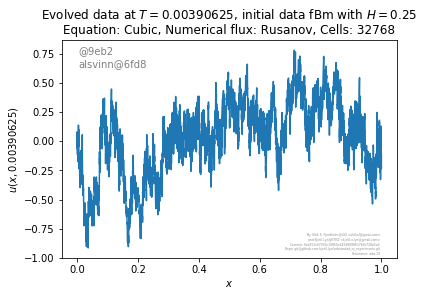

2019-04-26 00:13:51.066649 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.00390625, flux=rusanov, equation=cubic


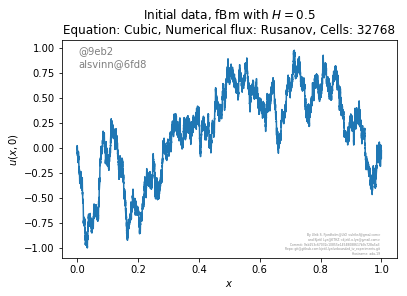

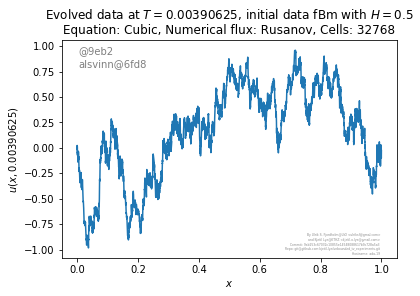

2019-04-26 00:14:01.894061 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_75/fractional_brownian.xml, T=0.00390625, flux=rusanov, equation=cubic


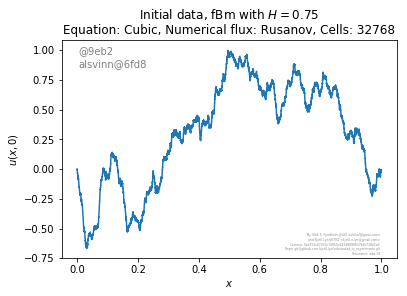

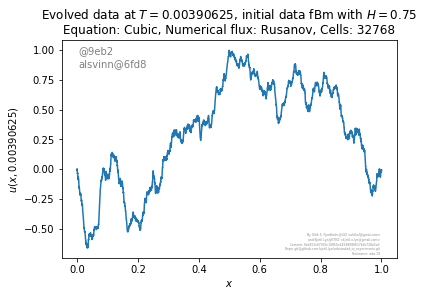

2019-04-26 00:15:14.371017 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.00390625, flux=roe, equation=cubic


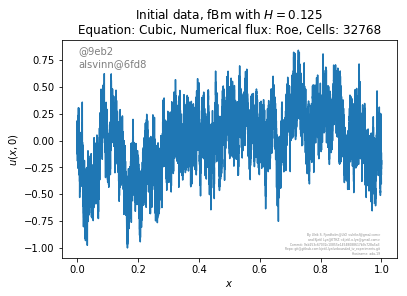

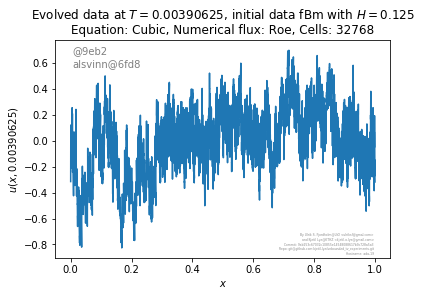

2019-04-26 00:15:31.780031 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.00390625, flux=roe, equation=cubic


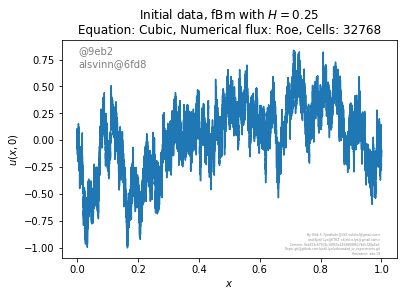

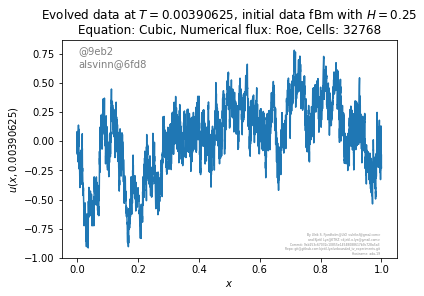

2019-04-26 00:15:42.582587 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.00390625, flux=roe, equation=cubic


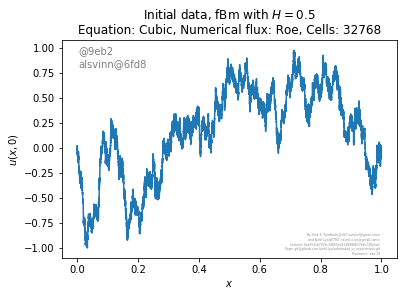

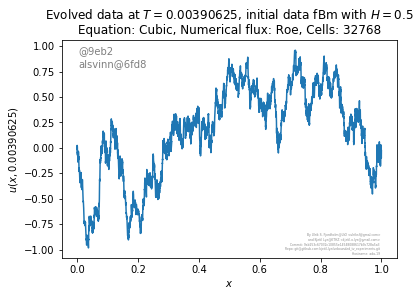

2019-04-26 00:17:05.596517 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_75/fractional_brownian.xml, T=0.00390625, flux=roe, equation=cubic


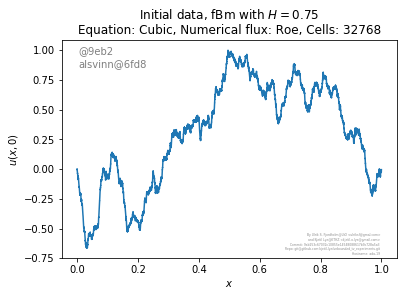

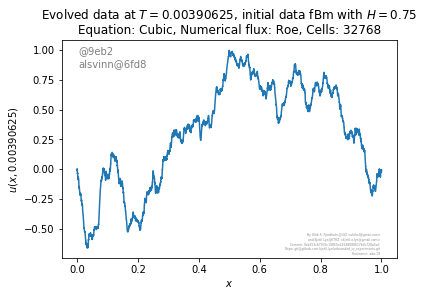

2019-04-26 00:17:33.383310 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.00390625, flux=rusanov, equation=linear


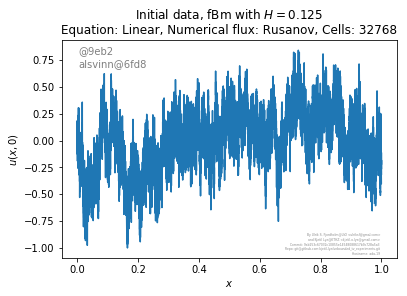

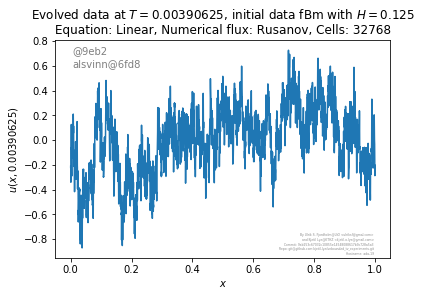

2019-04-26 00:17:46.947209 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.00390625, flux=rusanov, equation=linear


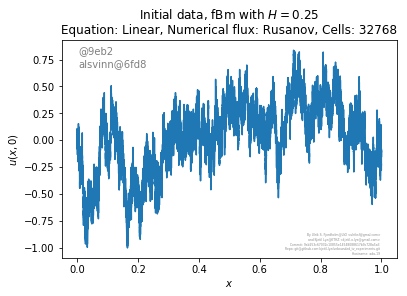

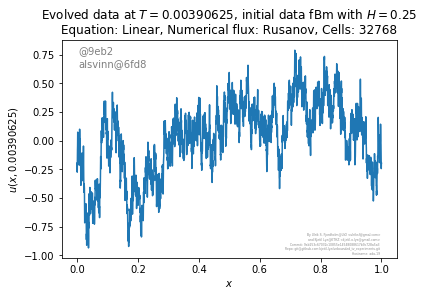

2019-04-26 00:18:08.133625 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.00390625, flux=rusanov, equation=linear


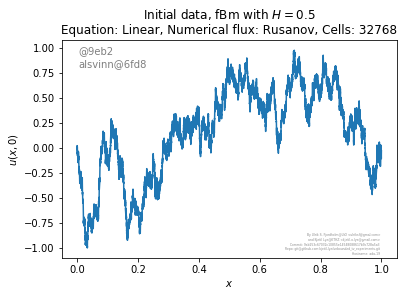

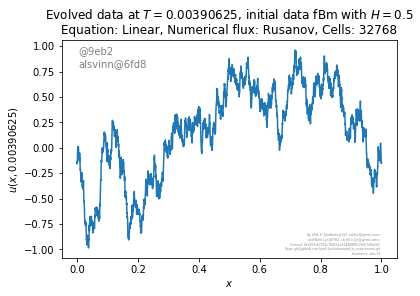

2019-04-26 00:18:17.333986 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_75/fractional_brownian.xml, T=0.00390625, flux=rusanov, equation=linear


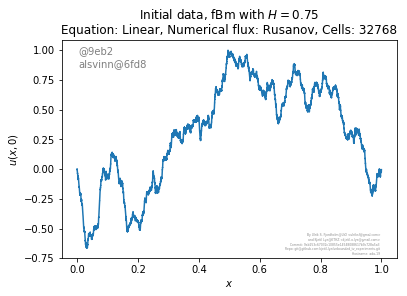

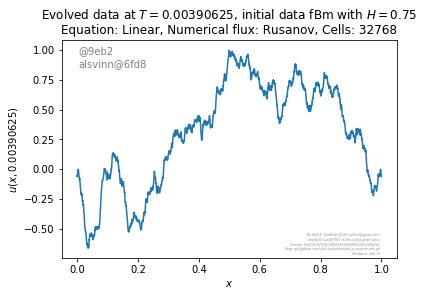

2019-04-26 00:18:27.074786 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.00390625, flux=upwind, equation=linear


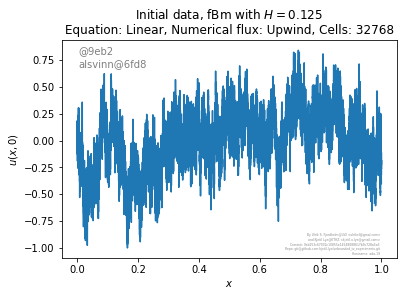

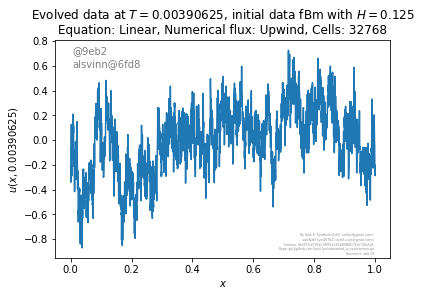

2019-04-26 00:18:39.975379 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.00390625, flux=upwind, equation=linear


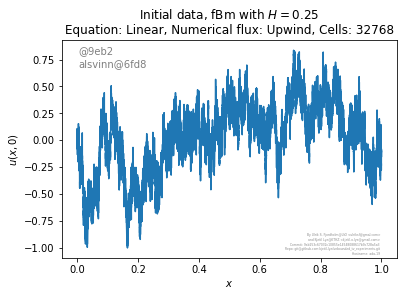

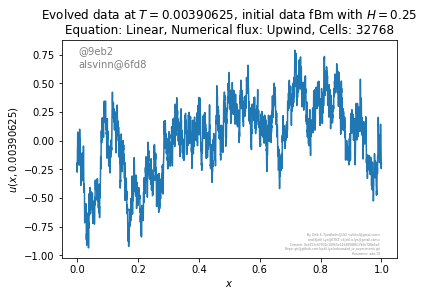

2019-04-26 00:18:50.748847 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.00390625, flux=upwind, equation=linear


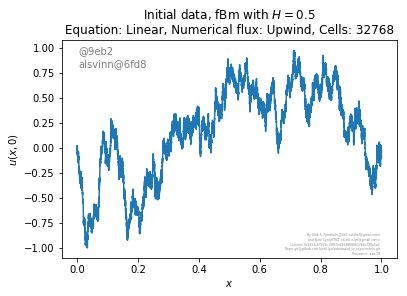

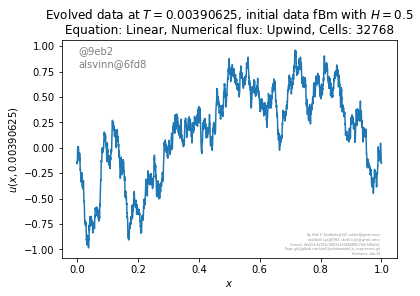

2019-04-26 00:19:45.622491 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_75/fractional_brownian.xml, T=0.00390625, flux=upwind, equation=linear


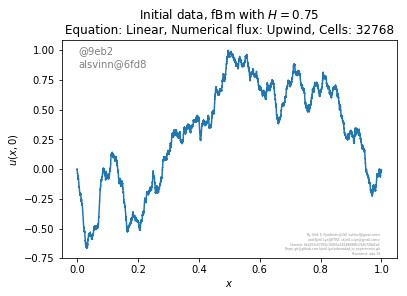

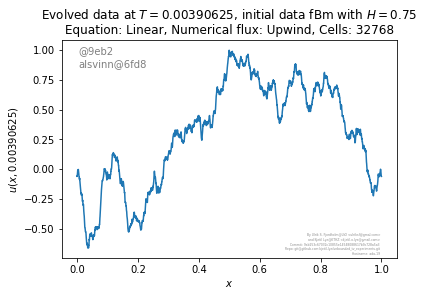

2019-04-26 00:20:44.988969 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=1, flux=rusanov, equation=burgers


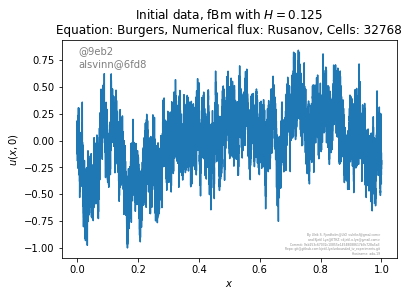

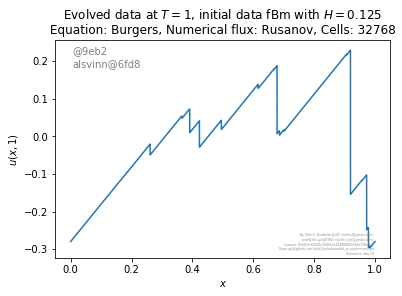

2019-04-26 00:27:38.714629 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=1, flux=rusanov, equation=burgers


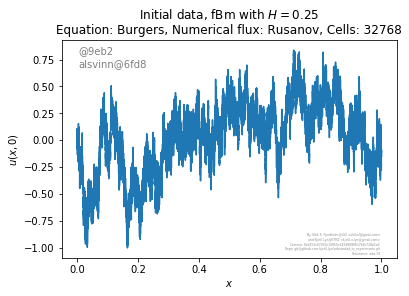

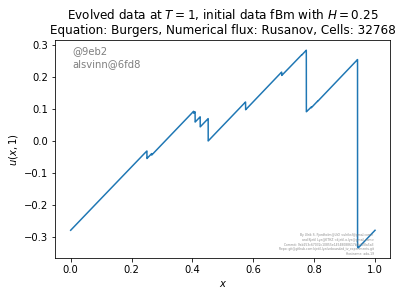

2019-04-26 00:36:06.772588 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=1, flux=rusanov, equation=burgers


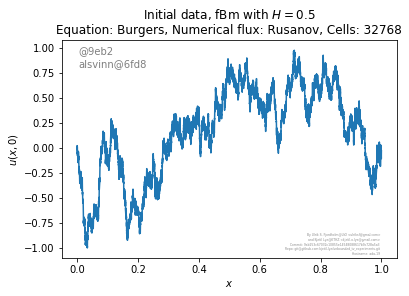

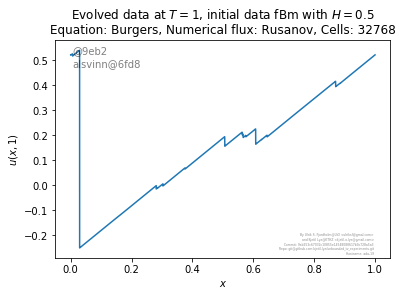

2019-04-26 00:47:44.615441 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_75/fractional_brownian.xml, T=1, flux=rusanov, equation=burgers


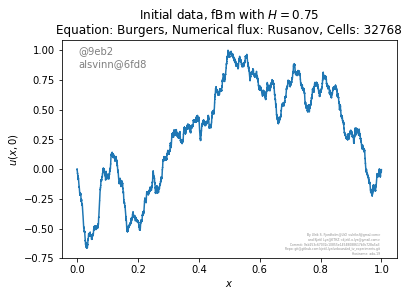

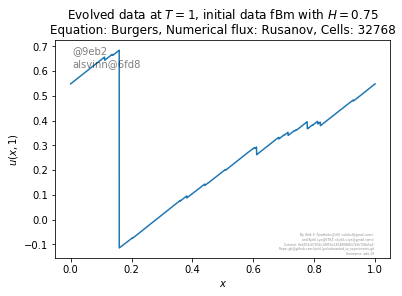

2019-04-26 01:00:39.495417 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=1, flux=godunov, equation=burgers


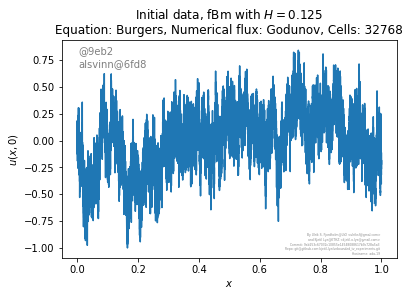

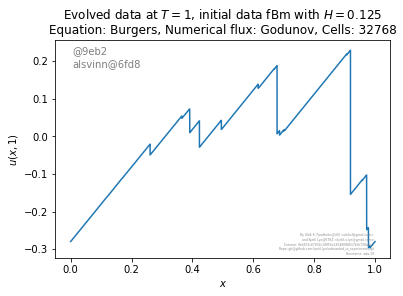

2019-04-26 01:08:18.906830 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=1, flux=godunov, equation=burgers


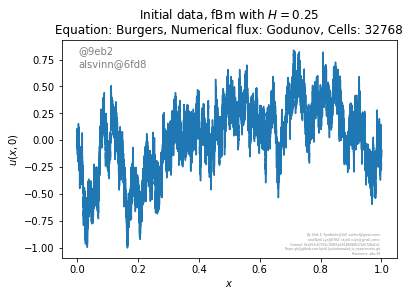

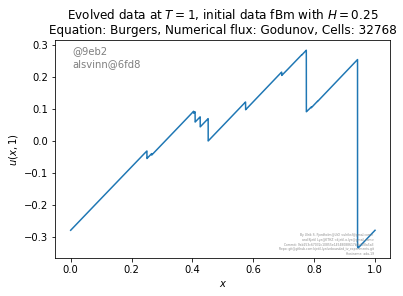

2019-04-26 01:18:23.201361 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=1, flux=godunov, equation=burgers


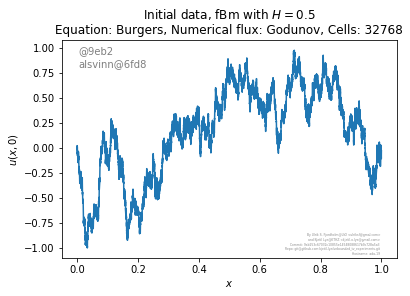

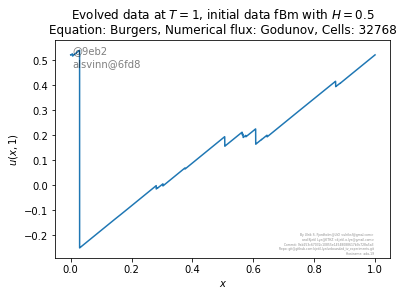

2019-04-26 01:32:22.064418 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_75/fractional_brownian.xml, T=1, flux=godunov, equation=burgers


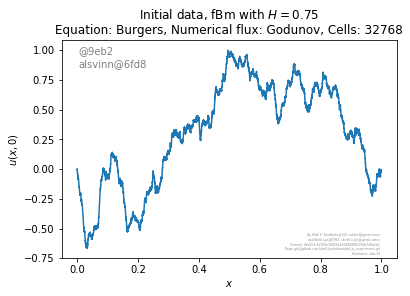

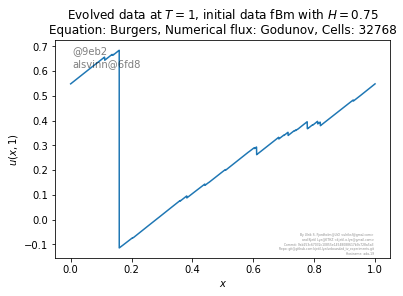

2019-04-26 01:47:48.457519 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=1, flux=roe, equation=burgers


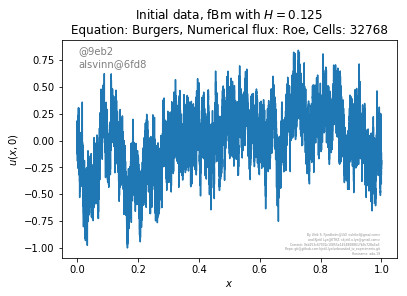

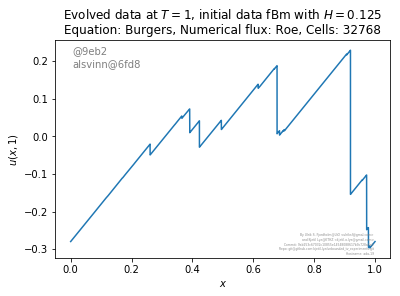

2019-04-26 01:54:42.369810 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=1, flux=roe, equation=burgers


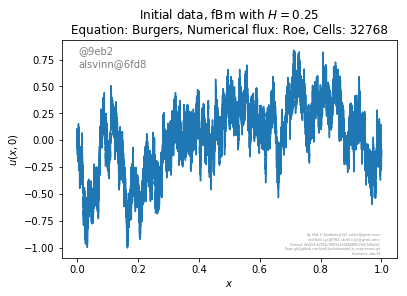

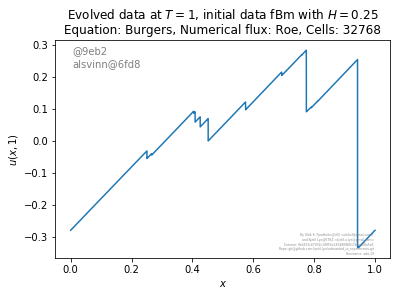

2019-04-26 02:03:38.387340 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=1, flux=roe, equation=burgers


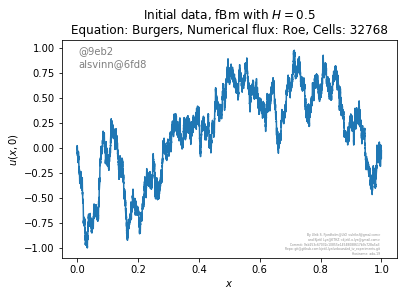

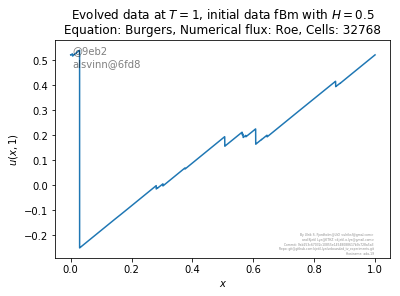

2019-04-26 02:16:00.181579 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_75/fractional_brownian.xml, T=1, flux=roe, equation=burgers


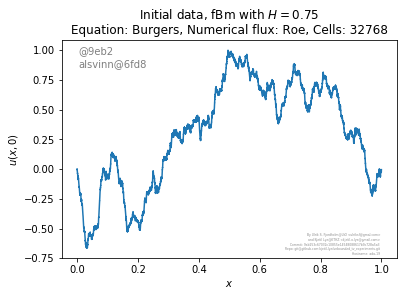

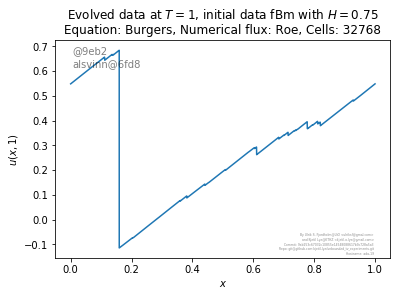

2019-04-26 02:30:11.132081 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=1, flux=rusanov, equation=cubic


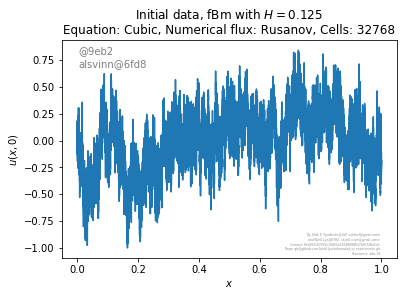

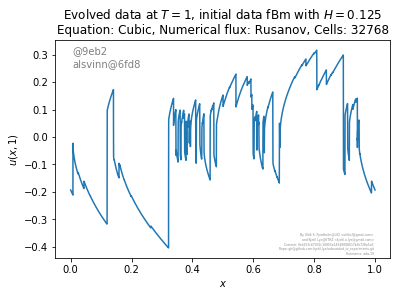

2019-04-26 02:34:09.803670 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=1, flux=rusanov, equation=cubic


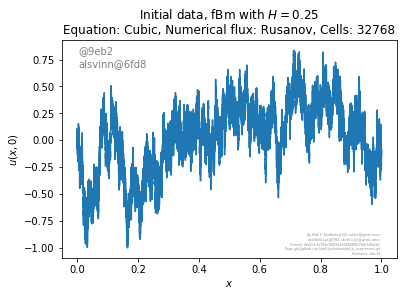

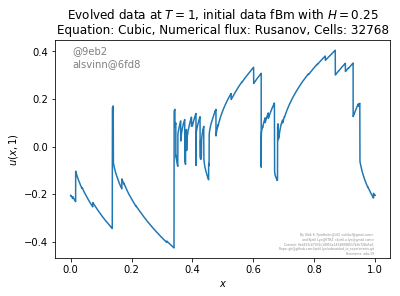

2019-04-26 02:40:40.587834 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=1, flux=rusanov, equation=cubic


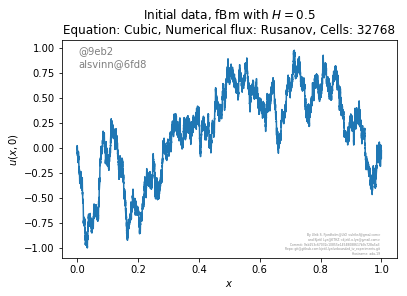

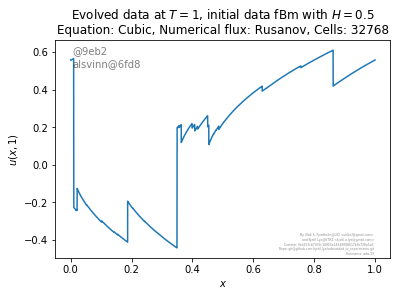

2019-04-26 02:50:38.103201 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_75/fractional_brownian.xml, T=1, flux=rusanov, equation=cubic


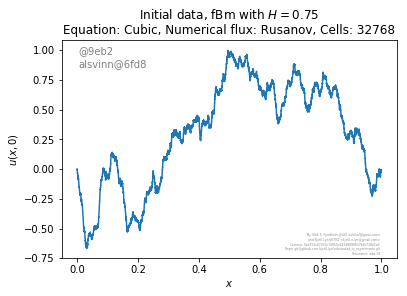

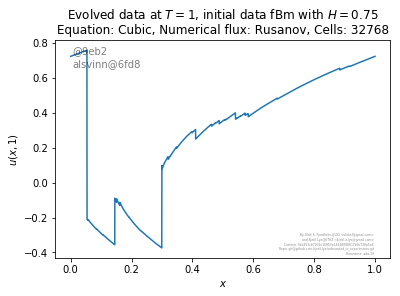

2019-04-26 03:02:49.853895 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=1, flux=roe, equation=cubic


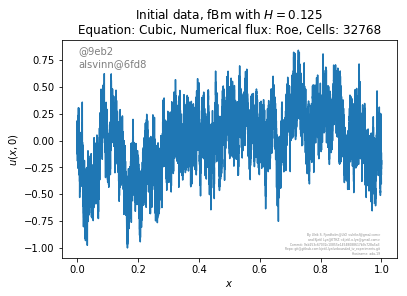

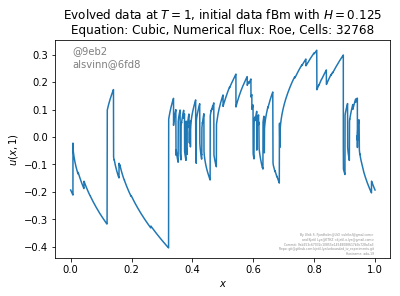

2019-04-26 03:07:10.445815 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=1, flux=roe, equation=cubic


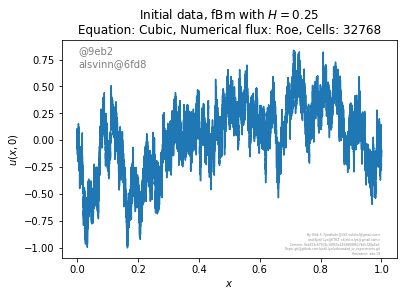

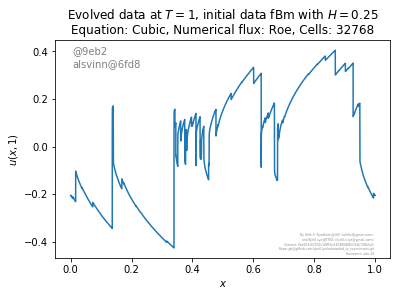

2019-04-26 03:13:51.159548 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=1, flux=roe, equation=cubic


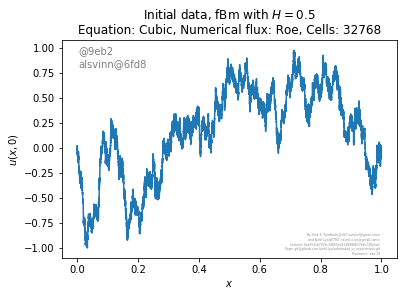

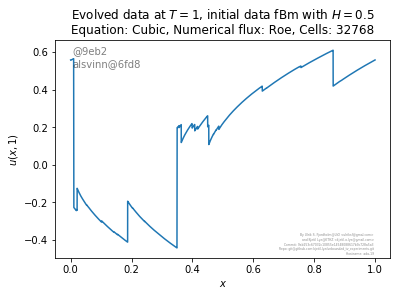

2019-04-26 03:25:17.188752 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_75/fractional_brownian.xml, T=1, flux=roe, equation=cubic


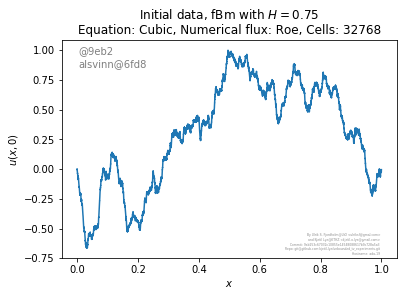

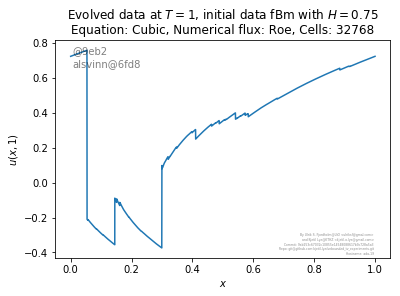

2019-04-26 03:38:12.574390 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=1, flux=rusanov, equation=linear


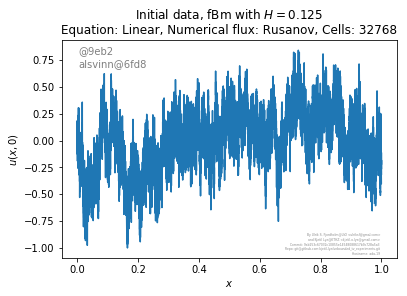

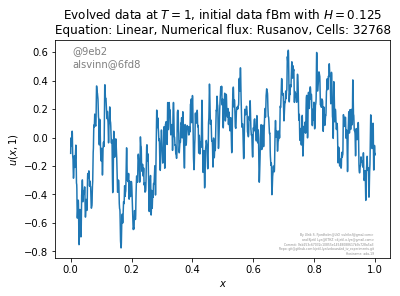

2019-04-26 03:50:39.965906 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=1, flux=rusanov, equation=linear


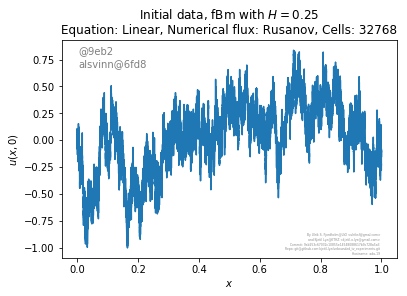

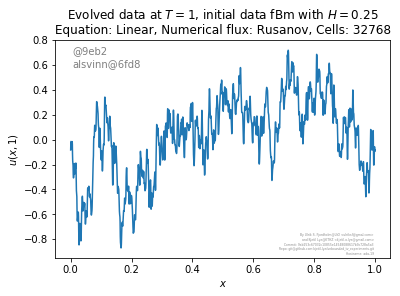

2019-04-26 04:03:01.625235 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=1, flux=rusanov, equation=linear


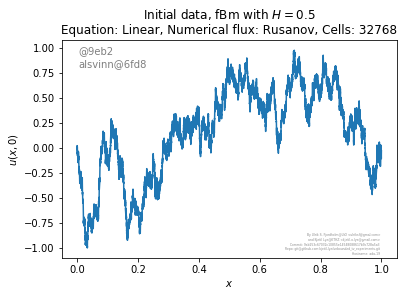

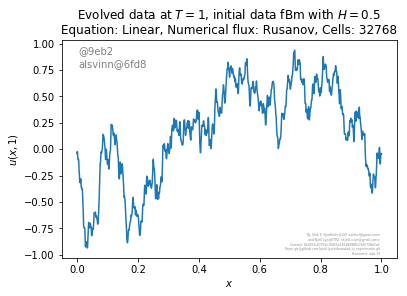

2019-04-26 04:15:19.240879 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_75/fractional_brownian.xml, T=1, flux=rusanov, equation=linear


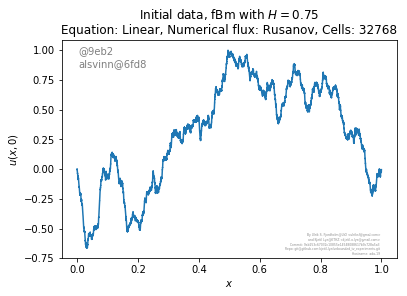

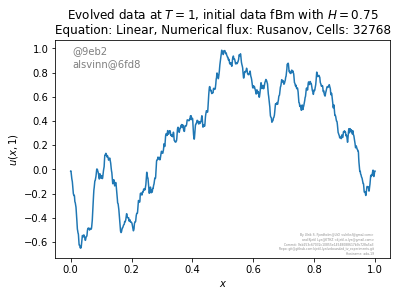

2019-04-26 04:27:50.265897 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=1, flux=upwind, equation=linear


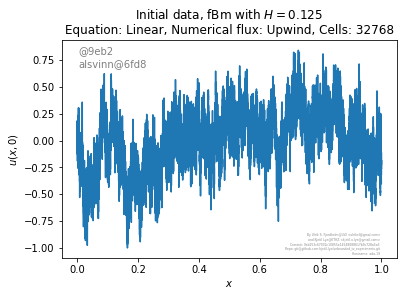

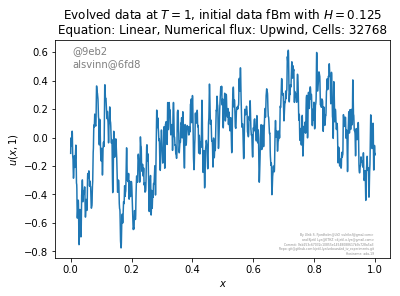

2019-04-26 04:39:43.930391 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=1, flux=upwind, equation=linear


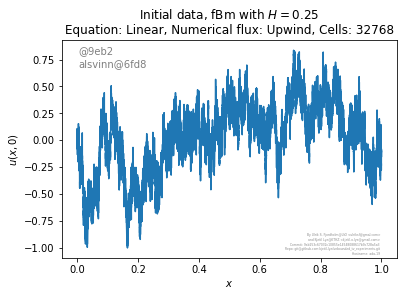

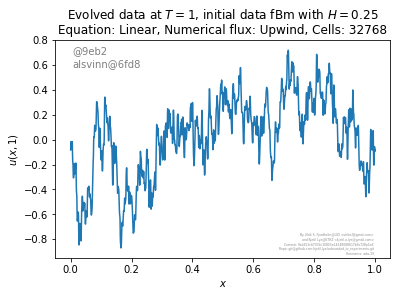

2019-04-26 04:51:37.702753 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=1, flux=upwind, equation=linear


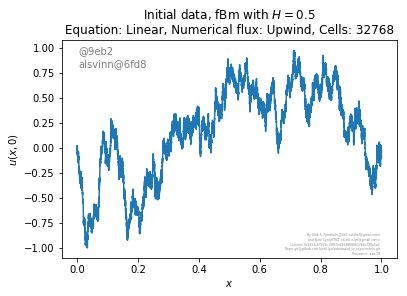

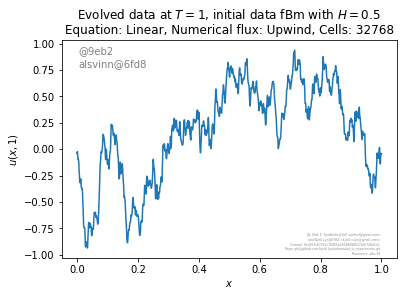

2019-04-26 05:03:31.616296 (in plot_solution): Running plot solution for ../configs/fractional_brownian_0_75/fractional_brownian.xml, T=1, flux=upwind, equation=linear


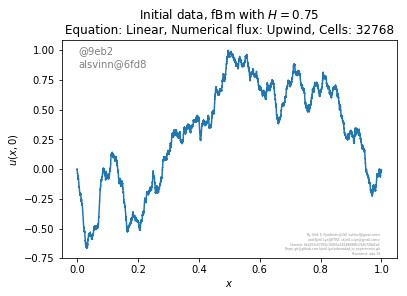

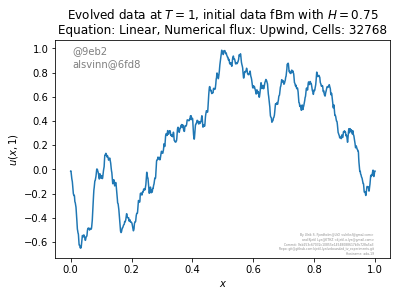

2019-04-26 05:15:29.247524 (in <module>): Done with fbm conv


In [10]:
def run_fbm_plot(equation, numerical_flux, exact_solution, T):
    Hs = [0.125, 0.25, 0.5, 0.75]

    base_xml_format_string = '../configs/fractional_brownian_{H_filename}/fractional_brownian.xml'

    N = COMPUTATIONAL_BUDGET
    for H in Hs:
        base_xml = base_xml_format_string.format(H_filename = str(H).replace(".","_"))
        
        name = "fBm $H={H}$".format(H=H)
        plot_solution(base_xml, name, T, N, numerical_flux=numerical_flux,
                   equation=equation, exact_solution_class=exact_solution)
        plt.figure(0)
        plt.title("Initial data, fBm with $H={hurz}$\nEquation: {equation}, Numerical flux: {numerical_flux}, Cells: {N}"\
              .format(hurz=H, equation=equation.capitalize(), numerical_flux=numerical_flux.capitalize(), N=N))
        
        plot_info.savePlot("fbm_initial_{equation}_{H}_{numerical_flux}"
                .format(equation=equation, H=str(H).replace(".", "_"), numerical_flux=numerical_flux))
        
        plt.figure(1)
        plt.title("Evolved data at $T={T}$, initial data fBm with $H={hurz}$\nEquation: {equation}, Numerical flux: {numerical_flux}, Cells: {N}"\
              .format(hurz=H, equation=equation.capitalize(), numerical_flux=numerical_flux.capitalize(), T=T, N=N))
        
                        
        plot_info.savePlot("fbm_evolved_{equation}_{numerical_flux}_{T}_{H}"
                .format(equation=equation, numerical_flux=numerical_flux, 
                        T=str(T).replace(".", "_"),
                        H=str(H).replace(".", "_")))
        plt.show()
        
for T in [1/256., 1]:
    run_all_configurations(run_fbm_plot, T)
plot_info.console_log_show("Done with fbm conv")
        
        

# Lipschitz scaling over resolution

In [11]:
def plot_lipschitz_resolution(base_xml, title,  
                exact_solution_class=None,
                numerical_flux="rusanov",
                equation="burgers"):
    
    plot_info.console_log_show("Running plot lipschitz scaling for {}, flux={}, equation={}".format(base_xml,
                                                                                                 
                                                                                                numerical_flux,
                                                                                                equation))
    
    resolutions = 2**np.arange(START_CAUCHY_UQ_T0_LOG, END_CAUCHY_UQ_T0_LOG)
    delta_xs = 1.0 / resolutions
    lipschitzs = []
    lipschitzs_avg = []
    lipschitzs_var = []
    M_samples = NUMBER_OF_SAMPLES
    for r in resolutions:
        run = alsvinn.run(name="lipschitz_solution",
            base_xml=base_xml,
            number_of_saves=1,
            dimension=[r,1,1],
            flux=numerical_flux,
            equation=equation,
            samples = M_samples,
            uq=True, # notice that since we have Brownian initial data, we need to enable uq
            T=0.0000001)
        
        u0 = run.get_data('u', 0)
        lipschitz = max((np.diff(u0)>0)*np.diff(u0))*r
        lipschitzs.append(lipschitz)
        
        avg = 0
        lipschitz_samples = []
        for k in range(M_samples):
            u0 = run.get_data('u', 0, sample=k)
            lipschitz = max((np.diff(u0)>0)*np.diff(u0))*r
            lipschitz_samples.append(lipschitz)
           
        lipschitzs_avg.append(np.mean(lipschitz_samples))
        lipschitzs_var.append(np.var(lipschitz_samples))
    plt.figure(0)
    poly = np.polyfit(np.log(delta_xs), np.log(lipschitzs), 1)
    
    line_information = plt.loglog(delta_xs, lipschitzs, '-o', label=title)
    plt.loglog(delta_xs, np.exp(poly[1])*delta_xs**poly[0], '--', 
               color=line_information[0].get_color(),
              label='$\\mathcal{O}(\\Delta x^{%.2f})$' % poly[0], 
              basex=2)
    
    plt.xlabel('$\\Delta x$')
    plt.ylabel('$L^+_0$')
    
    
    
    plt.figure(1)
    poly = np.polyfit(np.log(delta_xs), np.log(lipschitzs_avg), 1)
    
    line_information = plt.errorbar(delta_xs, lipschitzs_avg, 
                                    yerr=np.sqrt(lipschitzs_var), label=title)
    
    plt.loglog(delta_xs, np.exp(poly[1])*delta_xs**poly[0], '--', 
               color=line_information[0].get_color(),
              label='$\\mathcal{O}(\\Delta x^{%.2f})$' % poly[0], 
              basex=2)
    plt.gca().set_xscale("log", nonposx='clip',basex=2)
    plt.gca().set_yscale("log", nonposy='clip',basey=2)

    plt.xlabel('$\\Delta x$')
    plt.ylabel('Average $L^+_0$ (over %d samples)' % M_samples)
    plot_info.console_log_show("Done configuration {} {} {}".format(base_xml, equation, numerical_flux))
        
        

2019-04-26 05:15:29.520641 (in plot_lipschitz_resolution): Running plot lipschitz scaling for ../configs/fractional_brownian_0_125/fractional_brownian.xml, flux=godunov, equation=burgers
2019-04-26 05:40:00.031126 (in plot_lipschitz_resolution): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml burgers godunov
2019-04-26 05:40:00.051985 (in plot_lipschitz_resolution): Running plot lipschitz scaling for ../configs/fractional_brownian_0_25/fractional_brownian.xml, flux=godunov, equation=burgers
2019-04-26 06:04:31.710230 (in plot_lipschitz_resolution): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml burgers godunov
2019-04-26 06:04:31.730270 (in plot_lipschitz_resolution): Running plot lipschitz scaling for ../configs/fractional_brownian_0_5/fractional_brownian.xml, flux=godunov, equation=burgers
2019-04-26 06:28:59.261171 (in plot_lipschitz_resolution): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.

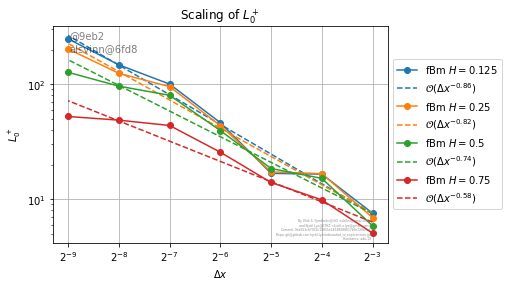

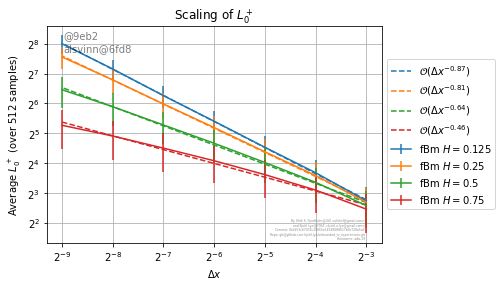

In [12]:
def run_lipschitz_resolution(equation, numerical_flux, exact_solution, T):
    Hs = [0.125, 0.25, 0.5, 0.75]

    base_xml_format_string = '../configs/fractional_brownian_{H_filename}/fractional_brownian.xml'

    
    for H in Hs:
        base_xml = base_xml_format_string.format(H_filename = str(H).replace(".","_"))
        
        name = "fBm $H={H}$".format(H=H)
        plot_lipschitz_resolution(base_xml, name, numerical_flux=numerical_flux,
                   equation=equation, exact_solution_class=exact_solution)
    plt.figure(0)
    plot_info.legendLeft()
    plt.grid(True)
    plt.title("Scaling of $L^+_0$")
    plot_info.savePlot("fbm_lipschitz_scaling")
    
    plt.figure(1)
    plot_info.legendLeft()
    plt.grid(True)
    plt.title("Scaling of $L^+_0$")
    plot_info.savePlot("fbm_lipschitz_scaling_avg")
    plt.show()

run_lipschitz_resolution("burgers", "godunov", None, 0.1)

# TV scaling resolution

In [13]:
def plot_tv_resolution(base_xml, title,  
                exact_solution_class=None,
                numerical_flux="rusanov",
                equation="burgers"):
    plot_info.console_log_show("Running plot TV over resolution for {},  flux={}, equation={}".format(base_xml,
                                                                                                numerical_flux,
                                                                                                equation))
    
    resolutions = 2**np.arange(START_CAUCHY_DET_T0_LOG, END_CAUCHY_DET_T0_LOG)
    delta_xs = 1.0 / resolutions
    TVs = []
    for r in resolutions:
        run = alsvinn.run(name="tv_resolution",
            base_xml=base_xml,
            number_of_saves=1,
            dimension=[r,1,1],
            flux=numerical_flux,
            equation=equation,
            uq=True, # notice that since we have Brownian initial data, we need to enable uq
            T=0.0000001)
        
        u0 = run.get_data('u', 0)
        TV = np.sum(abs(np.diff(u0)))
        TVs.append(TV)

    
    poly = np.polyfit(np.log(delta_xs), np.log(TVs), 1)
    
    line_information = plt.loglog(delta_xs, TVs, '-o', label=title)
    plt.loglog(delta_xs, np.exp(poly[1])*delta_xs**poly[0], '--', 
               color=line_information[0].get_color(),
              label='$\\mathcal{O}(\\Delta x^{%.2f})$' % poly[0], 
              basex=2)
    
    plt.xlabel('$\\Delta x$')
    plt.ylabel('$\\mathrm{TV}(u_0^{\\Delta x})$')
    plot_info.console_log_show("Done configuration {} {} {}".format(base_xml, equation, numerical_flux))

2019-04-26 06:53:33.923135 (in plot_tv_resolution): Running plot TV over resolution for ../configs/fractional_brownian_0_125/fractional_brownian.xml,  flux=godunov, equation=burgers
2019-04-26 06:53:44.124154 (in plot_tv_resolution): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml burgers godunov
2019-04-26 06:53:44.139412 (in plot_tv_resolution): Running plot TV over resolution for ../configs/fractional_brownian_0_25/fractional_brownian.xml,  flux=godunov, equation=burgers
2019-04-26 06:53:54.355649 (in plot_tv_resolution): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml burgers godunov
2019-04-26 06:53:54.372669 (in plot_tv_resolution): Running plot TV over resolution for ../configs/fractional_brownian_0_5/fractional_brownian.xml,  flux=godunov, equation=burgers
2019-04-26 06:54:04.592251 (in plot_tv_resolution): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml burgers godunov
2019-04-26 06:54

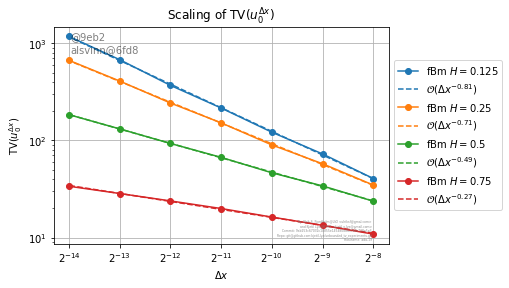

In [14]:
def run_tv_resolution(equation, numerical_flux, exact_solution, T):
    Hs = [0.125, 0.25, 0.5, 0.75]

    base_xml_format_string = '../configs/fractional_brownian_{H_filename}/fractional_brownian.xml'

    
    for H in Hs:
        base_xml = base_xml_format_string.format(H_filename = str(H).replace(".","_"))
        
        name = "fBm $H={H}$".format(H=H)
        plot_tv_resolution(base_xml, name, numerical_flux=numerical_flux,
                   equation=equation, exact_solution_class=exact_solution)
    plot_info.legendLeft()
    plt.title("Scaling of $\\mathrm{TV}(u_0^{\\Delta x})$")
    plt.grid(True)
    plot_info.savePlot("fbm_tv_scaling")
    
    plt.show()

run_tv_resolution("burgers", "godunov", None, 0.1)

# Lipschitz over time

In [15]:
def lipschitz_versus_time(base_xml, title, T, 
                    exact_solution_class=None,
                    numerical_flux="rusanov",
                    equation="burgers"):
    
    plot_info.console_log_show("Running lipschitz over time for {}, T={}, flux={}, equation={}".format(base_xml,
                                                                                                 T,
                                                                                                numerical_flux,
                                                                                                equation))
    N = 128
    M = CONVERGENCE_UQ_HIGHEST_RESOLUTION
    M_samples = NUMBER_OF_SAMPLES
    
    run = alsvinn.run(name="Lipschitz_solution",
        base_xml=base_xml,
        number_of_saves=N,
        dimension=[M,1,1],
        flux=numerical_flux,
        equation=equation,
        samples=M_samples,
        uq=True, # notice that since we have Brownian initial data, we need to enable uq
        T=T)
    
    lipschitzs = []
    lipschitzs_avg = []
    Ts = np.linspace(0,T,N)
    for t_index in range(N):
        u = run.get_data("u", t_index)
        
        lipschitz = max((np.diff(u)>0)*np.diff(u))*M
        lipschitzs.append(lipschitz)
        
        avg = 0
        for k in range(M_samples):
            u = run.get_data("u", t_index, sample=k)
        
            lipschitz = max((np.diff(u)>0)*np.diff(u))*M
            avg += lipschitz
        avg /= M_samples
        lipschitzs_avg.append(avg)
        
    lipschitzs_avg = np.array(lipschitzs_avg)
    lipschitzs = np.array(lipschitzs)
    
    plt.figure(0)
    poly = np.polyfit(Ts[1:], 1.0/lipschitzs[1:], 1)
    
    print(poly)
    
    line_info = plt.plot(Ts, 1.0/lipschitzs, label=title)
    
    plt.plot(Ts[1:], poly[0]*Ts[1:]+poly[1],
             '--',
             color=line_info[0].get_color(),
             label='$%.3f t %+.3f$' % (poly[0], poly[1]))
    plt.title("T = {}".format(T))
    plot_info.legendLeft()
    plt.xlabel("$t^n$")
    plt.ylabel("$L^+_n$")
    
    
    plt.figure(1)
    poly = np.polyfit(Ts[1:], 1.0/lipschitzs_avg[1:], 1)
    
    print(poly)
    
    line_info = plt.plot(Ts, 1.0/lipschitzs_avg, label=title)
    
    plt.plot(Ts[1:], poly[0]*Ts[1:]+poly[1],
             '--',
             color=line_info[0].get_color(),
             label='$%.3f t %+.3f$' % (poly[0], poly[1]))
    plt.title("T = {}".format(T))
    plot_info.legendLeft()
    plt.xlabel("$t^n$")
    plt.ylabel("$L^+_n$ (averaged over %d samples)" % M_samples)
    plot_info.console_log_show("Done configuration {} {} {} {}".format(base_xml, equation, numerical_flux, T))


2019-04-26 06:54:19.783998 (in lipschitz_versus_time): Running lipschitz over time for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.5, flux=rusanov, equation=burgers
[0.76638486 0.04094332]
[0.59873119 0.05277517]
2019-04-26 07:08:43.521446 (in lipschitz_versus_time): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml burgers rusanov 0.5
2019-04-26 07:08:43.545152 (in lipschitz_versus_time): Running lipschitz over time for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.5, flux=rusanov, equation=burgers
[0.74926295 0.06044916]
[0.61651704 0.0581847 ]
2019-04-26 07:23:00.249012 (in lipschitz_versus_time): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml burgers rusanov 0.5
2019-04-26 07:23:00.272559 (in lipschitz_versus_time): Running lipschitz over time for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.5, flux=rusanov, equation=burgers
[0.66456428 0.06539021]
[0.65309583 0

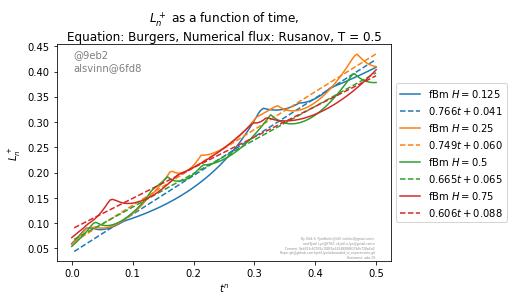

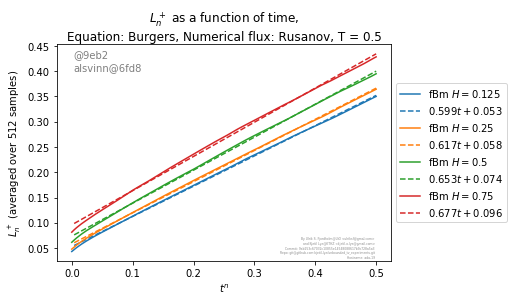

2019-04-26 07:51:46.912090 (in lipschitz_versus_time): Running lipschitz over time for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.5, flux=godunov, equation=burgers
[0.57016149 0.03145869]
[0.43557335 0.03580717]
2019-04-26 08:06:03.720900 (in lipschitz_versus_time): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml burgers godunov 0.5
2019-04-26 08:06:03.744090 (in lipschitz_versus_time): Running lipschitz over time for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.5, flux=godunov, equation=burgers
[0.26261156 0.07603245]
[0.46963085 0.04118287]
2019-04-26 08:20:31.165066 (in lipschitz_versus_time): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml burgers godunov 0.5
2019-04-26 08:20:31.191556 (in lipschitz_versus_time): Running lipschitz over time for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.5, flux=godunov, equation=burgers
[0.23864578 0.07354882]
[0.53772007 0

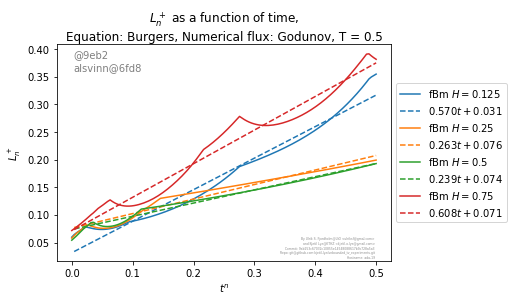

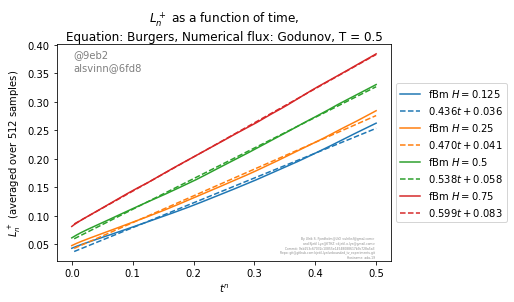

2019-04-26 08:49:20.060704 (in lipschitz_versus_time): Running lipschitz over time for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.5, flux=roe, equation=burgers
[0.57016149 0.03145869]
[0.43557335 0.03580717]
2019-04-26 09:03:45.066837 (in lipschitz_versus_time): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml burgers roe 0.5
2019-04-26 09:03:45.088861 (in lipschitz_versus_time): Running lipschitz over time for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.5, flux=roe, equation=burgers
[0.26261156 0.07603245]
[0.46963085 0.04118287]
2019-04-26 09:18:03.960275 (in lipschitz_versus_time): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml burgers roe 0.5
2019-04-26 09:18:03.982693 (in lipschitz_versus_time): Running lipschitz over time for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.5, flux=roe, equation=burgers
[0.23864578 0.07354882]
[0.53772007 0.05775605]
2019-04-2

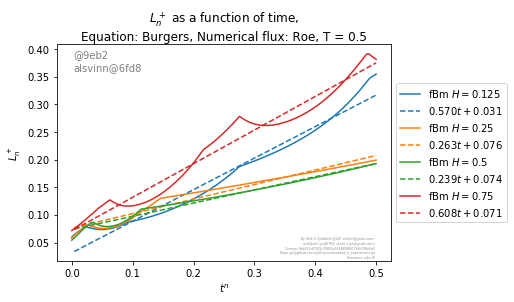

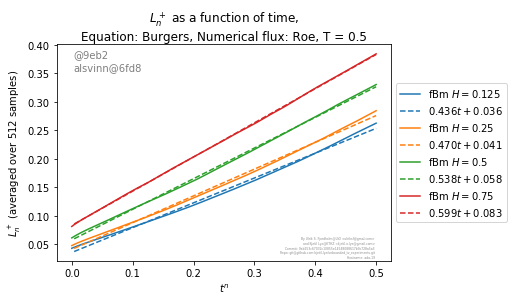

2019-04-26 09:46:35.087270 (in lipschitz_versus_time): Running lipschitz over time for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.5, flux=rusanov, equation=cubic
[0.04359617 0.07875932]
[0.06180794 0.06257818]
2019-04-26 10:00:44.669024 (in lipschitz_versus_time): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml cubic rusanov 0.5
2019-04-26 10:00:44.691031 (in lipschitz_versus_time): Running lipschitz over time for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.5, flux=rusanov, equation=cubic
[0.01587126 0.0812167 ]
[0.05444146 0.0672311 ]
2019-04-26 10:14:52.604748 (in lipschitz_versus_time): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml cubic rusanov 0.5
2019-04-26 10:14:52.625262 (in lipschitz_versus_time): Running lipschitz over time for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.5, flux=rusanov, equation=cubic
[-0.00714105  0.07866567]
[0.03158917 0.0795222

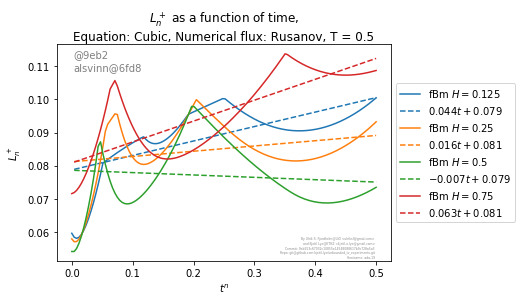

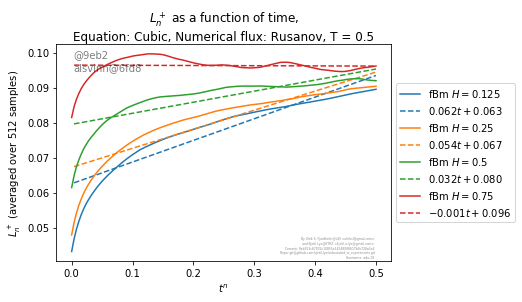

2019-04-26 15:42:55.618880 (in lipschitz_versus_time): Running lipschitz over time for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.5, flux=roe, equation=cubic
[0.03749363 0.06205898]
[0.04389795 0.05122096]
2019-04-26 18:26:32.955468 (in lipschitz_versus_time): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml cubic roe 0.5
2019-04-26 18:26:32.976344 (in lipschitz_versus_time): Running lipschitz over time for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.5, flux=roe, equation=cubic
[0.02071942 0.06277823]
[0.0395533  0.05630326]
2019-04-26 19:14:13.304048 (in lipschitz_versus_time): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml cubic roe 0.5
2019-04-26 19:14:13.325220 (in lipschitz_versus_time): Running lipschitz over time for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.5, flux=roe, equation=cubic
[-0.00564836  0.0624491 ]
[0.01857114 0.07082677]
2019-04-26 19:28:

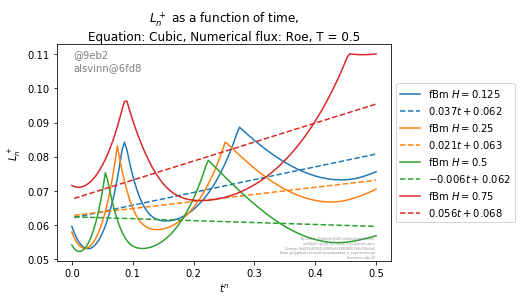

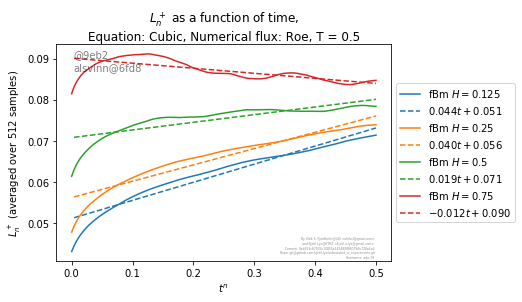

2019-04-26 19:43:12.863896 (in lipschitz_versus_time): Running lipschitz over time for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.5, flux=rusanov, equation=linear
[0.69630475 0.11194391]
[0.26976241 0.08785989]
2019-04-26 19:57:23.551859 (in lipschitz_versus_time): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml linear rusanov 0.5
2019-04-26 19:57:23.573441 (in lipschitz_versus_time): Running lipschitz over time for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.5, flux=rusanov, equation=linear
[0.54740275 0.10841773]
[0.24595138 0.09182999]
2019-04-26 20:11:48.268322 (in lipschitz_versus_time): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml linear rusanov 0.5
2019-04-26 20:11:48.288535 (in lipschitz_versus_time): Running lipschitz over time for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.5, flux=rusanov, equation=linear
[0.31657043 0.09388625]
[0.20435848 0.1025

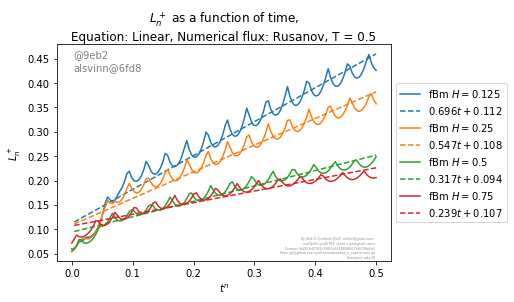

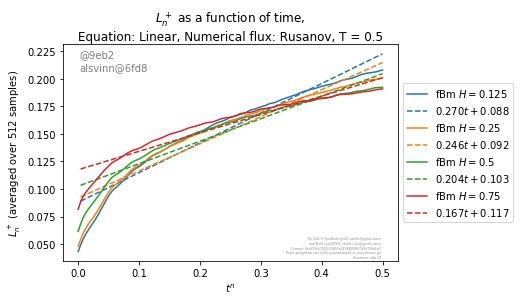

2019-04-26 20:40:57.792180 (in lipschitz_versus_time): Running lipschitz over time for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.5, flux=upwind, equation=linear
[0.69630475 0.11194391]
[0.26976241 0.08785989]
2019-04-26 20:55:15.300293 (in lipschitz_versus_time): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml linear upwind 0.5
2019-04-26 20:55:15.320358 (in lipschitz_versus_time): Running lipschitz over time for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.5, flux=upwind, equation=linear
[0.54740275 0.10841773]
[0.24595138 0.09182999]
2019-04-26 21:09:34.879710 (in lipschitz_versus_time): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml linear upwind 0.5
2019-04-26 21:09:34.900720 (in lipschitz_versus_time): Running lipschitz over time for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.5, flux=upwind, equation=linear
[0.31657043 0.09388625]
[0.20435848 0.10251782]

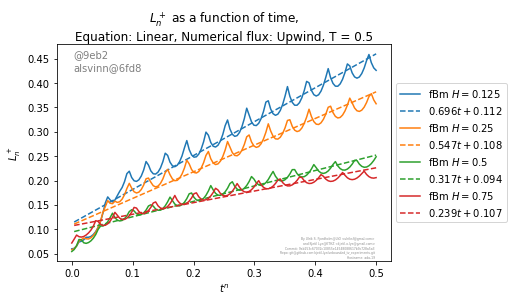

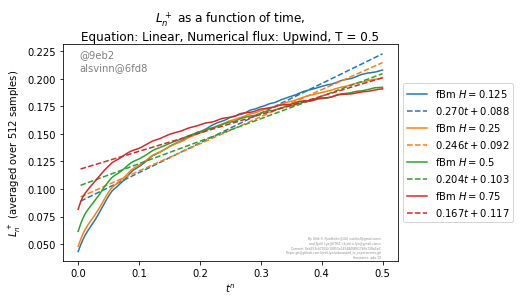

In [16]:
def run_fbm_lipschitz_time(equation, numerical_flux, exact_solution, T):
    Hs = [0.125, 0.25, 0.5, 0.75]

    base_xml_format_string = '../configs/fractional_brownian_{H_filename}/fractional_brownian.xml'

   
    for H in Hs:
        base_xml = base_xml_format_string.format(H_filename = str(H).replace(".","_"))
        
        name = "fBm $H={H}$".format(H=H)
        lipschitz_versus_time(base_xml, name, T, numerical_flux=numerical_flux,
                   equation=equation, exact_solution_class=exact_solution)
    plt.figure(0)
    plt.title("$L^+_n$ as a function of time,\nEquation: {equation}, Numerical flux: {numerical_flux}, T = {T}"\
              .format(equation=equation.capitalize(), numerical_flux=numerical_flux.capitalize(), T=T))
    
    
    plot_info.legendLeft()
    plot_info.savePlot("fbm_lipschitz_time_{equation}_{numerical_flux}_{T}"
                .format(equation=equation, numerical_flux=numerical_flux, 
                        T=str(T).replace(".", "_")))
    
    plt.figure(1)
    plt.title("$L^+_n$ as a function of time,\nEquation: {equation}, Numerical flux: {numerical_flux}, T = {T}"\
              .format(equation=equation.capitalize(), numerical_flux=numerical_flux.capitalize(), T=T))
    
    
    plot_info.legendLeft()
    plot_info.savePlot("fbm_lipschitz_time_avg_{equation}_{numerical_flux}_{T}"
                .format(equation=equation, numerical_flux=numerical_flux, 
                        T=str(T).replace(".", "_")))
    plt.show()
    
T = 0.5
run_all_configurations(run_fbm_lipschitz_time, T)
                                          

# Single solution compare

In [17]:
def plot_solution_at_two_resolutions(base_xml, title, T, M1, M2, 
                exact_solution_class=None,
                numerical_flux="rusanov",
                equation="burgers"):
    
    
    
    plot_info.console_log_show("Running plot_solution_at_two_resolutions for {}, T={}, flux={}, equation={}".format(base_xml,
                                                                                                 T,
                                                                                                numerical_flux,
                                                                                                equation))
    run_m1 = alsvinn.run(name="M1solution",
        base_xml=base_xml,
        number_of_saves=1,
        dimension=[M1,1,1],
        flux=numerical_flux,
        equation=equation,
        uq=True, # notice that since we have Brownian initial data, we need to enable uq
        T=T)
    
    
    run_m2 = alsvinn.run(name="M2solution",
        base_xml=base_xml,
        number_of_saves=1,
        dimension=[M2,1,1],
        flux=numerical_flux,
        equation=equation,
        uq=True, # notice that since we have Brownian initial data, we need to enable uq
        T=T)
    
    t_indices = [0, 1]
    ts = [0, T]
    for t_index in t_indices:
        t = ts[t_index]
        u1 = run_m1.get_data("u", t_index)
        x1 = np.linspace(0, 1, u1.shape[0])
        
        u2 = run_m2.get_data("u", t_index)
        x2 = np.linspace(0, 1, u2.shape[0])
        
        plt.figure(t_index)
        plt.plot(x1, u1, label='$\\Delta x = 2^{-%d}$' % int(np.log2(M1)))
        plt.plot(x2, u2, label='$\\Delta x = 2^{-%d}$' % int(np.log2(M2)))
        plt.xlabel("$x$")
        plt.ylabel("$u(x,{})$".format(t))
        
    plot_info.console_log_show("Done configuration {} {} {} {}".format(base_xml, equation, numerical_flux, T))

2019-04-26 21:38:51.575267 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.00390625, flux=rusanov, equation=burgers
2019-04-26 21:38:57.170906 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml burgers rusanov 0.00390625


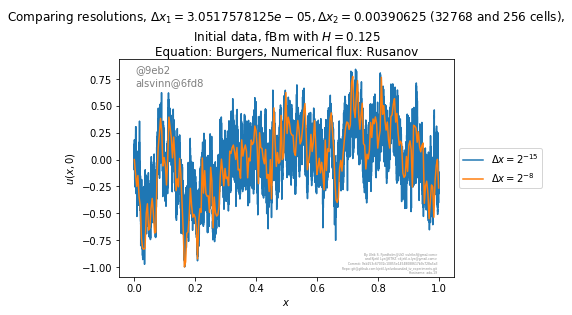

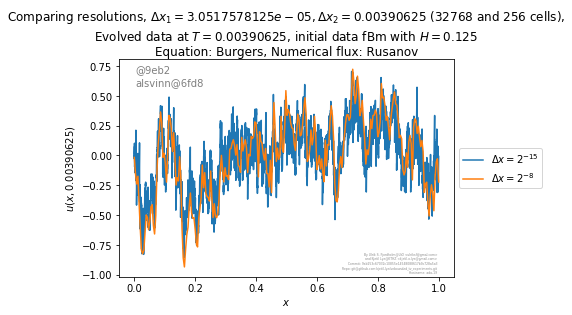

2019-04-26 21:39:03.921704 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.00390625, flux=rusanov, equation=burgers
2019-04-26 21:39:09.686271 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml burgers rusanov 0.00390625


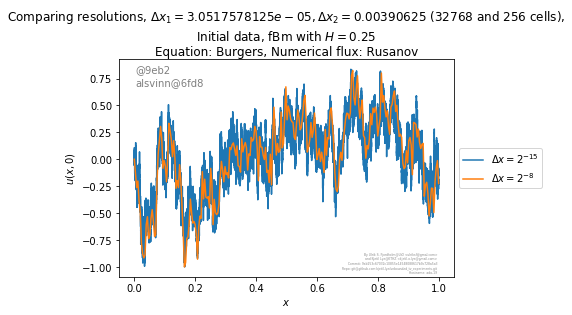

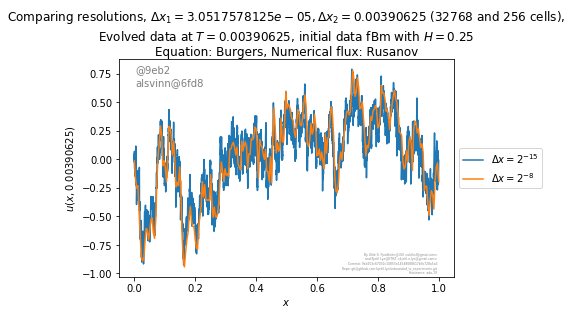

2019-04-26 21:39:16.021826 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.00390625, flux=rusanov, equation=burgers
2019-04-26 21:39:25.813490 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml burgers rusanov 0.00390625


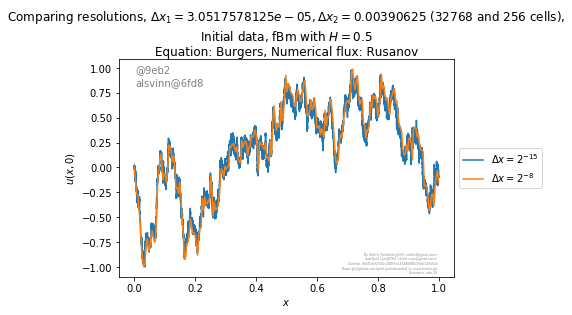

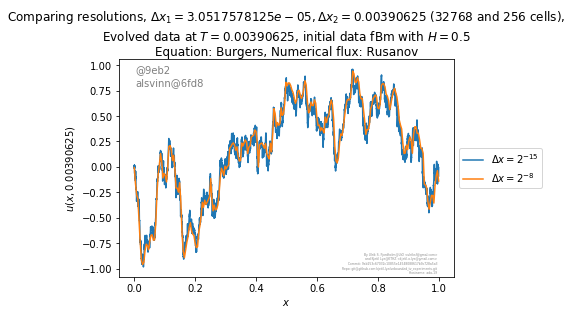

2019-04-26 21:39:31.869800 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_75/fractional_brownian.xml, T=0.00390625, flux=rusanov, equation=burgers
2019-04-26 21:39:39.569391 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_75/fractional_brownian.xml burgers rusanov 0.00390625


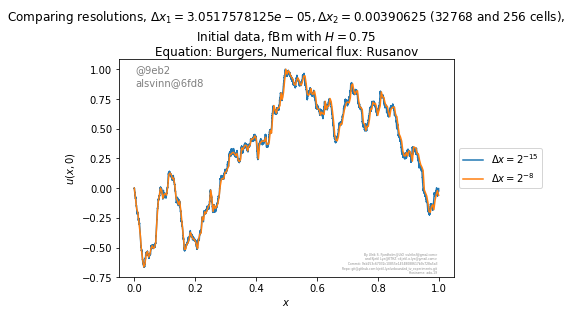

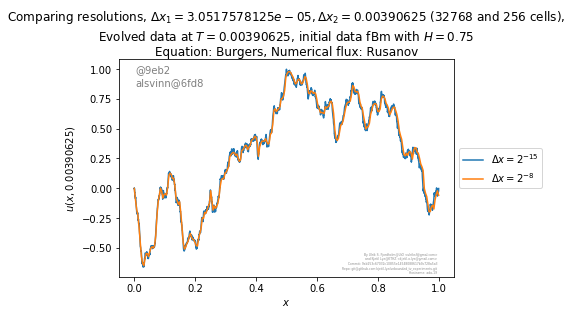

2019-04-26 21:39:45.290087 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.00390625, flux=godunov, equation=burgers
2019-04-26 21:39:53.763841 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml burgers godunov 0.00390625


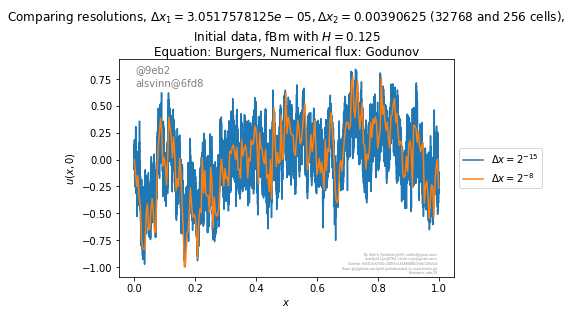

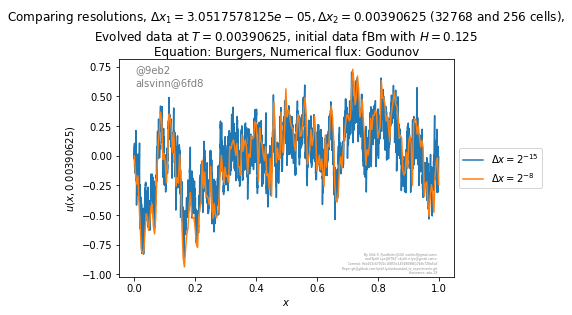

2019-04-26 21:40:00.754958 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.00390625, flux=godunov, equation=burgers
2019-04-26 21:40:08.815850 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml burgers godunov 0.00390625


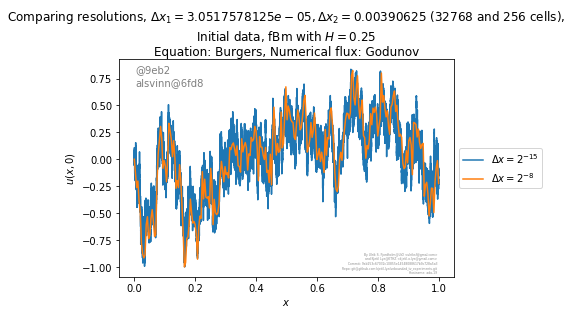

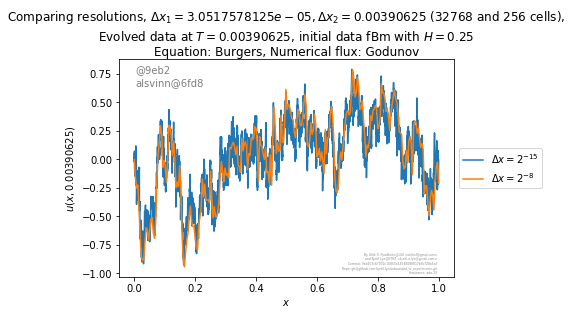

2019-04-26 21:40:15.218800 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.00390625, flux=godunov, equation=burgers
2019-04-26 21:40:21.828825 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml burgers godunov 0.00390625


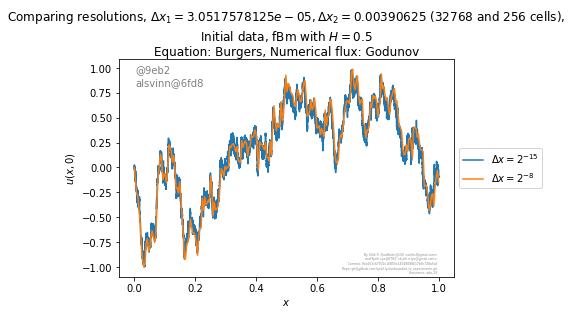

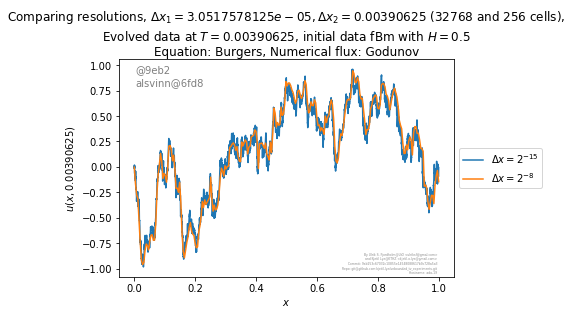

2019-04-26 21:40:27.748963 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_75/fractional_brownian.xml, T=0.00390625, flux=godunov, equation=burgers
2019-04-26 21:40:34.394368 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_75/fractional_brownian.xml burgers godunov 0.00390625


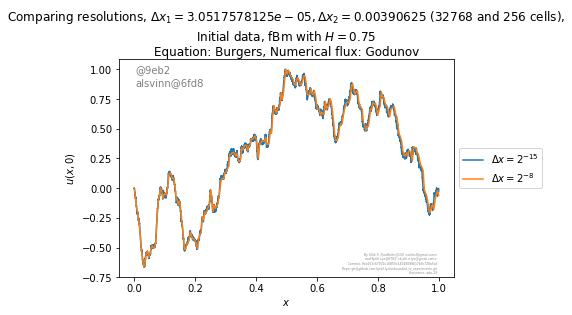

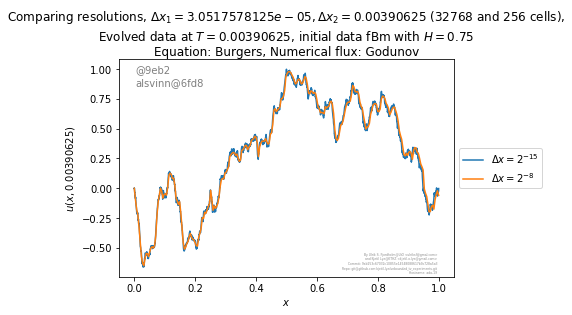

2019-04-26 21:40:40.477920 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.00390625, flux=roe, equation=burgers
2019-04-26 21:40:46.171998 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml burgers roe 0.00390625


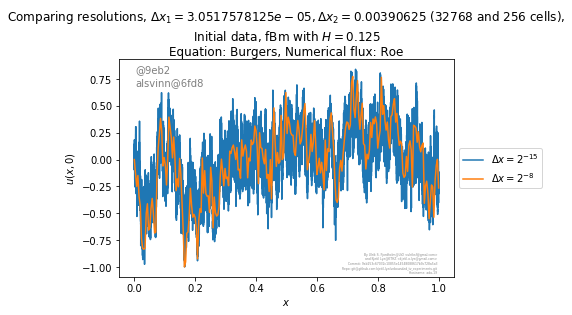

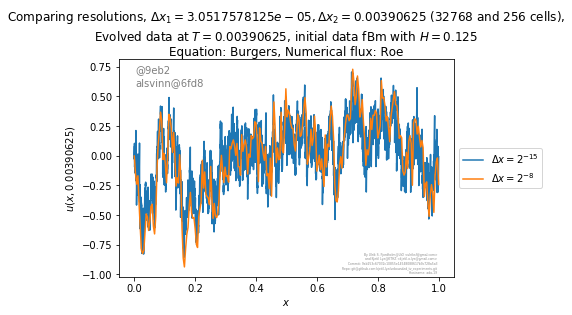

2019-04-26 21:40:53.093605 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.00390625, flux=roe, equation=burgers
2019-04-26 21:40:59.026149 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml burgers roe 0.00390625


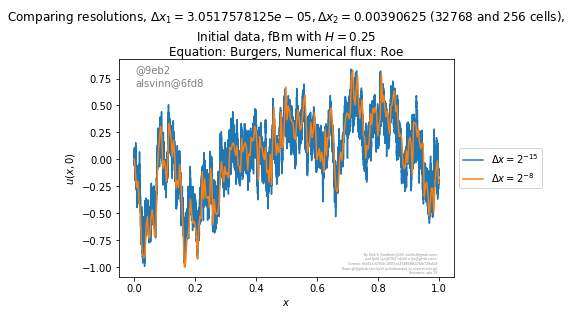

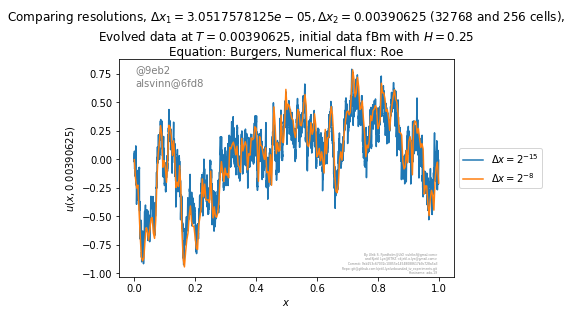

2019-04-26 21:41:05.342304 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.00390625, flux=roe, equation=burgers
2019-04-26 21:41:11.499929 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml burgers roe 0.00390625


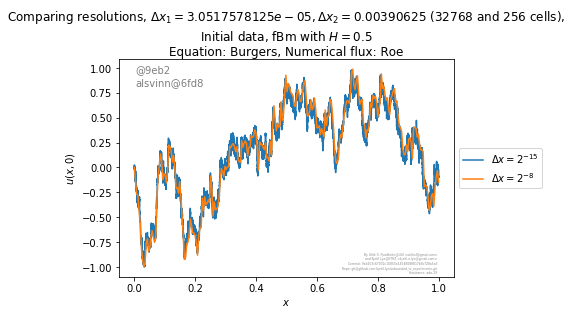

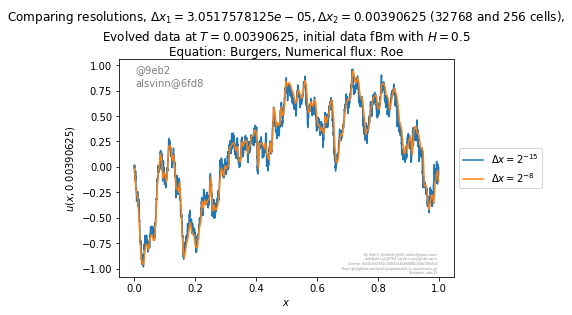

2019-04-26 21:41:17.644496 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_75/fractional_brownian.xml, T=0.00390625, flux=roe, equation=burgers
2019-04-26 21:41:23.817106 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_75/fractional_brownian.xml burgers roe 0.00390625


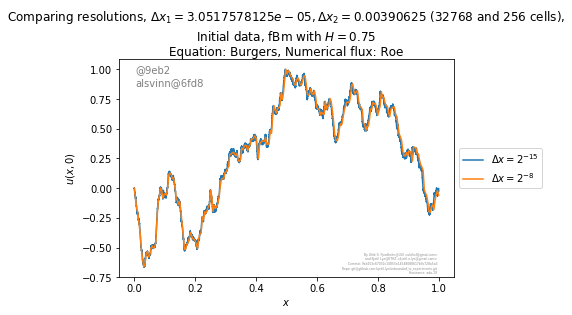

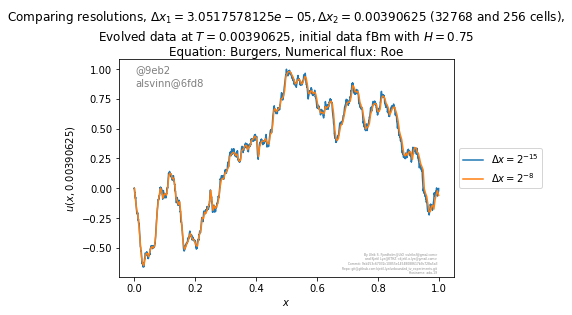

2019-04-26 21:41:29.530060 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.00390625, flux=rusanov, equation=cubic
2019-04-26 21:41:34.954711 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml cubic rusanov 0.00390625


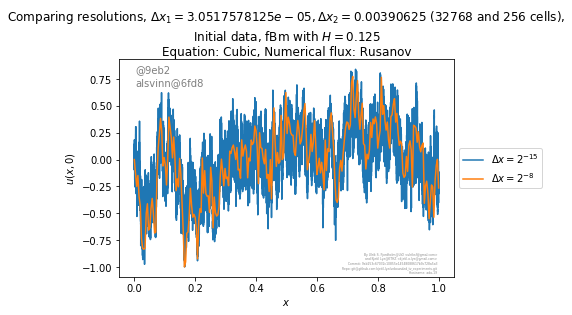

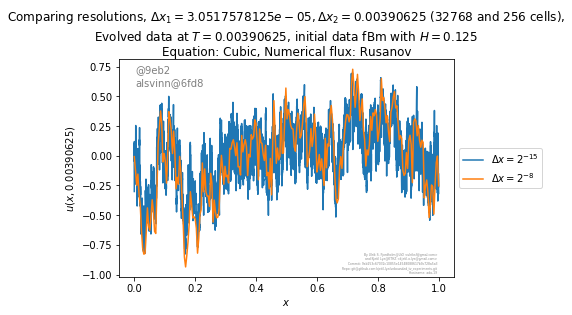

2019-04-26 21:41:42.156836 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.00390625, flux=rusanov, equation=cubic
2019-04-26 21:41:48.004660 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml cubic rusanov 0.00390625


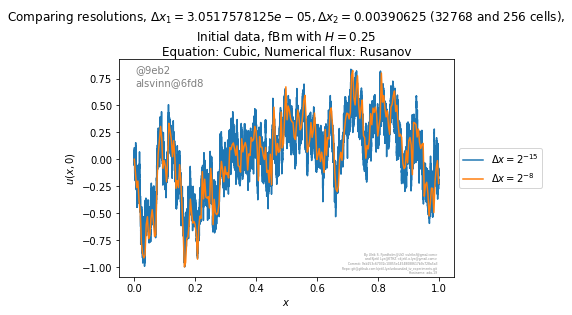

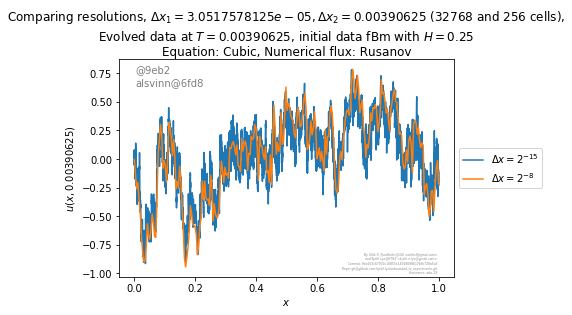

2019-04-26 21:41:54.534140 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.00390625, flux=rusanov, equation=cubic
2019-04-26 21:42:00.771395 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml cubic rusanov 0.00390625


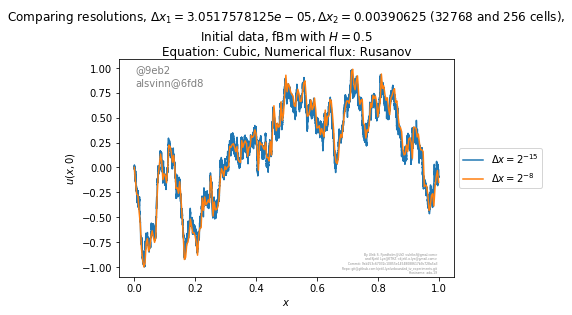

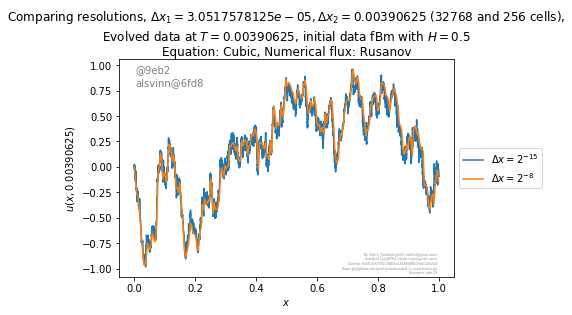

2019-04-26 21:42:07.065293 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_75/fractional_brownian.xml, T=0.00390625, flux=rusanov, equation=cubic
2019-04-26 21:42:13.344602 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_75/fractional_brownian.xml cubic rusanov 0.00390625


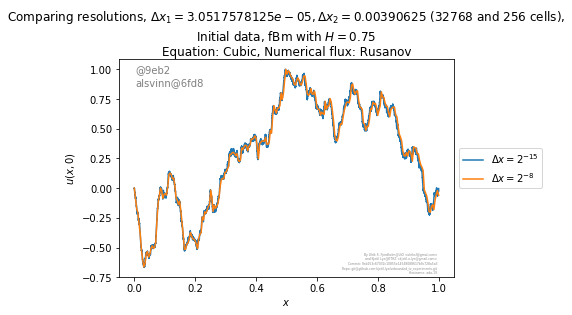

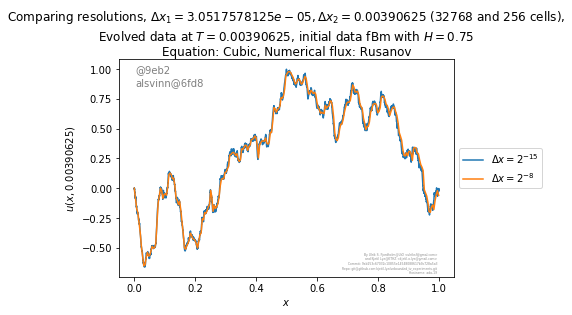

2019-04-26 21:42:18.960425 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.00390625, flux=roe, equation=cubic
2019-04-26 21:42:27.669636 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml cubic roe 0.00390625


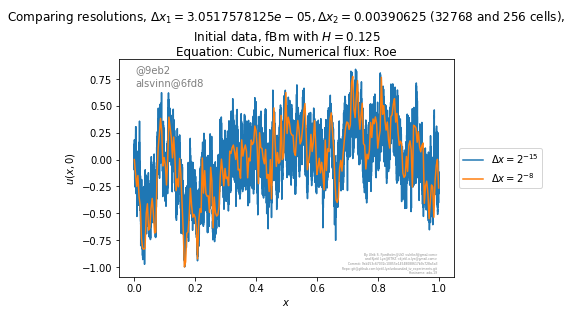

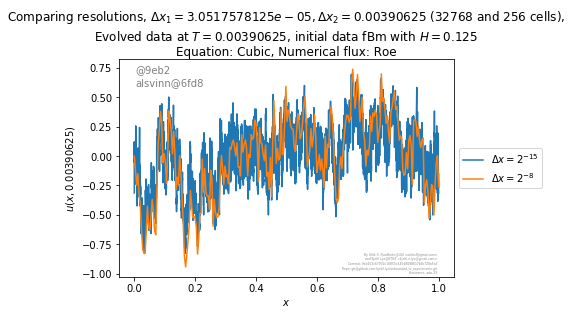

2019-04-26 21:42:34.839572 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.00390625, flux=roe, equation=cubic
2019-04-26 21:42:40.860009 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml cubic roe 0.00390625


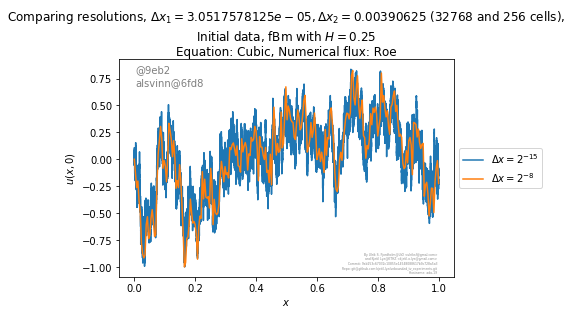

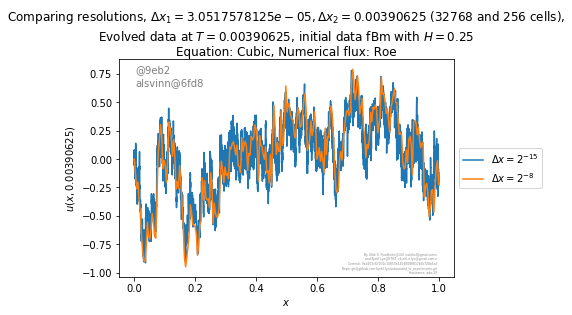

2019-04-26 21:42:47.635027 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.00390625, flux=roe, equation=cubic
2019-04-26 21:42:54.190621 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml cubic roe 0.00390625


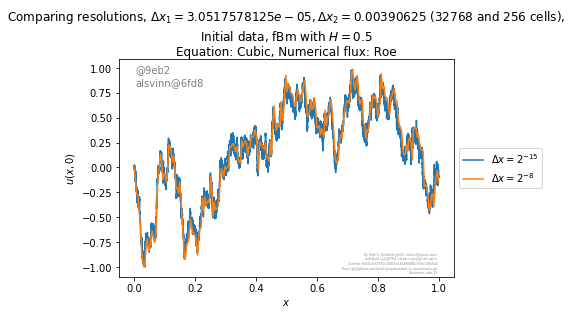

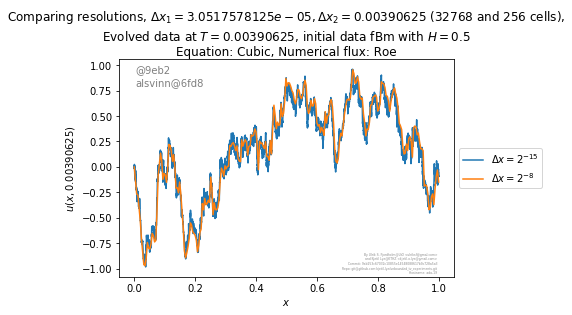

2019-04-26 21:43:00.052005 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_75/fractional_brownian.xml, T=0.00390625, flux=roe, equation=cubic
2019-04-26 21:43:06.604457 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_75/fractional_brownian.xml cubic roe 0.00390625


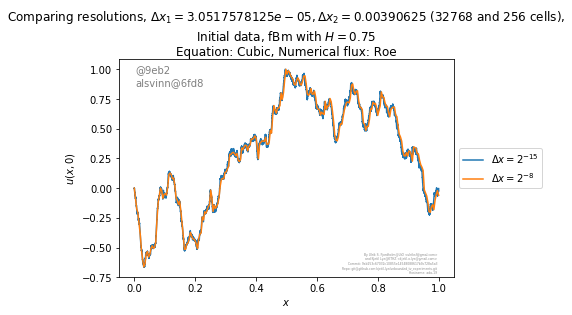

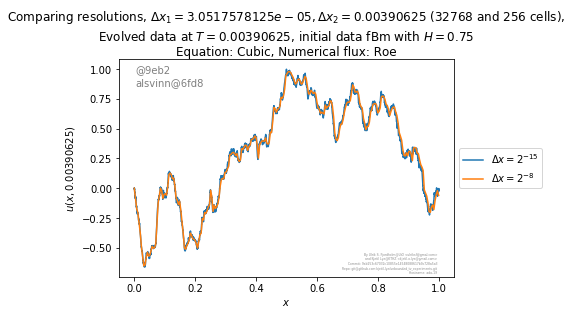

2019-04-26 21:43:12.495813 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.00390625, flux=rusanov, equation=linear
2019-04-26 21:43:18.110988 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml linear rusanov 0.00390625


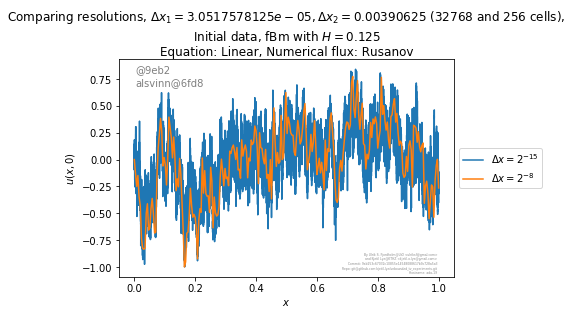

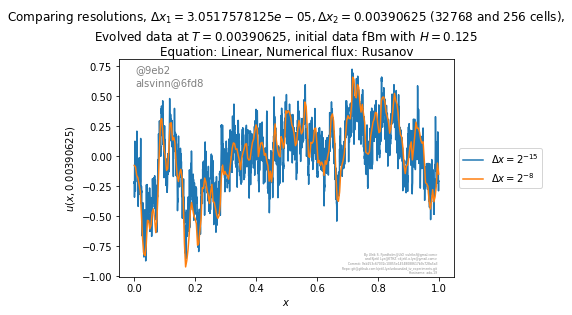

2019-04-26 21:43:24.876131 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.00390625, flux=rusanov, equation=linear
2019-04-26 21:43:33.785930 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml linear rusanov 0.00390625


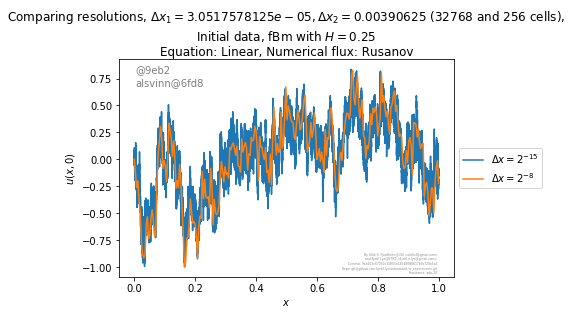

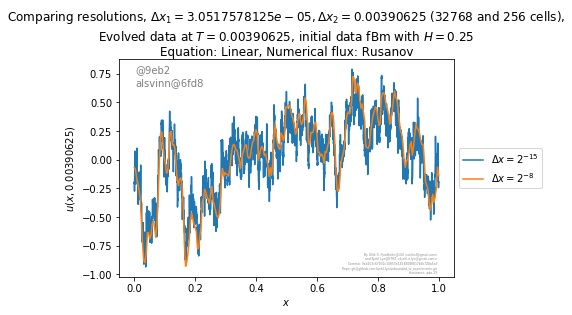

2019-04-26 21:43:40.073556 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.00390625, flux=rusanov, equation=linear
2019-04-26 21:43:45.614311 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml linear rusanov 0.00390625


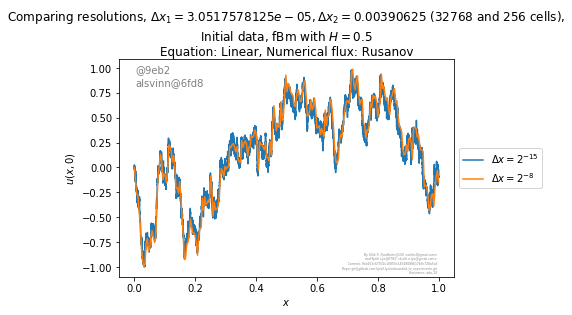

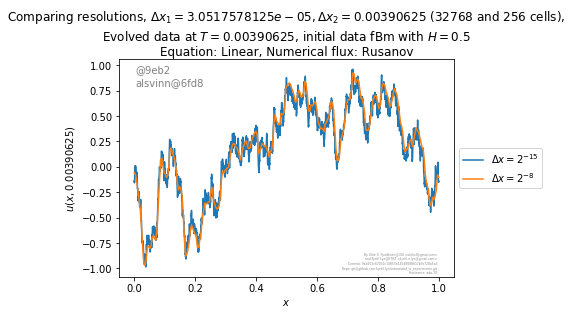

2019-04-26 21:43:51.422265 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_75/fractional_brownian.xml, T=0.00390625, flux=rusanov, equation=linear
2019-04-26 21:43:57.053043 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_75/fractional_brownian.xml linear rusanov 0.00390625


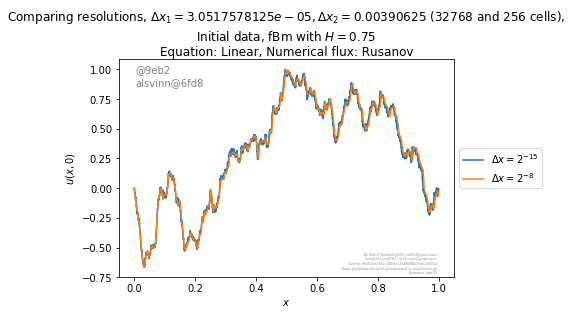

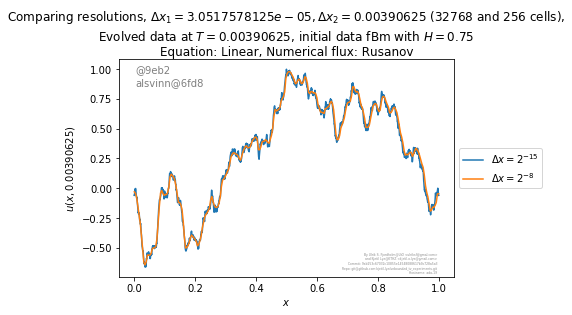

2019-04-26 21:44:02.647327 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.00390625, flux=upwind, equation=linear
2019-04-26 21:44:08.127874 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml linear upwind 0.00390625


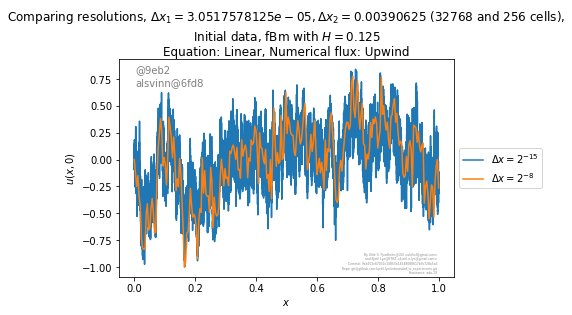

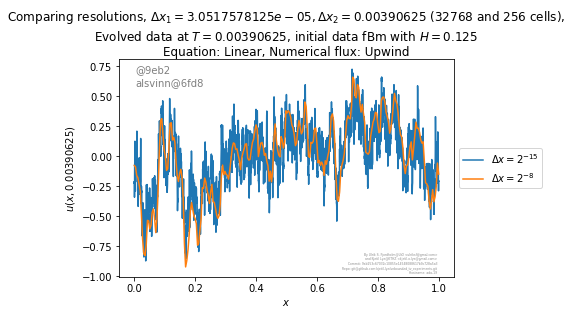

2019-04-26 21:44:14.781030 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.00390625, flux=upwind, equation=linear
2019-04-26 21:44:20.212927 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml linear upwind 0.00390625


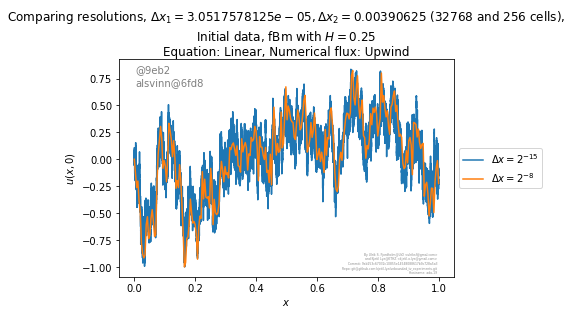

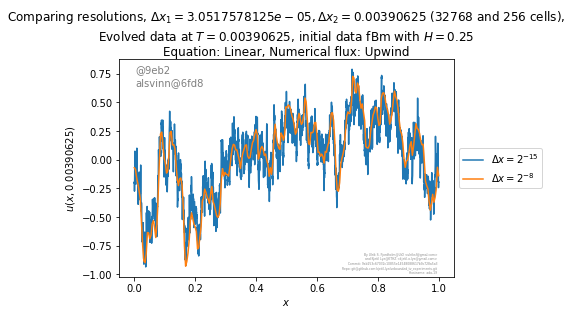

2019-04-26 21:44:26.451406 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.00390625, flux=upwind, equation=linear
2019-04-26 21:44:34.985623 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml linear upwind 0.00390625


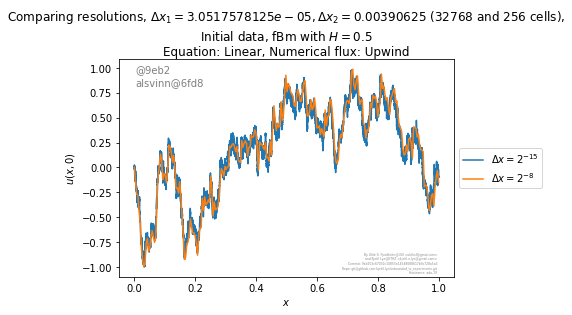

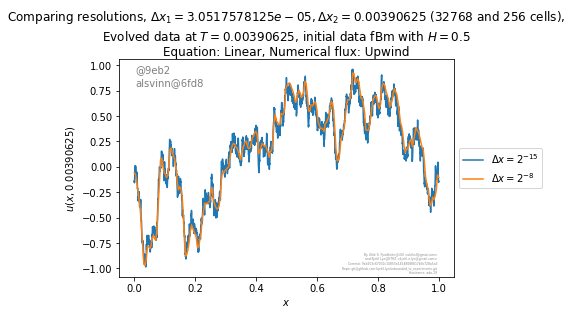

2019-04-26 21:44:40.931733 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_75/fractional_brownian.xml, T=0.00390625, flux=upwind, equation=linear
2019-04-26 21:44:47.374674 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_75/fractional_brownian.xml linear upwind 0.00390625


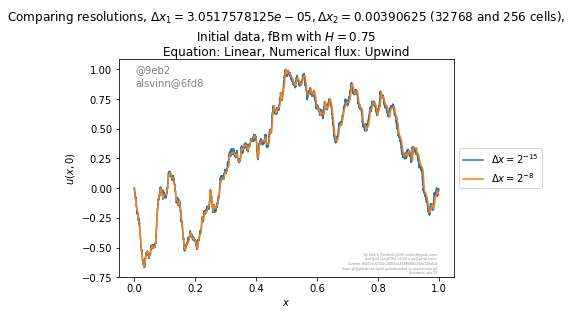

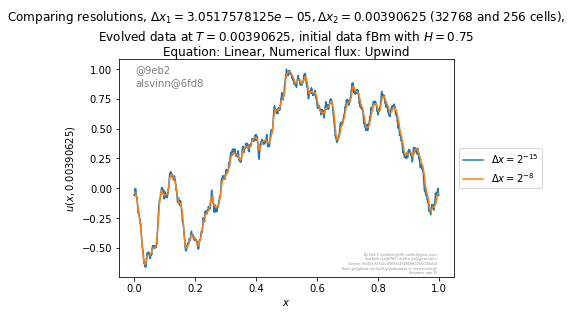

2019-04-26 21:44:52.975849 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=1, flux=rusanov, equation=burgers
2019-04-26 21:51:19.833907 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml burgers rusanov 1


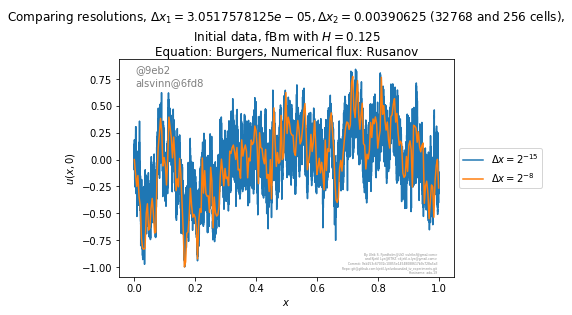

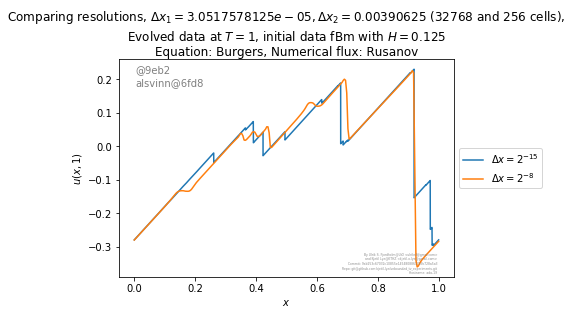

2019-04-26 21:51:26.370910 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=1, flux=rusanov, equation=burgers
2019-04-26 21:59:50.260747 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml burgers rusanov 1


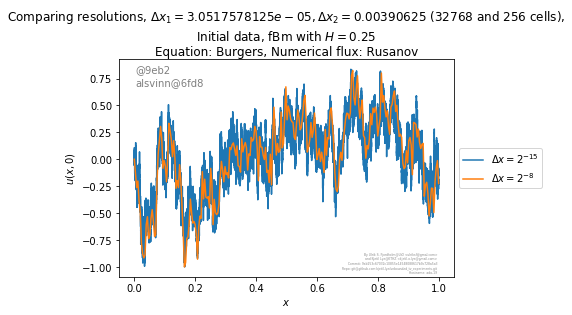

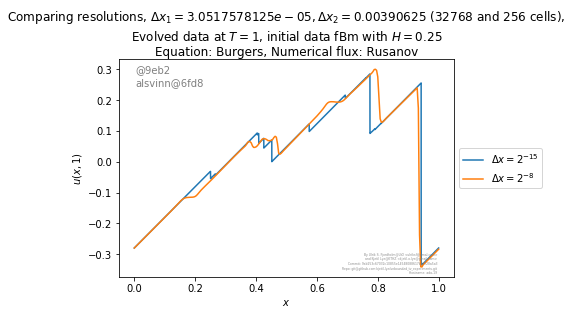

2019-04-26 21:59:56.430323 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=1, flux=rusanov, equation=burgers
2019-04-26 22:11:28.830393 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml burgers rusanov 1


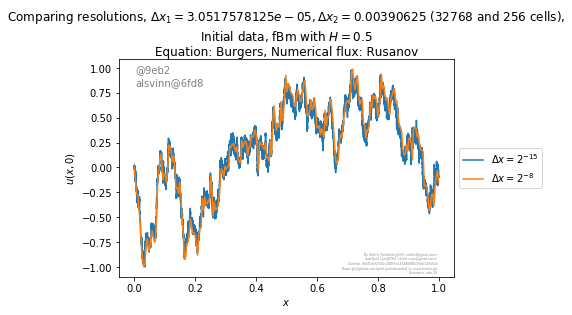

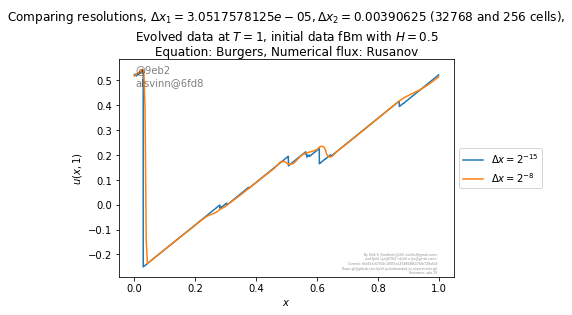

2019-04-26 22:11:34.496521 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_75/fractional_brownian.xml, T=1, flux=rusanov, equation=burgers
2019-04-26 22:24:22.564716 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_75/fractional_brownian.xml burgers rusanov 1


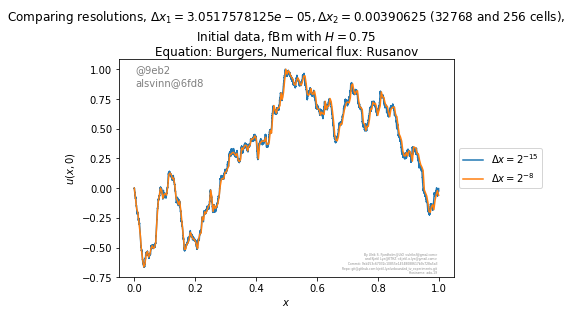

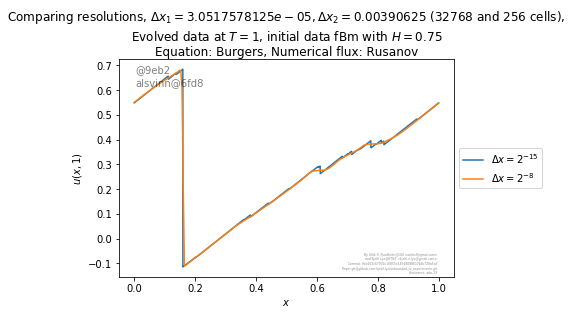

2019-04-26 22:24:28.252625 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=1, flux=godunov, equation=burgers
2019-04-26 22:32:16.240590 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml burgers godunov 1


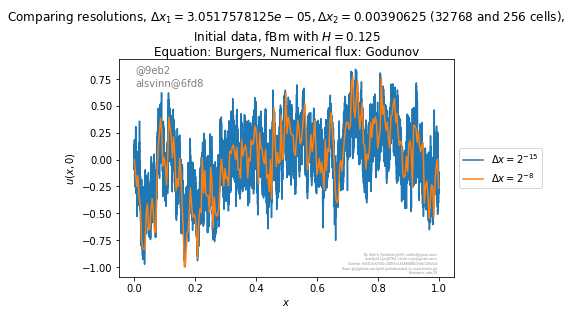

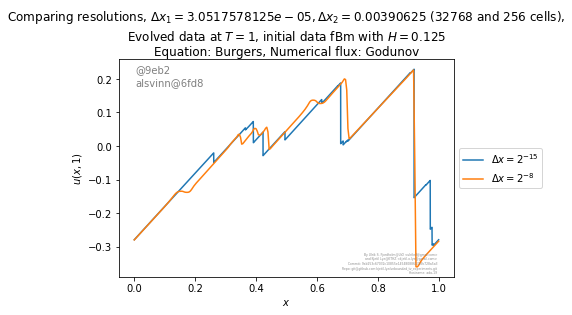

2019-04-26 22:32:22.631442 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=1, flux=godunov, equation=burgers
2019-04-26 22:42:24.950481 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml burgers godunov 1


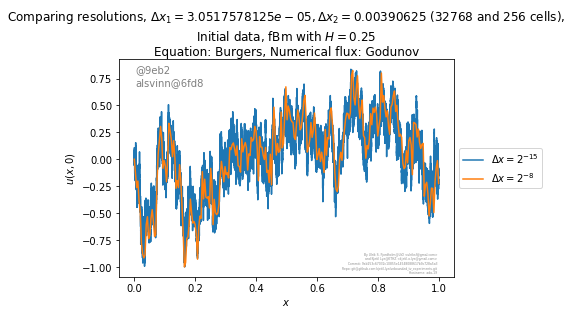

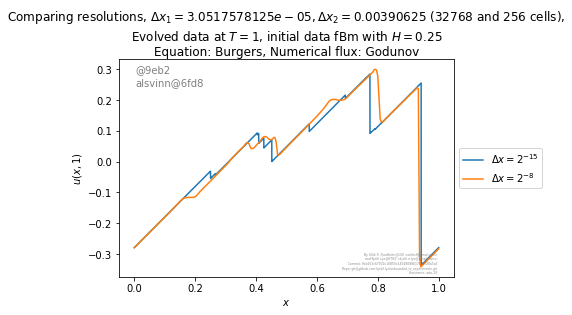

2019-04-26 22:42:31.172657 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=1, flux=godunov, equation=burgers
2019-04-26 22:56:18.589948 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml burgers godunov 1


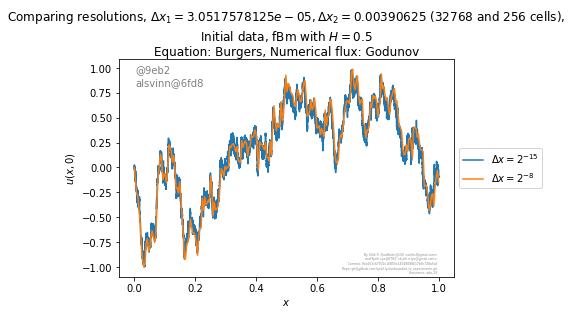

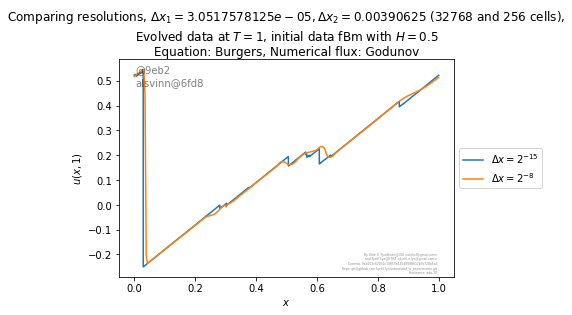

2019-04-26 22:56:24.279572 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_75/fractional_brownian.xml, T=1, flux=godunov, equation=burgers
2019-04-26 23:11:51.031822 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_75/fractional_brownian.xml burgers godunov 1


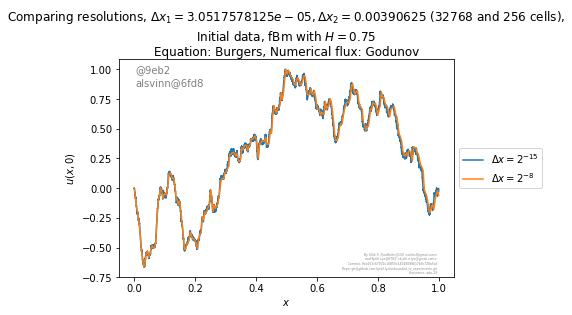

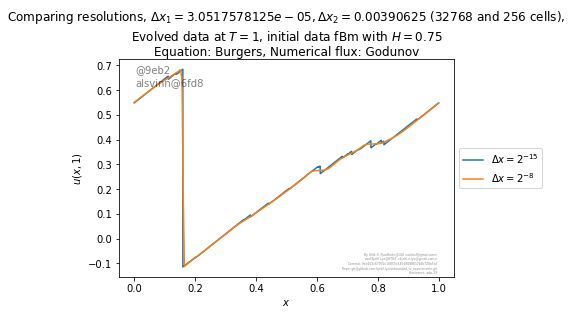

2019-04-26 23:11:56.752537 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=1, flux=roe, equation=burgers
2019-04-26 23:18:43.623395 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml burgers roe 1


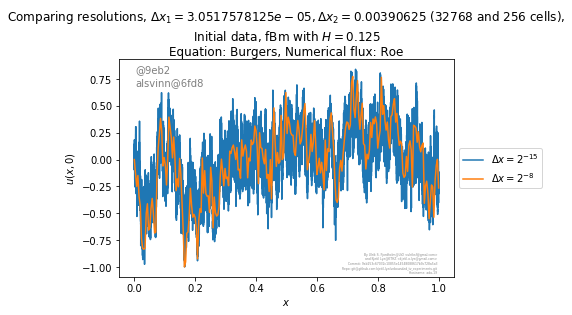

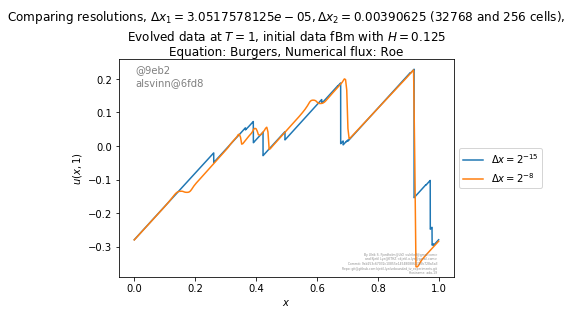

2019-04-26 23:18:50.004526 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=1, flux=roe, equation=burgers
2019-04-26 23:27:51.377274 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml burgers roe 1


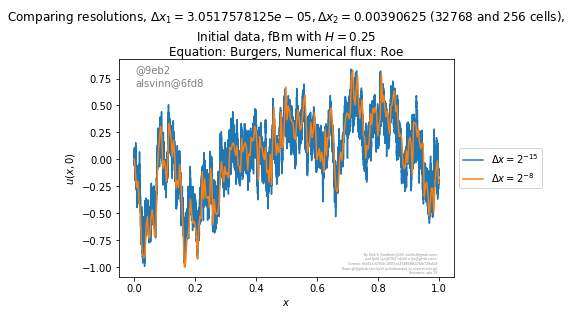

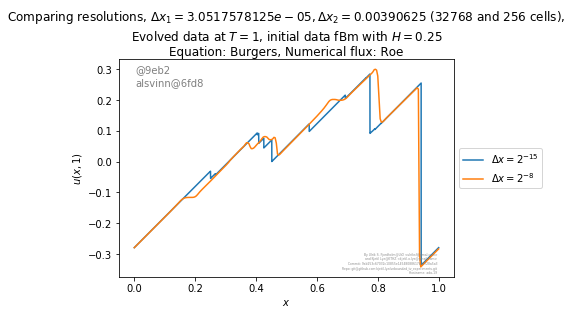

2019-04-26 23:27:57.493182 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=1, flux=roe, equation=burgers
2019-04-26 23:40:27.465292 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml burgers roe 1


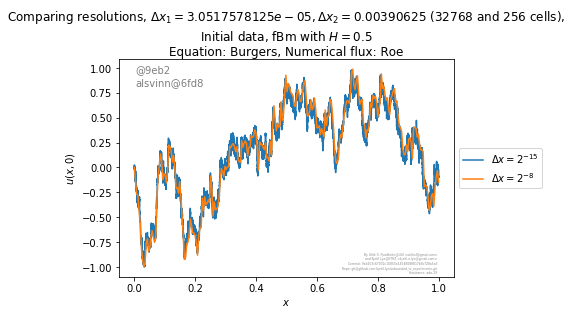

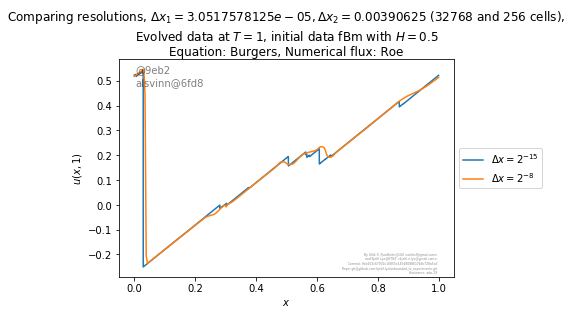

2019-04-26 23:40:33.152705 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_75/fractional_brownian.xml, T=1, flux=roe, equation=burgers
2019-04-26 23:54:10.988908 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_75/fractional_brownian.xml burgers roe 1


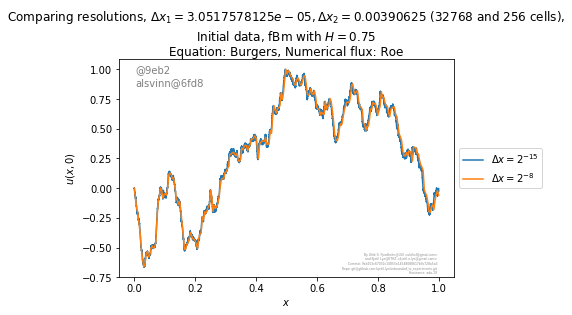

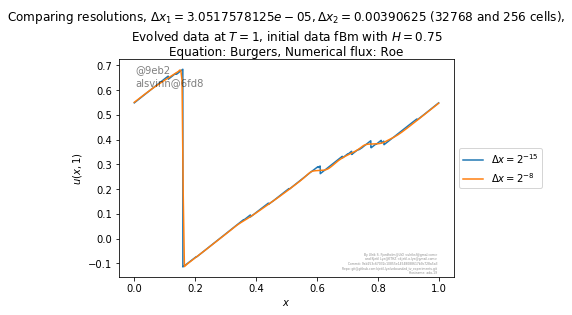

2019-04-26 23:54:16.864526 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=1, flux=rusanov, equation=cubic
2019-04-26 23:58:19.164823 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml cubic rusanov 1


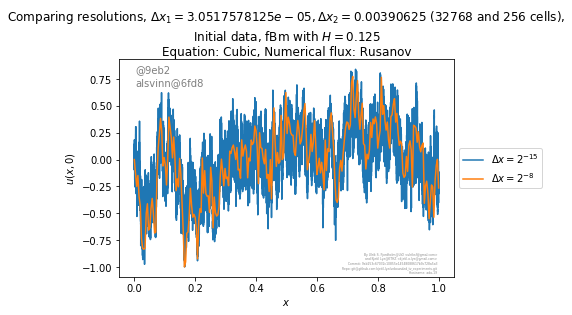

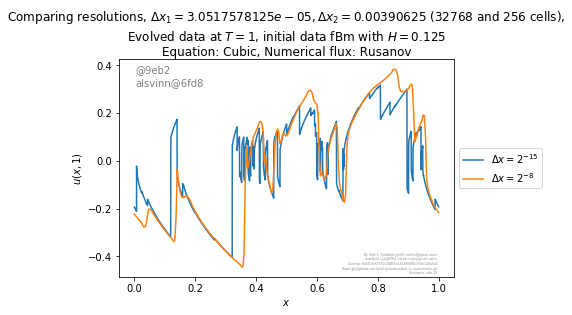

2019-04-26 23:58:26.166168 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=1, flux=rusanov, equation=cubic
2019-04-27 00:04:41.796535 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml cubic rusanov 1


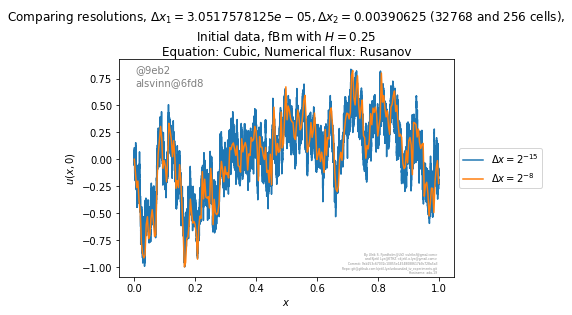

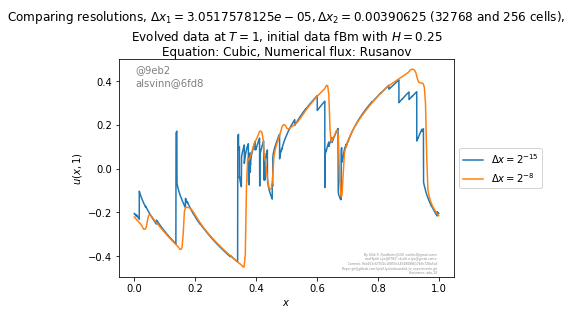

2019-04-27 00:04:47.880681 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=1, flux=rusanov, equation=cubic
2019-04-27 00:14:38.906473 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml cubic rusanov 1


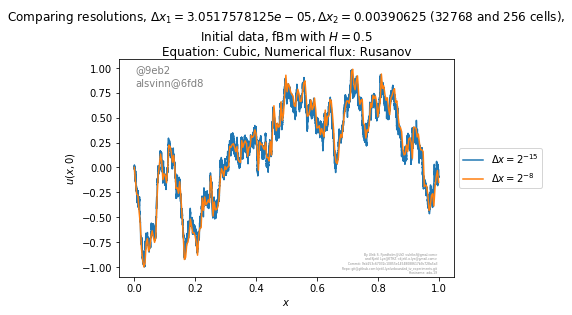

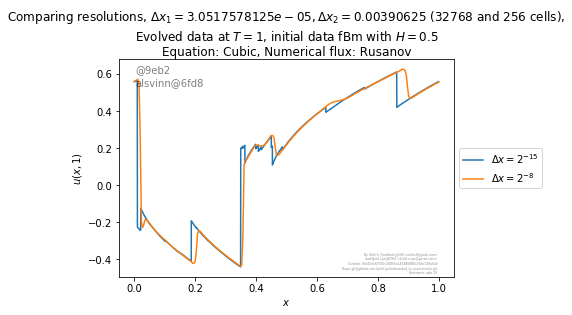

2019-04-27 00:14:44.584815 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_75/fractional_brownian.xml, T=1, flux=rusanov, equation=cubic
2019-04-27 00:27:03.194605 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_75/fractional_brownian.xml cubic rusanov 1


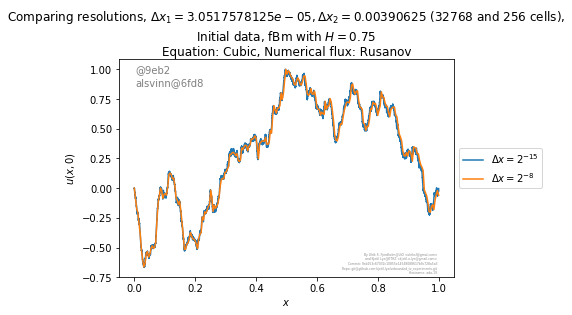

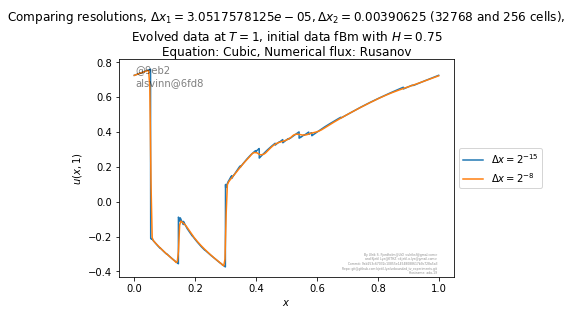

2019-04-27 00:27:08.737456 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=1, flux=roe, equation=cubic
2019-04-27 00:31:36.131631 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml cubic roe 1


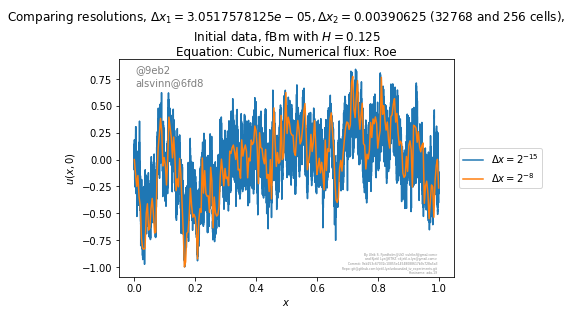

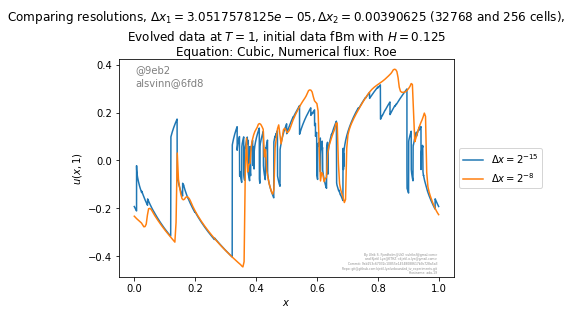

2019-04-27 00:31:42.730070 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=1, flux=roe, equation=cubic
2019-04-27 00:39:08.829646 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml cubic roe 1


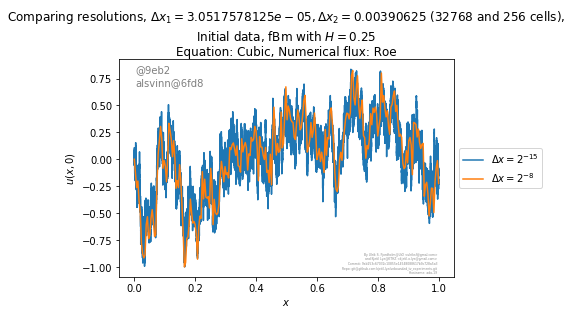

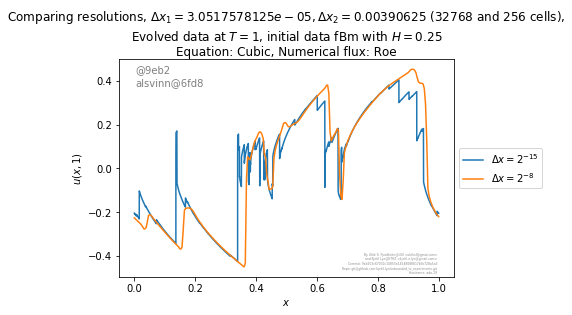

2019-04-27 00:39:14.781343 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=1, flux=roe, equation=cubic
2019-04-27 00:55:22.902089 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml cubic roe 1


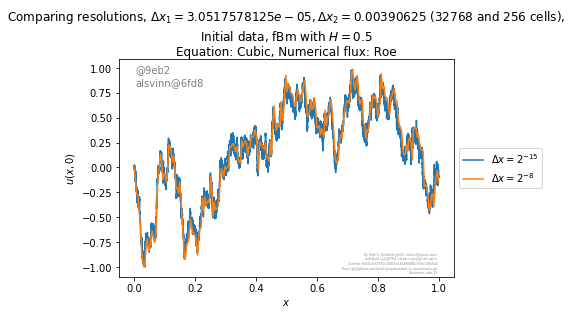

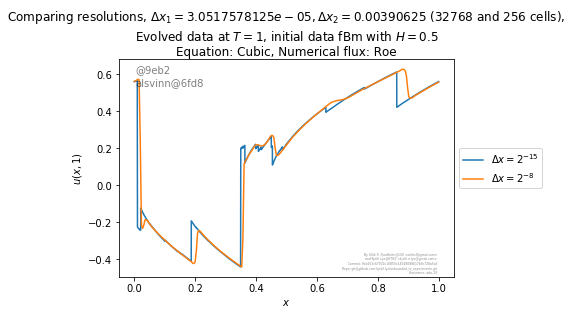

2019-04-27 00:55:28.585265 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_75/fractional_brownian.xml, T=1, flux=roe, equation=cubic
2019-04-27 01:08:31.704840 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_75/fractional_brownian.xml cubic roe 1


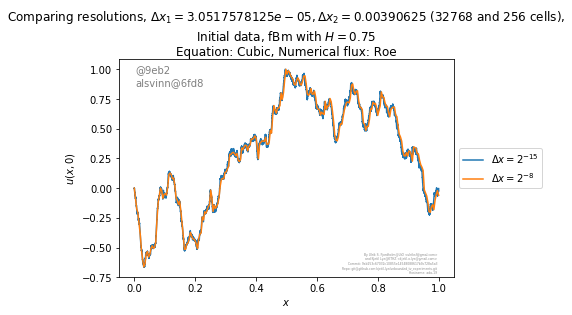

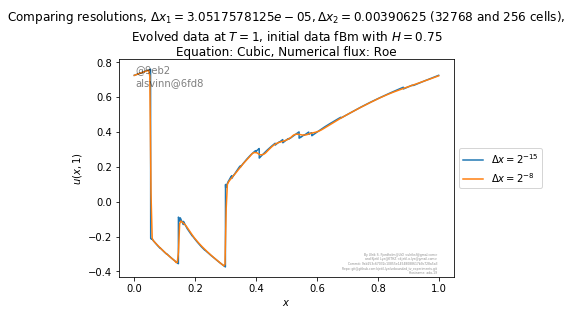

2019-04-27 01:08:37.142837 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=1, flux=rusanov, equation=linear
2019-04-27 01:20:57.122276 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml linear rusanov 1


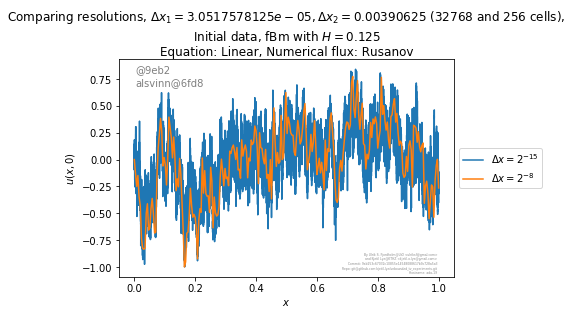

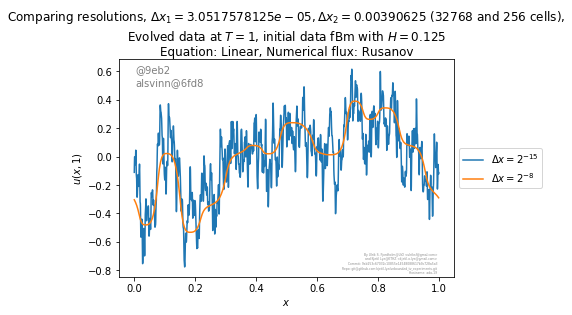

2019-04-27 01:21:03.725543 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=1, flux=rusanov, equation=linear
2019-04-27 01:33:20.059548 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml linear rusanov 1


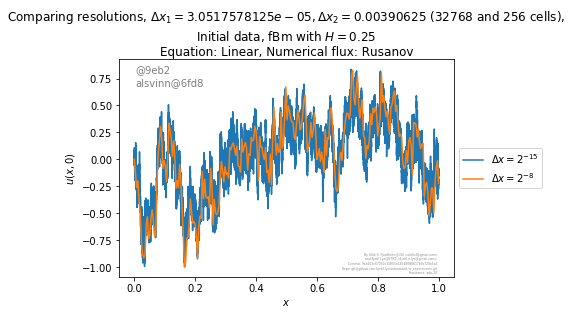

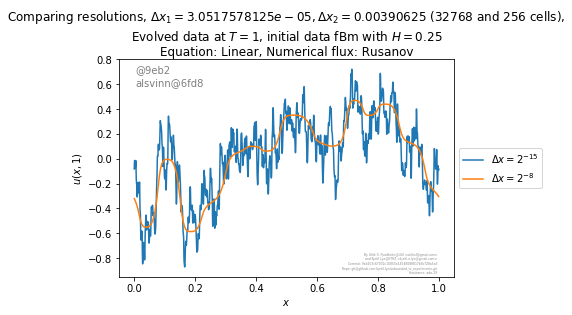

2019-04-27 01:33:26.148813 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=1, flux=rusanov, equation=linear
2019-04-27 01:45:42.534148 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml linear rusanov 1


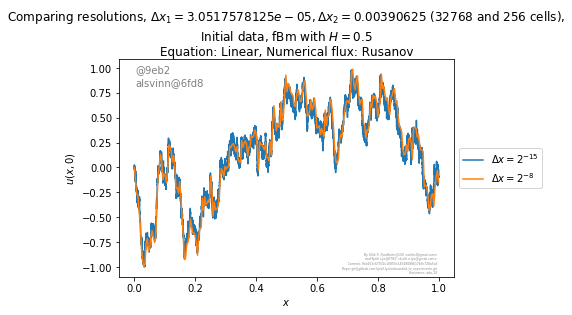

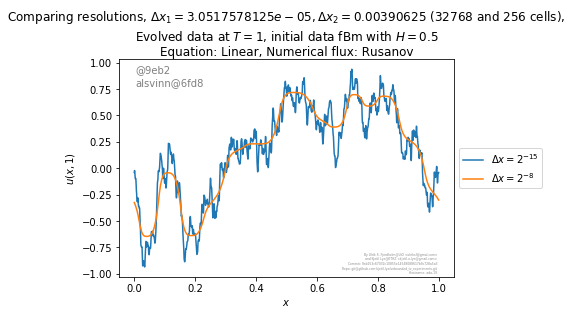

2019-04-27 01:45:48.387508 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_75/fractional_brownian.xml, T=1, flux=rusanov, equation=linear
2019-04-27 01:58:17.321041 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_75/fractional_brownian.xml linear rusanov 1


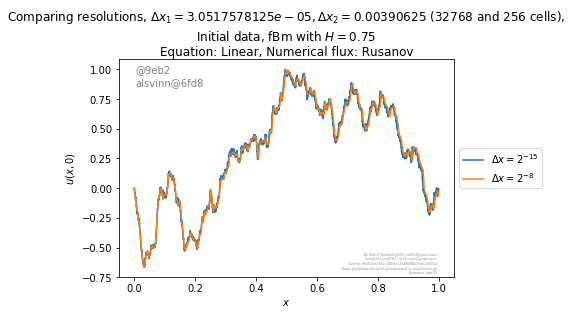

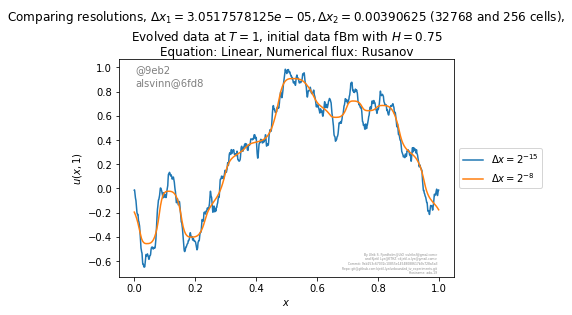

2019-04-27 01:58:23.044335 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=1, flux=upwind, equation=linear
2019-04-27 02:10:12.487708 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml linear upwind 1


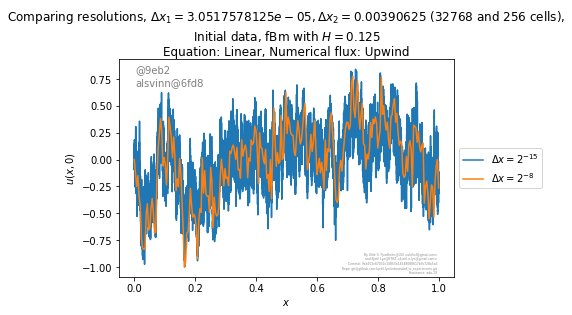

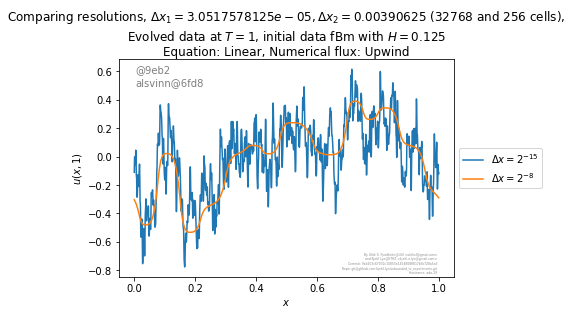

2019-04-27 02:10:19.100155 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=1, flux=upwind, equation=linear
2019-04-27 02:22:13.357030 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml linear upwind 1


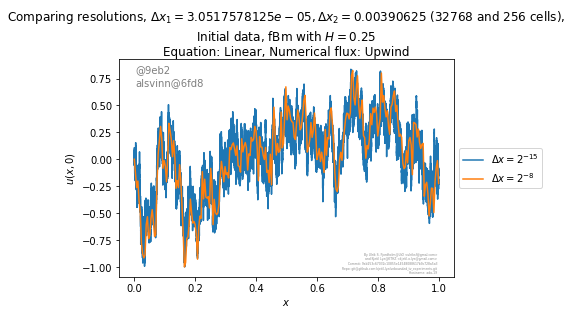

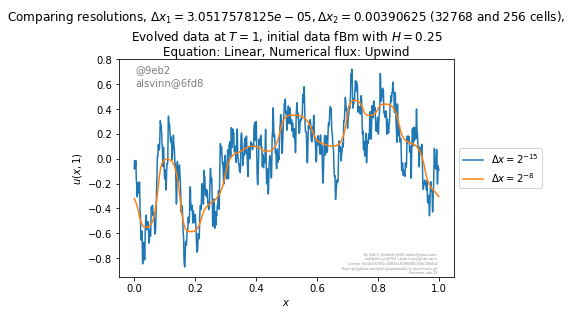

2019-04-27 02:22:19.402025 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=1, flux=upwind, equation=linear
2019-04-27 02:34:30.521945 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml linear upwind 1


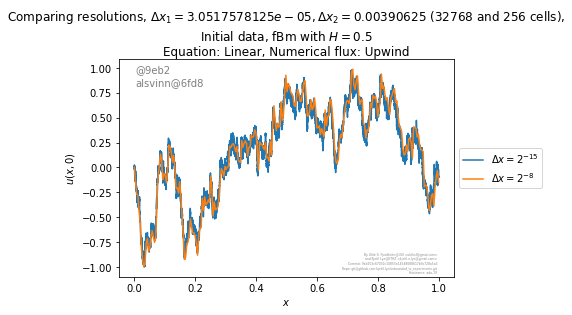

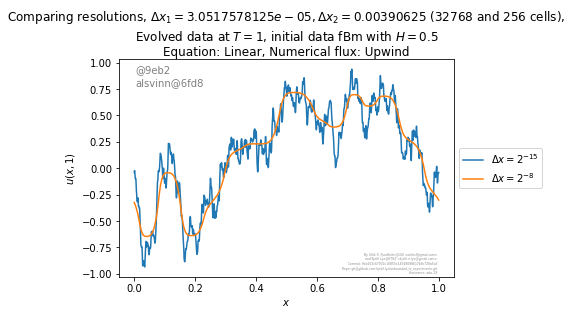

2019-04-27 02:34:36.270461 (in plot_solution_at_two_resolutions): Running plot_solution_at_two_resolutions for ../configs/fractional_brownian_0_75/fractional_brownian.xml, T=1, flux=upwind, equation=linear
2019-04-27 02:46:32.724916 (in plot_solution_at_two_resolutions): Done configuration ../configs/fractional_brownian_0_75/fractional_brownian.xml linear upwind 1


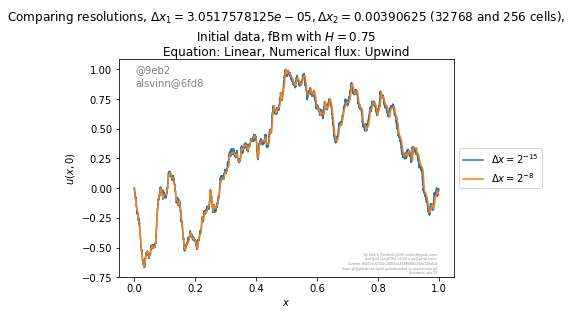

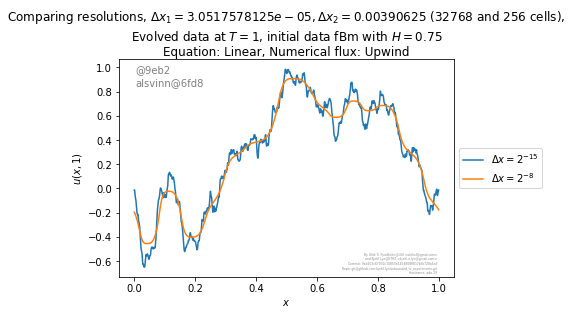

In [18]:
def run_fbm_plot_compare(equation, numerical_flux, exact_solution, T):
    Hs = [0.125, 0.25, 0.5, 0.75]

    base_xml_format_string = '../configs/fractional_brownian_{H_filename}/fractional_brownian.xml'

    M1 = COMPUTATIONAL_BUDGET
    M2 = 256
    for H in Hs:
        base_xml = base_xml_format_string.format(H_filename = str(H).replace(".","_"))
        
        name = "fBm $H={H}$".format(H=H)
        plot_solution_at_two_resolutions(base_xml, name, T, M1, M2, numerical_flux=numerical_flux,
                   equation=equation, exact_solution_class=exact_solution)
        plt.figure(0)
        plt.title("Comparing resolutions, $\\Delta x_1={dx1}, \\Delta x_2={dx2}$ ({M1} and {M2} cells),\nInitial data, fBm with $H={hurz}$\nEquation: {equation}, Numerical flux: {numerical_flux}"\
              .format(hurz=H, equation=equation.capitalize(), numerical_flux=numerical_flux.capitalize(),
                      dx1=1.0/M1, dx2=1.0/M2, M1=M1, M2=M2))
        plot_info.legendLeft()
        plot_info.savePlot("fbm_initial_compare_{equation}_{H}_{numerical_flux}"
                .format(equation=equation, H=str(H).replace(".", "_"), numerical_flux=numerical_flux))
        
        plt.figure(1)
        plt.title("Comparing resolutions, $\\Delta x_1={dx1}, \\Delta x_2={dx2}$ ({M1} and {M2} cells),\nEvolved data at $T={T}$, initial data fBm with $H={hurz}$\nEquation: {equation}, Numerical flux: {numerical_flux}"\
              .format(hurz=H, equation=equation.capitalize(), numerical_flux=numerical_flux.capitalize(), 
                      T=T, dx1=1.0/M1, dx2=1./M2, M1=M1, M2=M2))
        plot_info.legendLeft()
                        
        plot_info.savePlot("fbm_evolved_compare_{equation}_{numerical_flux}_{T}_{H}"
                .format(equation=equation, numerical_flux=numerical_flux, 
                        T=str(T).replace(".", "_"),
                        H=str(H).replace(".", "_")))
        plt.show()
        
for T in [1/256., 1]:
    run_all_configurations(run_fbm_plot_compare, T)

In [19]:
def run_average_convergence(base_xml, title, T, number_of_samples,
                    exact_solution_class=None,
                    numerical_flux="rusanov",
                    equation="burgers"):
    
    plot_info.console_log_show("Running run_average_convergence for {}, T={}, flux={}, equation={}".format(base_xml,
                                                                                                 T,
                                                                                                numerical_flux,
                                                                                                equation))

    resolutions = 2**np.arange(START_CONVERGENCE_UQ_LOG, END_CONVERGENCE_UQ_LOG+2)
    errors = []
    errors_max = []
    errors_min = []
    errors_var = []
    
    
    
    ## Make sample solution
    sample_solution_run = alsvinn.run(name="sample_solution",
        base_xml=base_xml,
        number_of_saves=1,
        dimension=[SAMPLE_SOLUTION_FACTOR*resolutions[-1],1,1],
        flux=numerical_flux,
        equation=equation,
        samples = number_of_samples,
        uq=True, # notice that since we have Brownian initial data, we need to enable uq
        T=T)
    
    
    
    
    ## Loop over resolutions
    for r in resolutions:
        ## Just some progress output, can be deleted
        sys.stdout.write("Resolution = {}\r".format(r))
        sys.stdout.flush()
        
        ## This is where we run alsvinn for the given resolution
        run = alsvinn.run(name="convergence_run",
                         base_xml=base_xml,
                         number_of_saves=1,
                         dimension=[r,1,1],
                         flux=numerical_flux,
                         equation=equation,
                         samples = number_of_samples,
                         uq=True, # notice that since we have Brownian initial data, we need to enable uq
                         T=T)
        errors_at_resolutions = []

        for sample in range(number_of_samples):
            if exact_solution_class is None:
                sample_solution = sample_solution_run.get_data("u", 1,sample=sample)
            else:
                initial_data = sample_solution_run.get_data("u", 0,sample=sample)
    
                exact_solution_object = exact_solution_class(initial_data)
        
                sample_solution = exact_solution_object(T)
        
            r_sample = sample_solution.shape[0]
        
            u_approx = run.get_data("u", 1, sample=sample)
        
            u_approx_upscaled = np.repeat(u_approx, r_sample//r)
        
            ## Compute L^1 error
            errors_at_resolutions.append(np.sum(abs(u_approx_upscaled-sample_solution))/r_sample)
        errors.append(np.mean(errors_at_resolutions))
        errors_max.append(max(errors_at_resolutions))
        errors_min.append(min(errors_at_resolutions))
        errors_var.append(np.var(errors_at_resolutions))
    errors = np.array(errors)
    errors_var=np.array(errors_var)
    sys.stdout.write("\r")
    plt.figure(0)
    ## Plot results, enable basex=2 to get nicer x axis
    line_info = plt.errorbar(resolutions, errors, yerr=np.sqrt(errors_var),
                           label=title, barsabove=True)
    plt.gca().set_xscale("log", nonposx='clip',basex=2)
    plt.gca().set_yscale("log", nonposy='clip',basey=2)

    plt.grid(True)
    
    poly = np.polyfit(np.log(resolutions), np.log(errors), 1)
    plt.loglog(resolutions, np.exp(poly[1])*resolutions**poly[0], '--', 
               color=line_info[0].get_color(), 
               label='$\\mathcal{O}(M^{%.2f})$' % poly[0],
              basex=2, basey=2)
    plt.legend()
    
    
    
    plt.xlabel("Number of cells ($M$)")
    plt.ylabel("Expectation of Error ($\\mathbb{E}(||\\cdot||_{L^1([0,1])})$)")
    plt.legend()
    
    
    plt.figure(1)
    ## Plot results, enable basex=2 to get nicer x axis
    line_info = plt.errorbar(1.0/resolutions, errors, yerr=np.sqrt(errors_var),
                           label=title, barsabove=True)
    plt.grid(True)
    
    poly = np.polyfit(np.log(1.0/resolutions), np.log(errors), 1)
    plt.loglog(1.0/resolutions, np.exp(poly[1])*resolutions**(-poly[0]), '--', 
               color=line_info[0].get_color(), 
               label='$\\mathcal{O}(\\Delta x^{%.2f})$' % poly[0],
              basex=2, basey=2)
    plt.legend()
    
    plt.xlabel("$\\Delta x$")
    plt.ylabel("Expectation of Error ($\\mathbb{E}(||\\cdot||_{L^1([0,1])})$)")
    plt.legend()
    
    
    plt.figure(2)
    ## Plot results, enable basex=2 to get nicer x axis
    line_info = plt.errorbar(1.0/resolutions, errors,  yerr=np.sqrt(errors_var),
                           label=title, barsabove=True)
    plt.grid(True)
    
    poly = np.polyfit(np.log(1.0/resolutions), np.log(-errors/np.log(1/resolutions)), 1)
    plt.loglog(1.0/resolutions, -np.log(1/resolutions)*np.exp(poly[1])*resolutions**(-poly[0]), '--', 
               color=line_info[0].get_color(), 
               label='$\\mathcal{O}(-\\log(\\Delta x)\\Delta x^{%.2f})$' % poly[0],
              basex=2, basey=2)
    plt.legend()
    
    plt.xlabel("$\\Delta x$")
    plt.ylabel("Expectation of Error ($\\mathbb{E}(||\\cdot||_{L^1([0,1])})$)")
    plt.legend()
   

   
    
    
    
    
    
    plot_info.console_log_show("Done configuration {} {} {} {}".format(base_xml, equation, numerical_flux, T))
    
        

2019-04-27 02:46:38.612736 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.00048828125, flux=rusanov, equation=burgers
2019-04-27 03:07:57.558202 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml burgers rusanov 0.00048828125
2019-04-27 03:07:57.581385 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.00048828125, flux=rusanov, equation=burgers
2019-04-27 03:29:26.900255 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml burgers rusanov 0.00048828125
2019-04-27 03:29:26.927273 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.00048828125, flux=rusanov, equation=burgers
2019-04-27 03:50:48.070310 (in run_average_convergence): Done

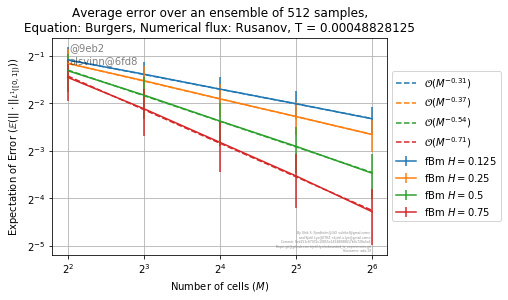

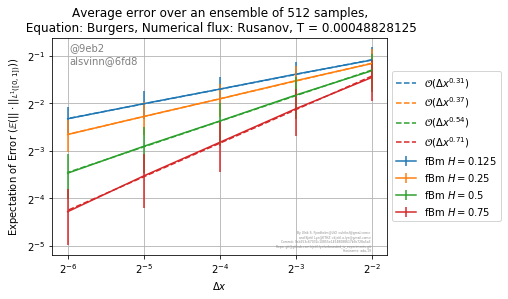

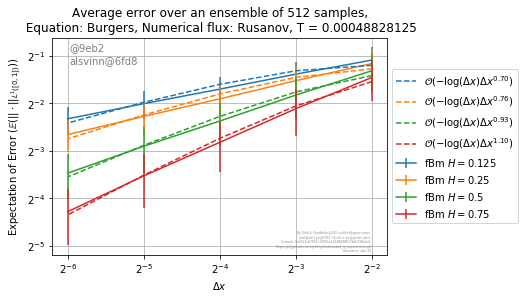

2019-04-27 04:12:20.722175 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.00048828125, flux=godunov, equation=burgers
2019-04-27 04:33:40.280369 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml burgers godunov 0.00048828125
2019-04-27 04:33:40.312047 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.00048828125, flux=godunov, equation=burgers
2019-04-27 04:54:59.893274 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml burgers godunov 0.00048828125
2019-04-27 04:54:59.915432 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.00048828125, flux=godunov, equation=burgers
2019-04-27 05:16:21.627590 (in run_average_convergence): Done

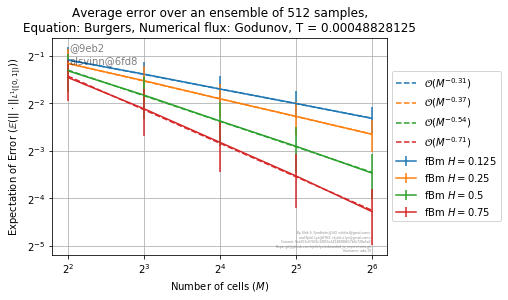

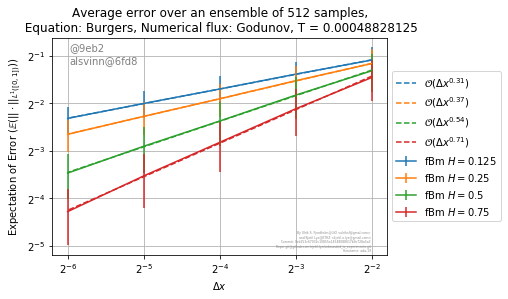

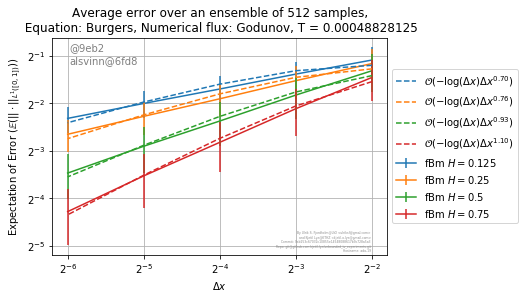

2019-04-27 05:37:52.766647 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.00048828125, flux=roe, equation=burgers
2019-04-27 05:59:14.357584 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml burgers roe 0.00048828125
2019-04-27 05:59:14.378854 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.00048828125, flux=roe, equation=burgers
2019-04-27 06:20:36.281153 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml burgers roe 0.00048828125
2019-04-27 06:20:36.304357 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.00048828125, flux=roe, equation=burgers
2019-04-27 06:41:54.121599 (in run_average_convergence): Done configuration ../co

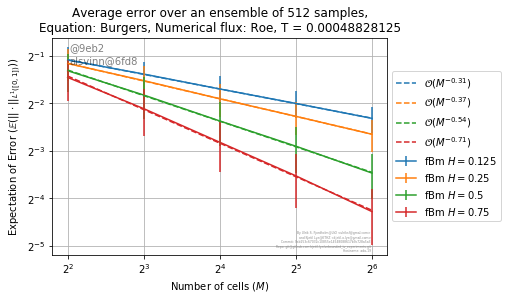

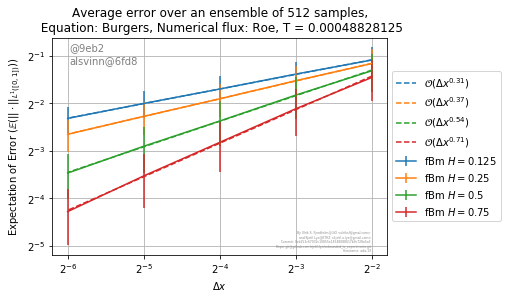

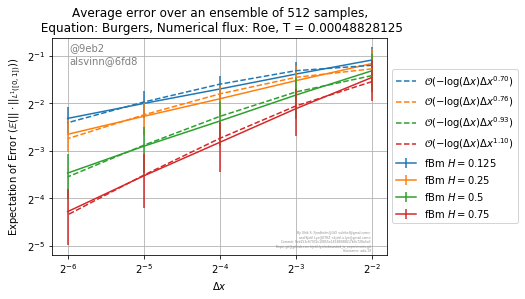

2019-04-27 07:03:29.709971 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.00048828125, flux=rusanov, equation=cubic
2019-04-27 07:24:49.842058 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml cubic rusanov 0.00048828125
2019-04-27 07:24:49.863801 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.00048828125, flux=rusanov, equation=cubic
2019-04-27 07:46:08.794991 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml cubic rusanov 0.00048828125
2019-04-27 07:46:08.818715 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.00048828125, flux=rusanov, equation=cubic
2019-04-27 08:07:26.092203 (in run_average_convergence): Done configura

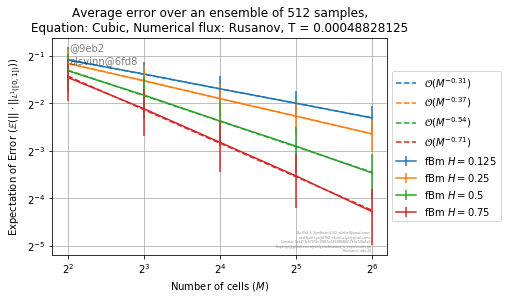

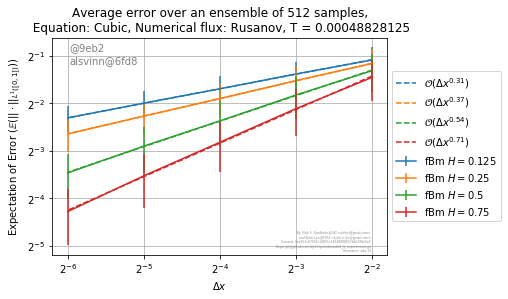

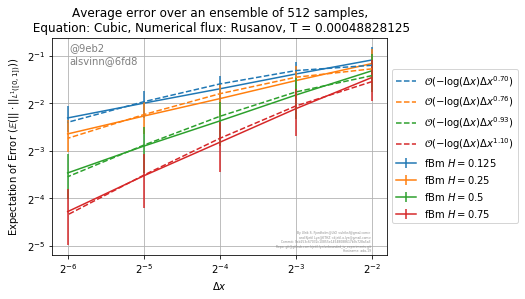

2019-04-27 08:28:55.864329 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.00048828125, flux=roe, equation=cubic
2019-04-27 08:50:14.762990 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml cubic roe 0.00048828125
2019-04-27 08:50:14.785899 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.00048828125, flux=roe, equation=cubic
2019-04-27 09:11:33.521451 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml cubic roe 0.00048828125
2019-04-27 09:11:33.545185 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.00048828125, flux=roe, equation=cubic
2019-04-27 09:32:56.517927 (in run_average_convergence): Done configuration ../configs/frac

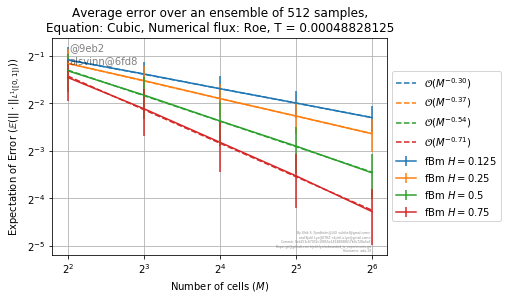

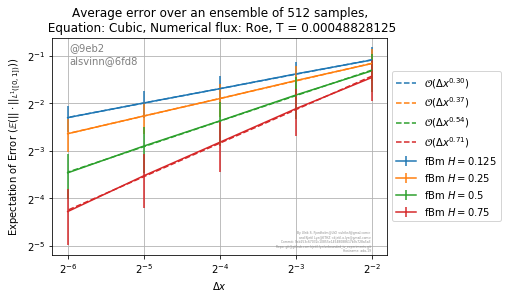

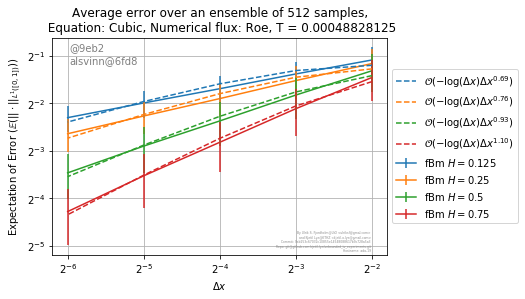

2019-04-27 09:54:28.491053 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.00048828125, flux=rusanov, equation=linear
2019-04-27 10:15:53.213706 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml linear rusanov 0.00048828125
2019-04-27 10:15:53.232504 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.00048828125, flux=rusanov, equation=linear
2019-04-27 10:37:11.972559 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml linear rusanov 0.00048828125
2019-04-27 10:37:11.992327 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.00048828125, flux=rusanov, equation=linear
2019-04-27 10:58:31.604828 (in run_average_convergence): Done conf

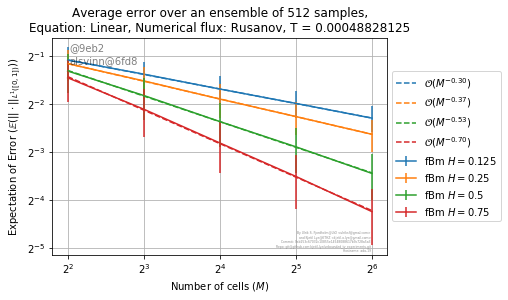

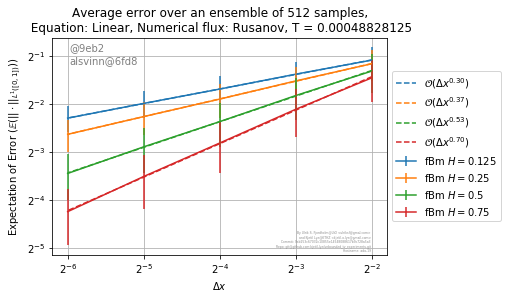

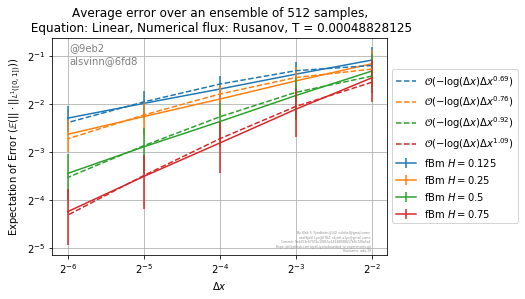

2019-04-27 11:20:05.379372 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.00048828125, flux=upwind, equation=linear
2019-04-27 11:41:29.365495 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml linear upwind 0.00048828125
2019-04-27 11:41:29.384280 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.00048828125, flux=upwind, equation=linear
2019-04-27 12:02:48.193384 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml linear upwind 0.00048828125
2019-04-27 12:02:48.212666 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.00048828125, flux=upwind, equation=linear
2019-04-27 12:29:09.548354 (in run_average_convergence): Done configura

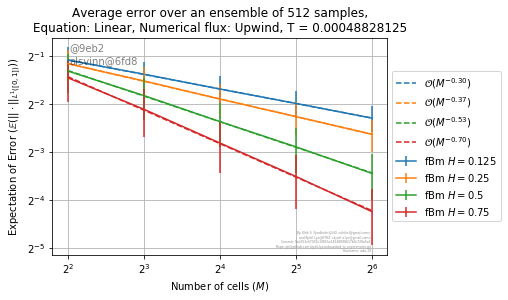

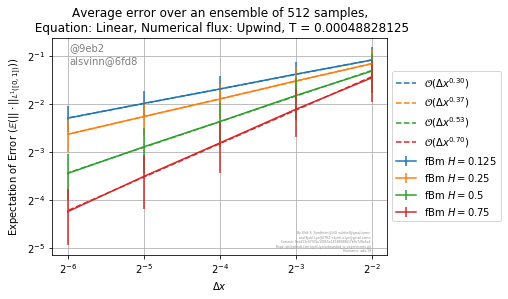

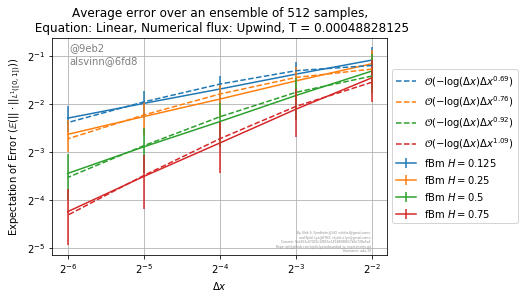

2019-04-27 12:56:55.910307 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.00390625, flux=rusanov, equation=burgers
2019-04-27 13:39:30.681473 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml burgers rusanov 0.00390625
2019-04-27 13:39:30.702538 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.00390625, flux=rusanov, equation=burgers
2019-04-27 14:22:53.905963 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml burgers rusanov 0.00390625
2019-04-27 14:22:53.925858 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.00390625, flux=rusanov, equation=burgers
2019-04-27 15:07:05.024412 (in run_average_convergence): Done configuration 

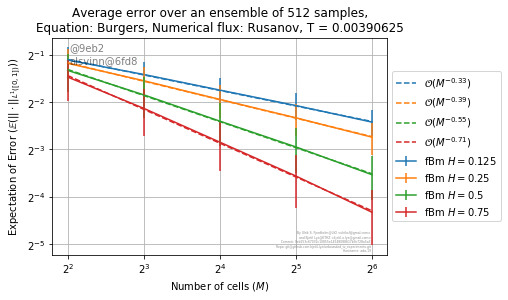

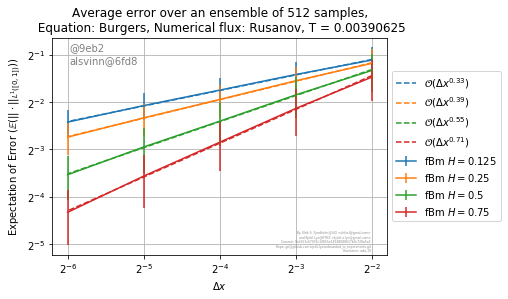

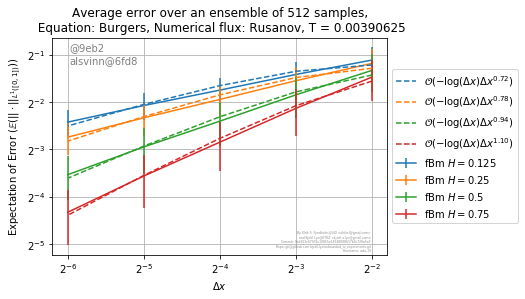

2019-04-27 15:51:29.654204 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.00390625, flux=godunov, equation=burgers
2019-04-27 16:34:06.781679 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml burgers godunov 0.00390625
2019-04-27 16:34:06.801352 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.00390625, flux=godunov, equation=burgers
2019-04-27 17:17:21.274476 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml burgers godunov 0.00390625
2019-04-27 17:17:21.299067 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.00390625, flux=godunov, equation=burgers
2019-04-27 18:01:29.889269 (in run_average_convergence): Done configuration 

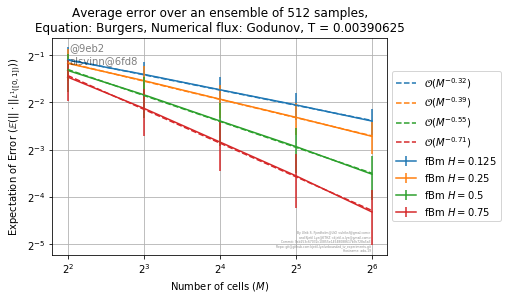

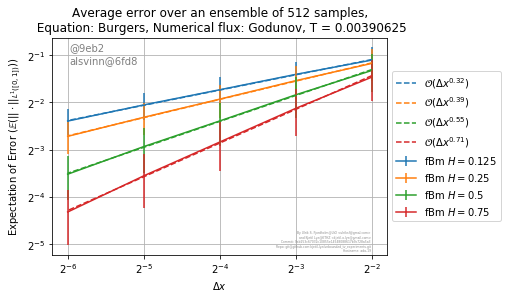

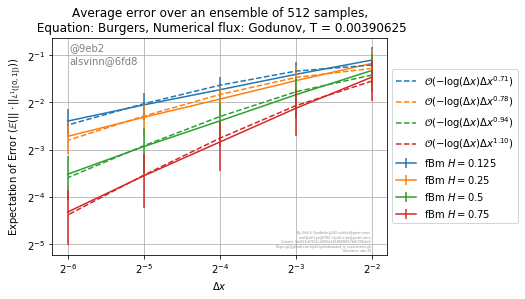

2019-04-27 18:45:48.006344 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.00390625, flux=roe, equation=burgers
2019-04-27 19:28:36.310156 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml burgers roe 0.00390625
2019-04-27 19:28:36.344987 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.00390625, flux=roe, equation=burgers
2019-04-27 20:11:59.033548 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml burgers roe 0.00390625
2019-04-27 20:11:59.067103 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.00390625, flux=roe, equation=burgers
2019-04-27 20:44:48.433258 (in run_average_convergence): Done configuration ../configs/fractiona

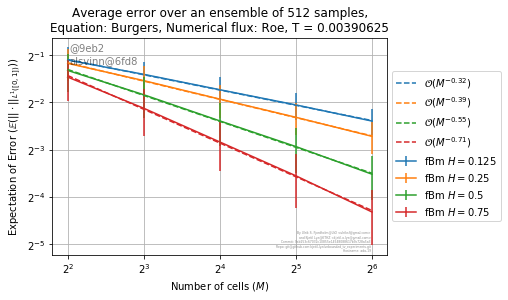

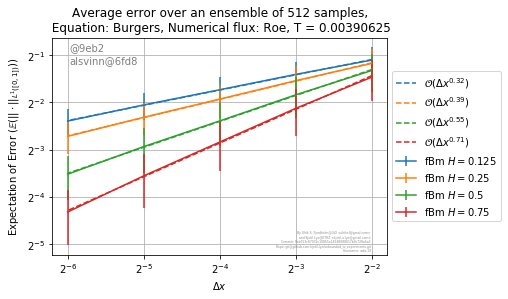

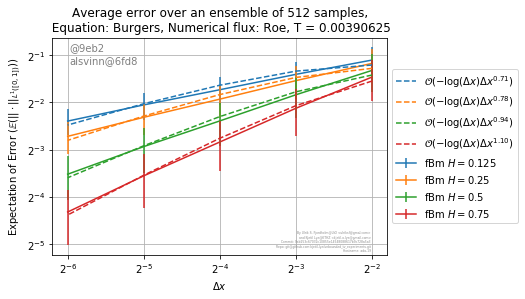

2019-04-27 21:06:32.841454 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.00390625, flux=rusanov, equation=cubic
2019-04-27 21:27:59.073181 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml cubic rusanov 0.00390625
2019-04-27 21:27:59.105159 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.00390625, flux=rusanov, equation=cubic
2019-04-27 21:49:25.988044 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml cubic rusanov 0.00390625
2019-04-27 21:49:26.018585 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.00390625, flux=rusanov, equation=cubic
2019-04-27 22:10:52.768673 (in run_average_convergence): Done configuration ../configs

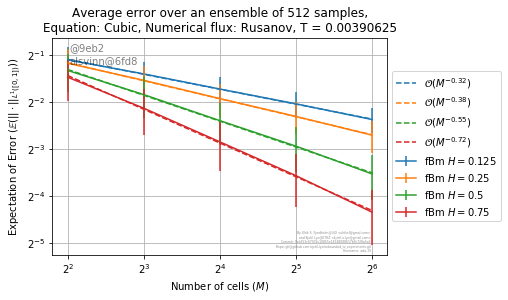

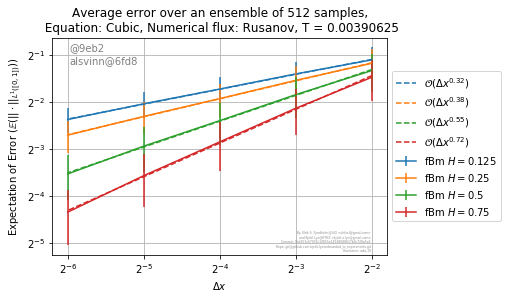

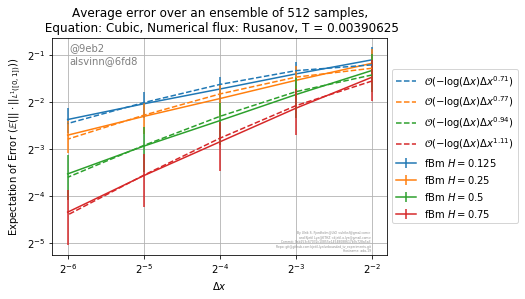

2019-04-27 22:32:32.760791 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.00390625, flux=roe, equation=cubic
2019-04-27 22:54:01.218996 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml cubic roe 0.00390625
2019-04-27 22:54:01.248875 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.00390625, flux=roe, equation=cubic
2019-04-27 23:15:37.337764 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml cubic roe 0.00390625
2019-04-27 23:15:37.358742 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.00390625, flux=roe, equation=cubic
2019-04-27 23:37:07.325703 (in run_average_convergence): Done configuration ../configs/fractional_brownian

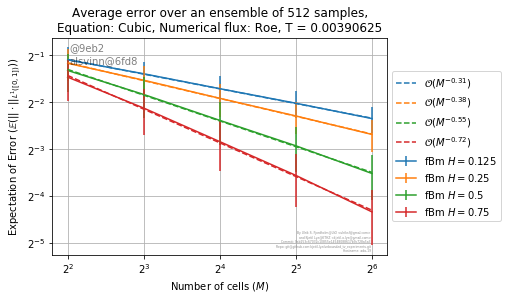

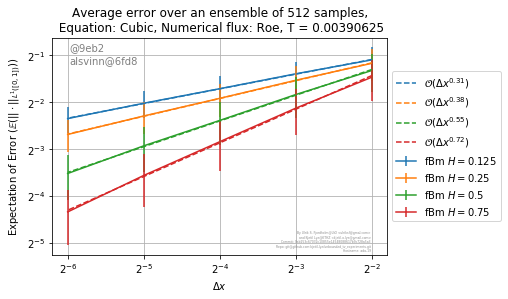

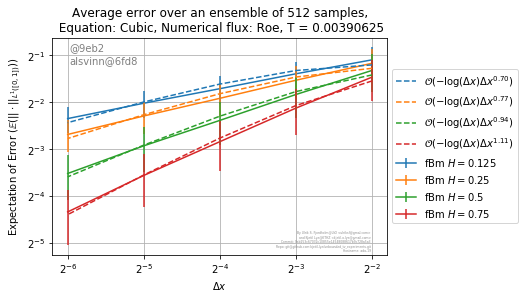

2019-04-27 23:58:45.978410 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.00390625, flux=rusanov, equation=linear
2019-04-28 00:20:41.462347 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml linear rusanov 0.00390625
2019-04-28 00:20:41.493709 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.00390625, flux=rusanov, equation=linear
2019-04-28 00:42:43.789897 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml linear rusanov 0.00390625
2019-04-28 00:42:43.820956 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.00390625, flux=rusanov, equation=linear
2019-04-28 01:04:12.900234 (in run_average_convergence): Done configuration ../co

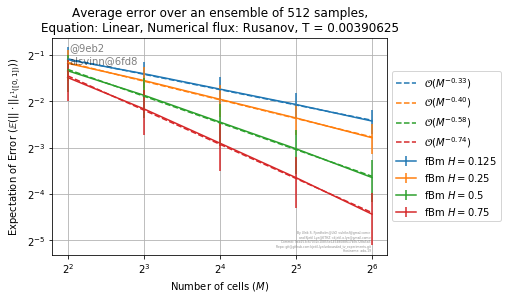

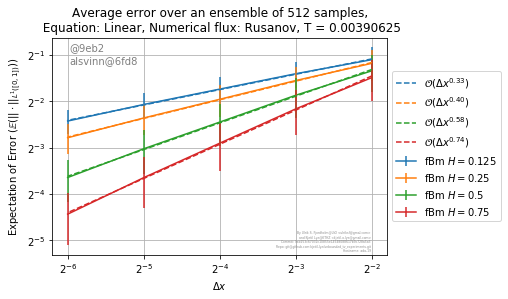

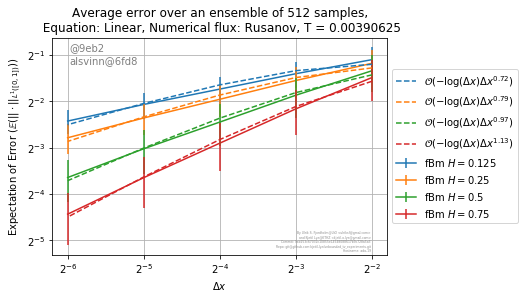

2019-04-28 01:25:57.671539 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.00390625, flux=upwind, equation=linear
2019-04-28 01:47:25.758116 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml linear upwind 0.00390625
2019-04-28 01:47:25.790053 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.00390625, flux=upwind, equation=linear
2019-04-28 02:08:55.382526 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml linear upwind 0.00390625
2019-04-28 02:08:59.495292 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.00390625, flux=upwind, equation=linear
2019-04-28 02:30:46.301790 (in run_average_convergence): Done configuration ../configs

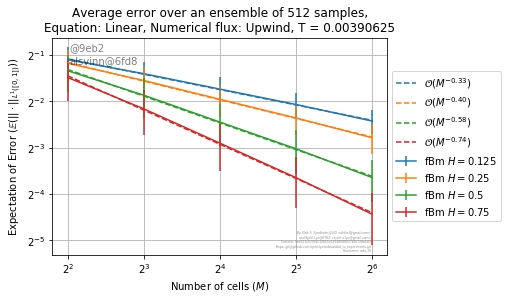

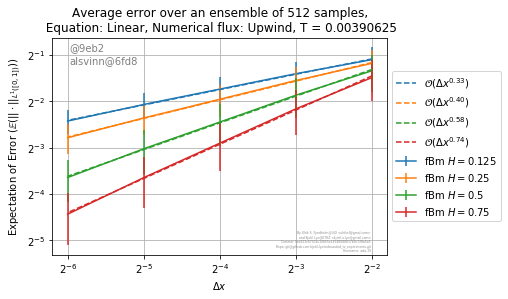

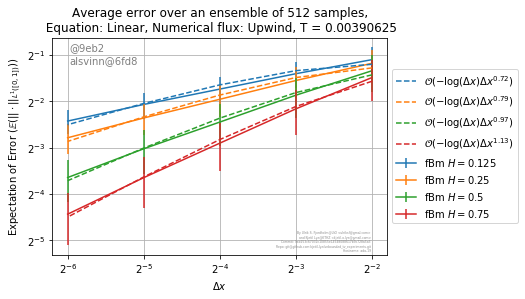

2019-04-28 02:53:24.445514 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.125, flux=rusanov, equation=burgers
2019-04-28 03:16:29.159040 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml burgers rusanov 0.125
2019-04-28 03:16:29.183038 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.125, flux=rusanov, equation=burgers
2019-04-28 03:39:53.481579 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml burgers rusanov 0.125
2019-04-28 03:39:53.510390 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.125, flux=rusanov, equation=burgers
2019-04-28 04:03:42.547421 (in run_average_convergence): Done configuration ../configs/fractional_bro

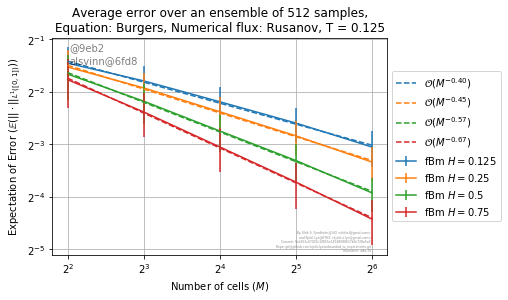

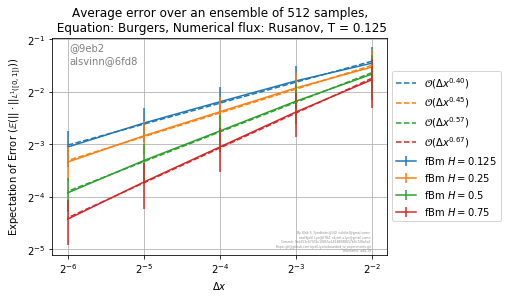

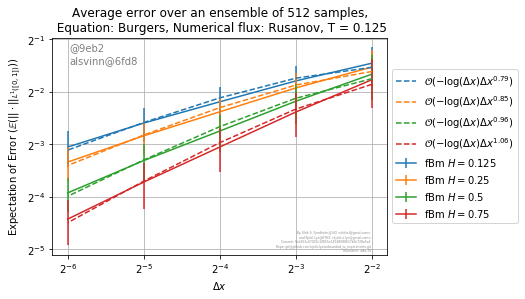

2019-04-28 04:28:09.014299 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.125, flux=godunov, equation=burgers
2019-04-28 04:51:18.747650 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml burgers godunov 0.125
2019-04-28 04:51:18.769266 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.125, flux=godunov, equation=burgers
2019-04-28 05:14:40.937967 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml burgers godunov 0.125
2019-04-28 05:14:40.962116 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.125, flux=godunov, equation=burgers
2019-04-28 05:38:44.796347 (in run_average_convergence): Done configuration ../configs/fractional_bro

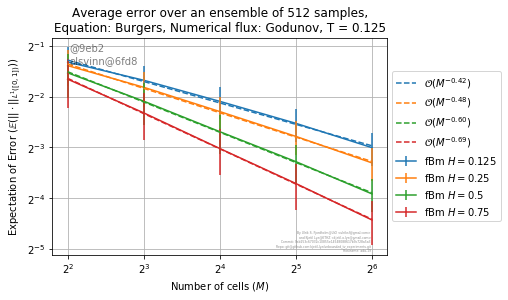

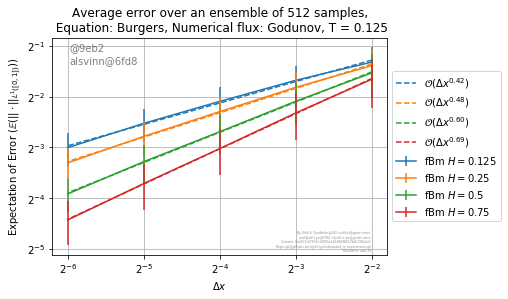

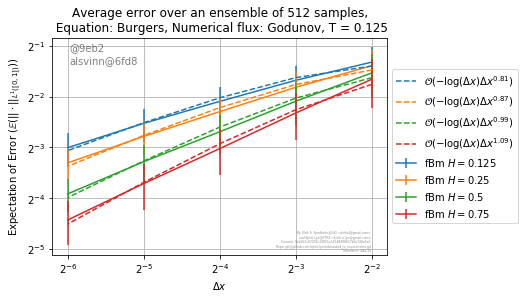

2019-04-28 06:03:09.751342 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.125, flux=roe, equation=burgers
2019-04-28 06:26:25.910326 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml burgers roe 0.125
2019-04-28 06:26:25.936012 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.125, flux=roe, equation=burgers
2019-04-28 06:49:33.561743 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml burgers roe 0.125
2019-04-28 06:49:33.584163 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.125, flux=roe, equation=burgers
2019-04-28 07:13:37.920345 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_5/fractional

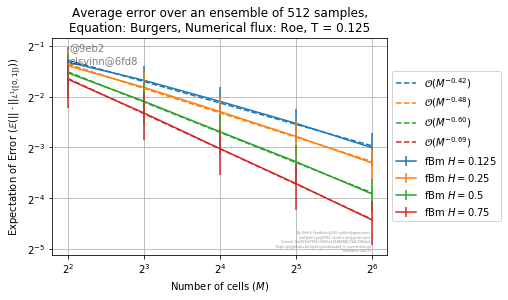

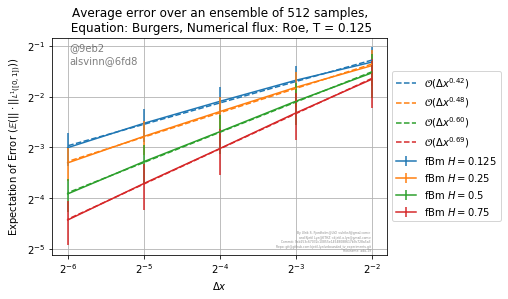

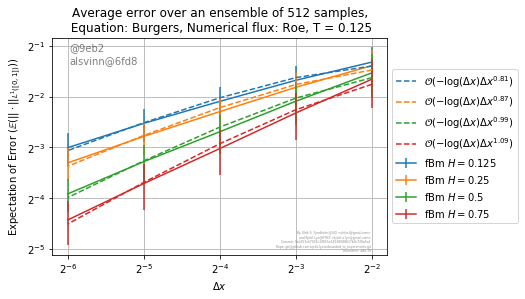

2019-04-28 07:37:31.369341 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.125, flux=rusanov, equation=cubic
2019-04-28 07:59:57.244427 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml cubic rusanov 0.125
2019-04-28 07:59:57.266096 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.125, flux=rusanov, equation=cubic
2019-04-28 08:23:04.060030 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml cubic rusanov 0.125
2019-04-28 08:23:04.080752 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.125, flux=rusanov, equation=cubic
2019-04-28 08:46:53.692745 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_5/

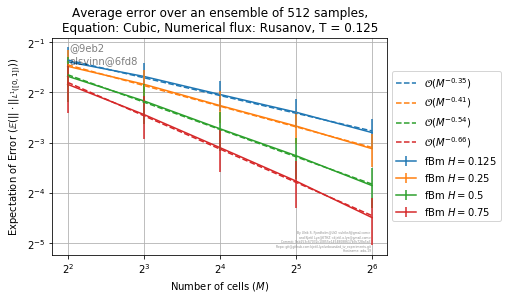

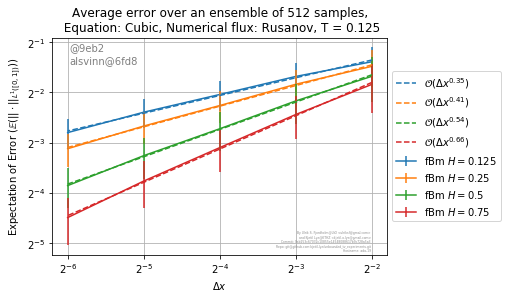

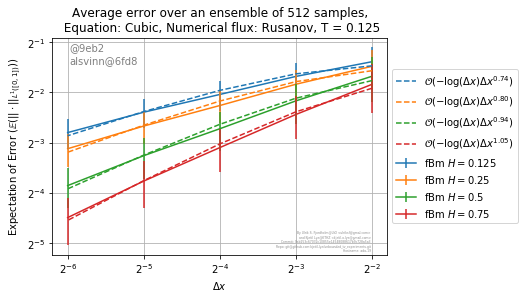

2019-04-28 09:10:56.938141 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.125, flux=roe, equation=cubic
2019-04-28 09:33:23.792792 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml cubic roe 0.125
2019-04-28 09:33:23.816421 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.125, flux=roe, equation=cubic
2019-04-28 09:56:09.803606 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml cubic roe 0.125
2019-04-28 09:56:09.828040 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.125, flux=roe, equation=cubic
2019-04-28 10:19:36.913039 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.

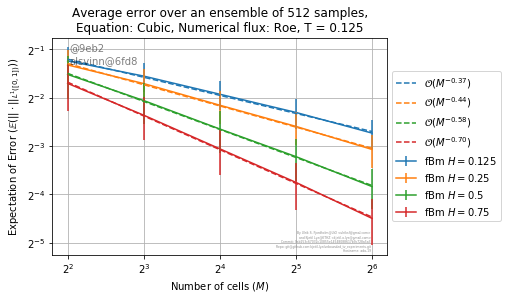

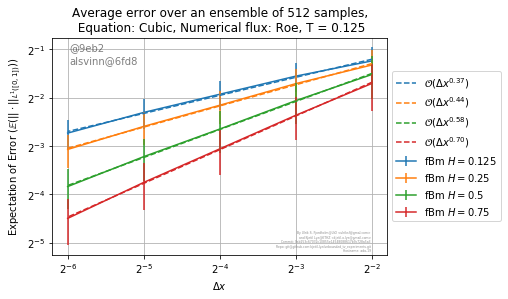

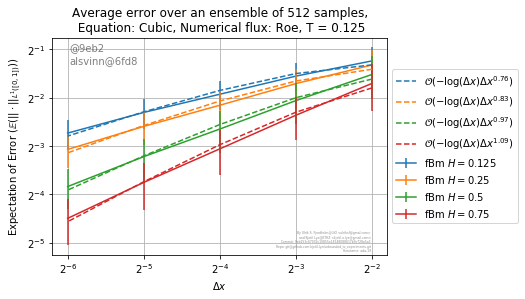

2019-04-28 10:43:50.611018 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.125, flux=rusanov, equation=linear
2019-04-28 11:07:52.802969 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml linear rusanov 0.125
2019-04-28 11:07:52.826229 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.125, flux=rusanov, equation=linear
2019-04-28 11:31:39.089814 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml linear rusanov 0.125
2019-04-28 11:31:39.111690 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.125, flux=rusanov, equation=linear
2019-04-28 11:55:25.582296 (in run_average_convergence): Done configuration ../configs/fractional_brownian

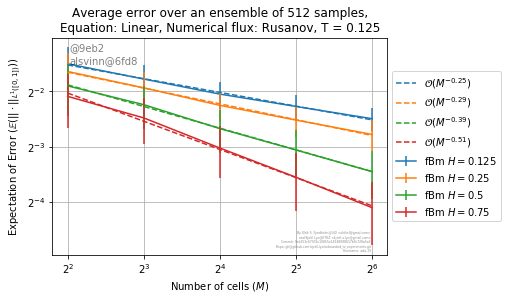

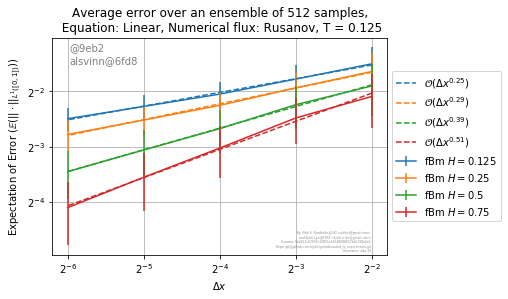

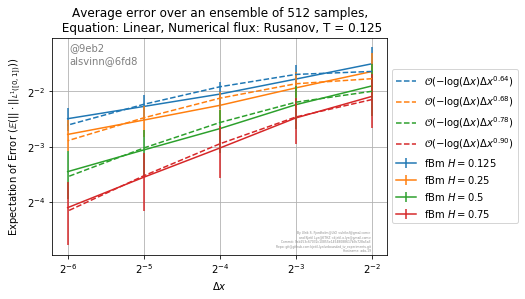

2019-04-28 12:19:30.390567 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.125, flux=upwind, equation=linear
2019-04-28 12:43:16.580266 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml linear upwind 0.125
2019-04-28 12:43:16.603463 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.125, flux=upwind, equation=linear
2019-04-28 13:06:53.200428 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml linear upwind 0.125
2019-04-28 13:06:53.222631 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.125, flux=upwind, equation=linear
2019-04-28 13:30:34.757318 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_5/

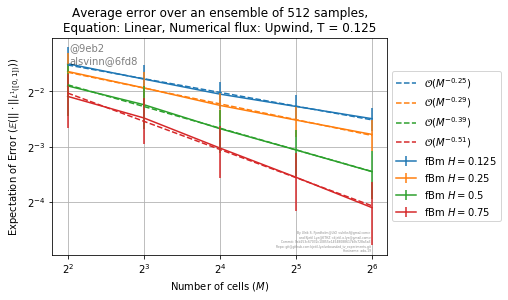

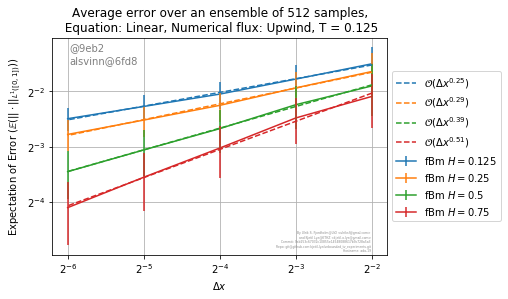

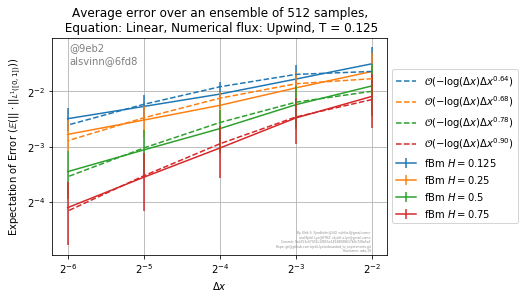

2019-04-28 13:54:45.766979 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.25, flux=rusanov, equation=burgers
2019-04-28 14:19:34.327839 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml burgers rusanov 0.25
2019-04-28 14:19:34.351665 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.25, flux=rusanov, equation=burgers
2019-04-28 14:45:06.521071 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml burgers rusanov 0.25
2019-04-28 14:45:11.040654 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.25, flux=rusanov, equation=burgers
2019-04-28 15:11:27.274430 (in run_average_convergence): Done configuration ../configs/fractional_brownian

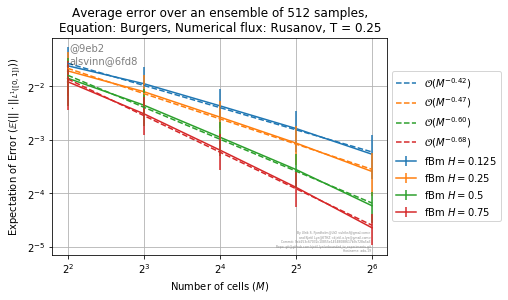

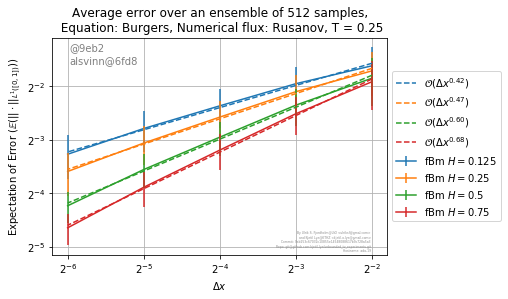

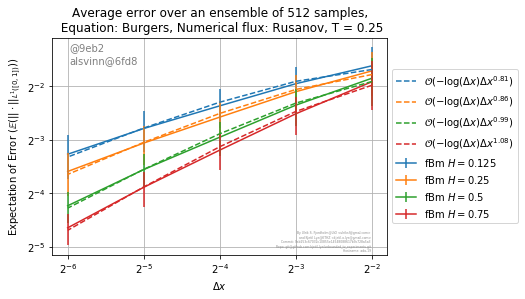

2019-04-28 15:38:29.932399 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.25, flux=godunov, equation=burgers
2019-04-28 16:03:42.060120 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml burgers godunov 0.25
2019-04-28 16:03:42.083811 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.25, flux=godunov, equation=burgers
2019-04-28 16:29:43.921886 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml burgers godunov 0.25
2019-04-28 16:29:43.948420 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.25, flux=godunov, equation=burgers
2019-04-28 16:56:19.872882 (in run_average_convergence): Done configuration ../configs/fractional_brownian

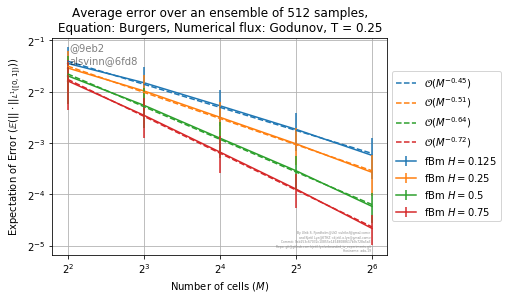

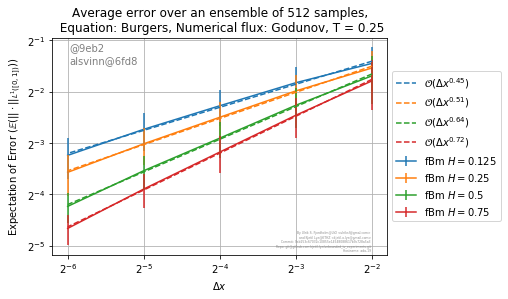

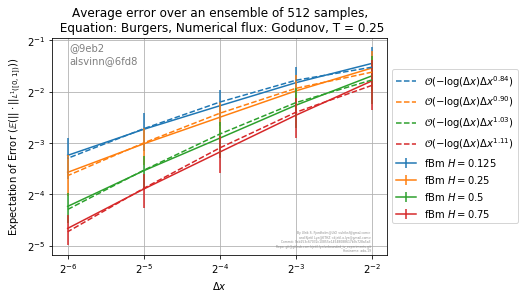

2019-04-28 17:23:06.506715 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.25, flux=roe, equation=burgers
2019-04-28 17:48:04.103242 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml burgers roe 0.25
2019-04-28 17:48:04.126426 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.25, flux=roe, equation=burgers
2019-04-28 18:13:34.892069 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml burgers roe 0.25
2019-04-28 18:13:34.913460 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.25, flux=roe, equation=burgers
2019-04-28 18:39:59.142072 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_5/fractional_brow

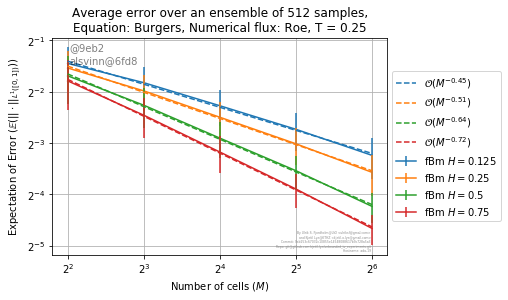

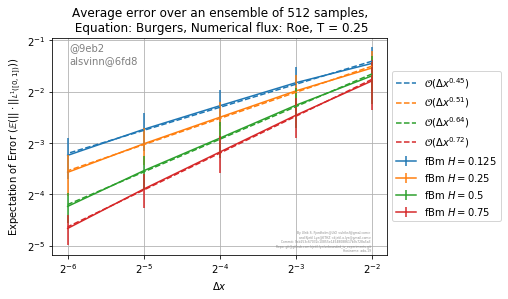

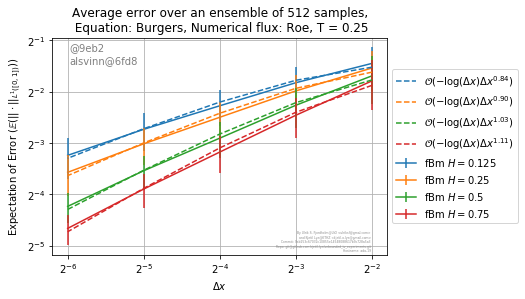

2019-04-28 19:06:52.271338 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.25, flux=rusanov, equation=cubic
2019-04-28 19:31:06.435883 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml cubic rusanov 0.25
2019-04-28 19:31:06.476329 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.25, flux=rusanov, equation=cubic
2019-04-28 19:55:58.457044 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml cubic rusanov 0.25
2019-04-28 19:55:58.493427 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.25, flux=rusanov, equation=cubic
2019-04-28 20:21:34.870730 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_5/fract

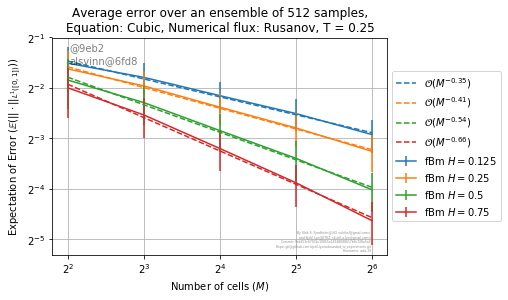

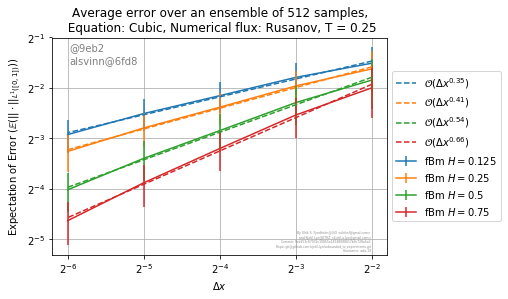

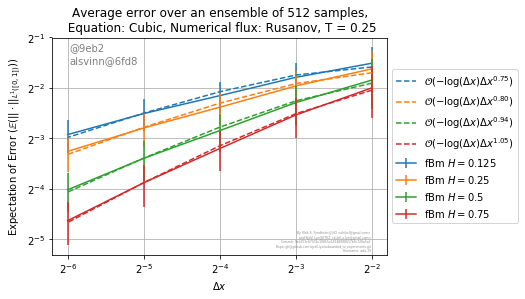

2019-04-28 20:48:07.758393 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.25, flux=roe, equation=cubic
2019-04-28 21:11:30.428233 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml cubic roe 0.25
2019-04-28 21:11:30.457995 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.25, flux=roe, equation=cubic
2019-04-28 21:36:00.203163 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml cubic roe 0.25
2019-04-28 21:36:00.235819 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.25, flux=roe, equation=cubic
2019-04-28 22:01:30.902442 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml c

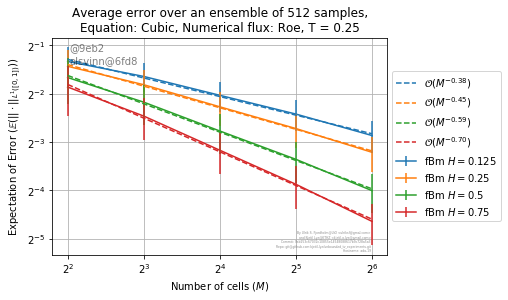

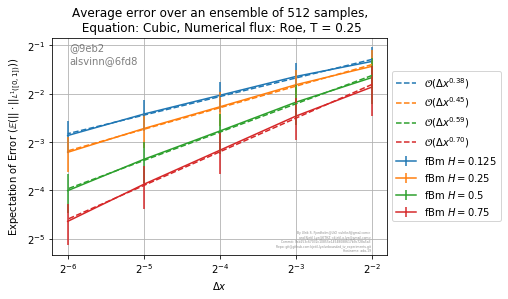

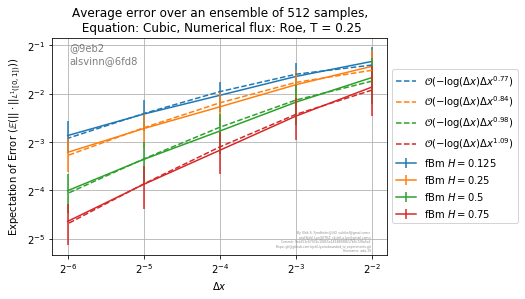

2019-04-28 22:28:04.058134 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.25, flux=rusanov, equation=linear
2019-04-28 22:54:52.832270 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml linear rusanov 0.25
2019-04-28 22:54:52.857172 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.25, flux=rusanov, equation=linear
2019-04-28 23:21:20.188797 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml linear rusanov 0.25
2019-04-28 23:21:20.212582 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.25, flux=rusanov, equation=linear
2019-04-28 23:47:48.357032 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_5/

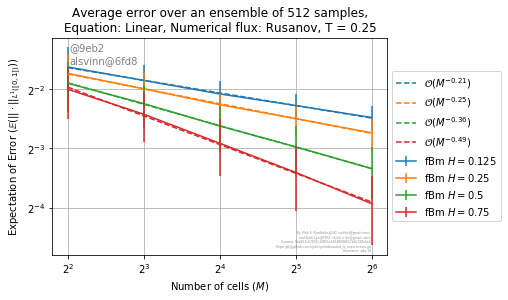

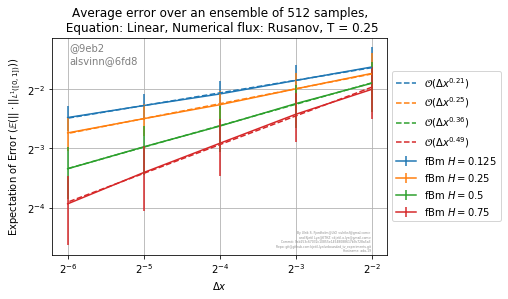

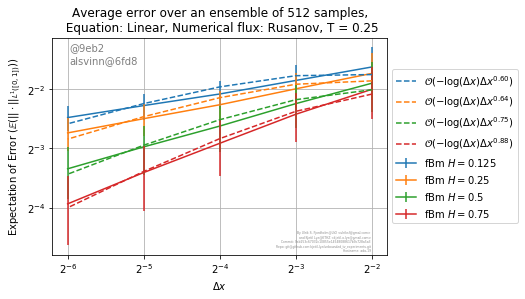

2019-04-29 00:14:23.145606 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=0.25, flux=upwind, equation=linear
2019-04-29 00:43:33.977774 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml linear upwind 0.25
2019-04-29 00:43:34.012084 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=0.25, flux=upwind, equation=linear
2019-04-29 01:09:54.451393 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml linear upwind 0.25
2019-04-29 01:09:54.485379 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=0.25, flux=upwind, equation=linear
2019-04-29 01:36:21.905669 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_5/fract

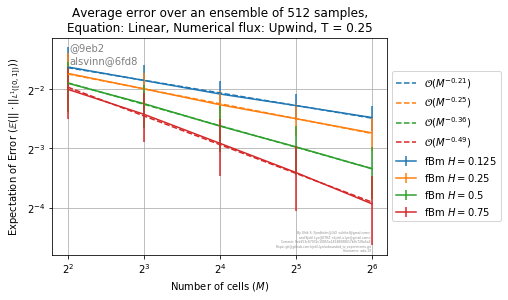

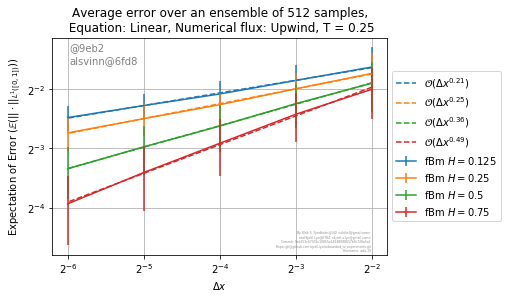

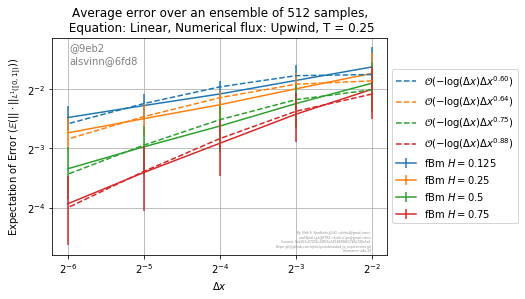

2019-04-29 02:04:20.913611 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=1, flux=rusanov, equation=burgers
2019-04-29 02:38:01.886550 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml burgers rusanov 1
2019-04-29 02:38:01.923033 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=1, flux=rusanov, equation=burgers
2019-04-29 03:12:51.234673 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml burgers rusanov 1
2019-04-29 03:12:51.267127 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=1, flux=rusanov, equation=burgers
2019-04-29 03:51:23.182743 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_5/fractional

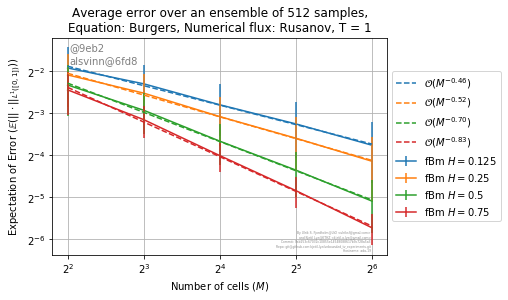

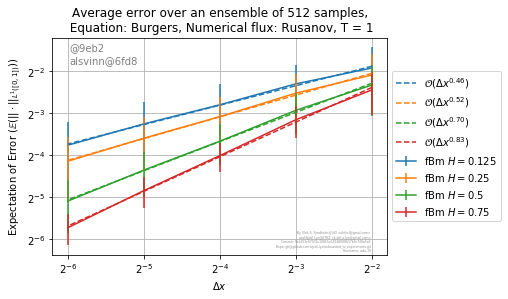

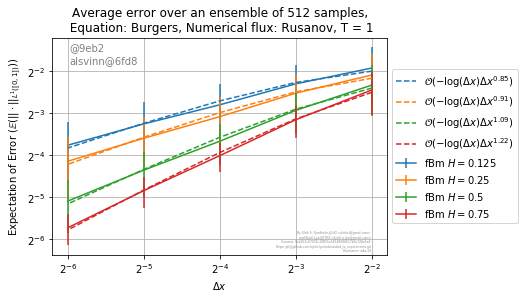

2019-04-29 04:31:27.808566 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=1, flux=godunov, equation=burgers
2019-04-29 05:04:59.165573 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml burgers godunov 1
2019-04-29 05:04:59.186271 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=1, flux=godunov, equation=burgers
2019-04-29 05:40:08.042550 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml burgers godunov 1
2019-04-29 05:40:08.068369 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=1, flux=godunov, equation=burgers
2019-04-29 06:19:26.103360 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_5/fractional

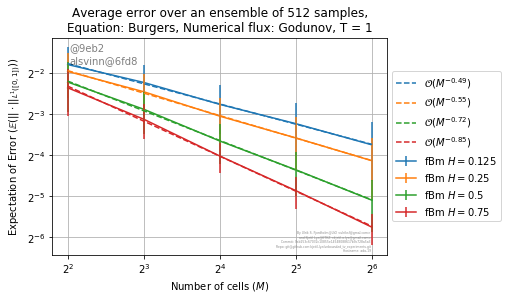

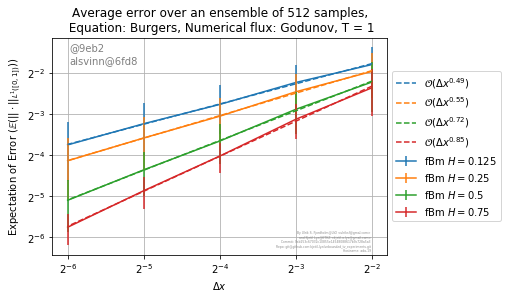

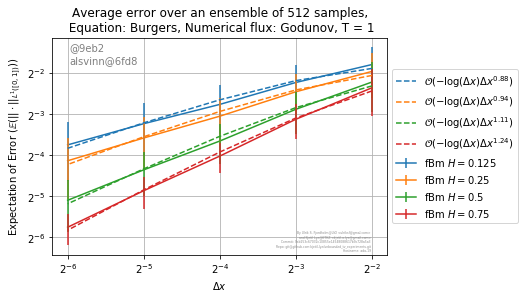

2019-04-29 07:01:24.135659 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=1, flux=roe, equation=burgers
2019-04-29 07:43:38.325252 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml burgers roe 1
2019-04-29 07:43:38.346904 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=1, flux=roe, equation=burgers
2019-04-29 08:18:26.862814 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml burgers roe 1
2019-04-29 08:18:26.886876 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=1, flux=roe, equation=burgers
2019-04-29 08:56:53.327911 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml burger

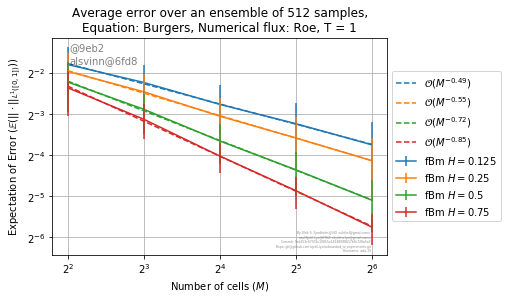

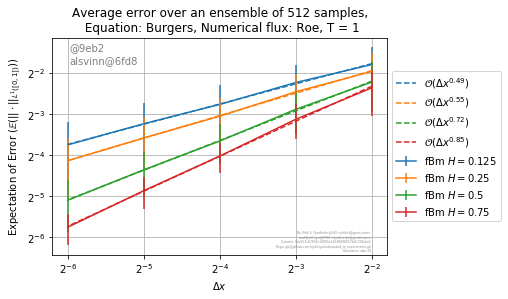

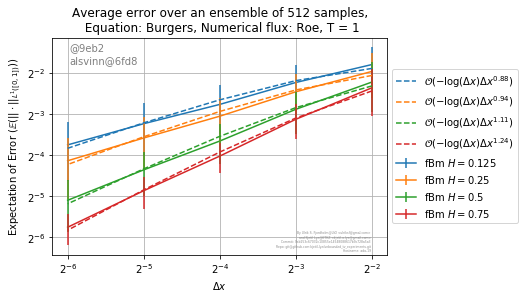

2019-04-29 09:37:08.072005 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=1, flux=rusanov, equation=cubic
2019-04-29 10:05:15.275361 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml cubic rusanov 1
2019-04-29 10:05:15.299352 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=1, flux=rusanov, equation=cubic
2019-04-29 10:35:06.651678 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml cubic rusanov 1
2019-04-29 10:35:06.679267 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=1, flux=rusanov, equation=cubic
2019-04-29 11:09:59.037604 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.

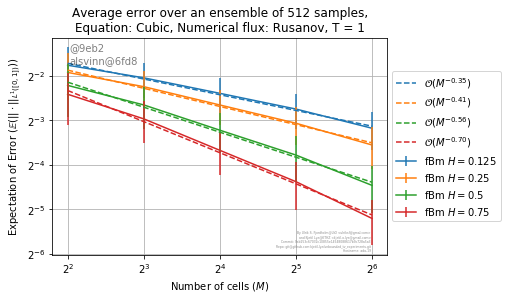

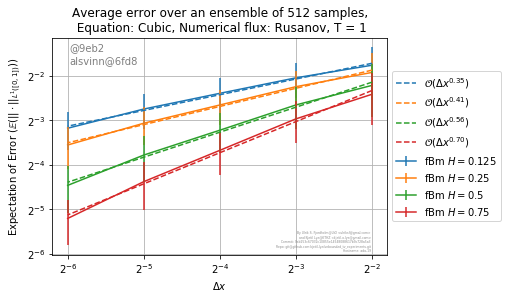

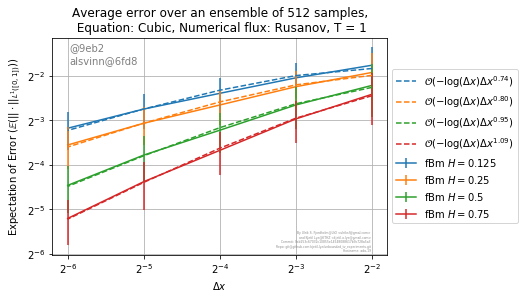

2019-04-29 11:47:13.444632 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=1, flux=roe, equation=cubic
2019-04-29 12:15:24.597575 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml cubic roe 1
2019-04-29 12:15:24.619529 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=1, flux=roe, equation=cubic
2019-04-29 12:45:38.561907 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml cubic roe 1
2019-04-29 12:45:38.586922 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=1, flux=roe, equation=cubic
2019-04-29 13:20:12.795578 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.xml cubic roe 1
2019

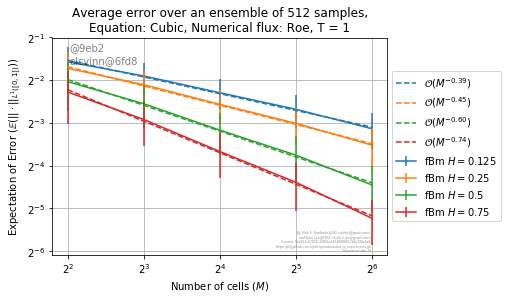

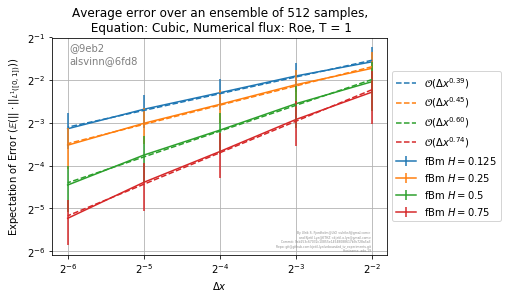

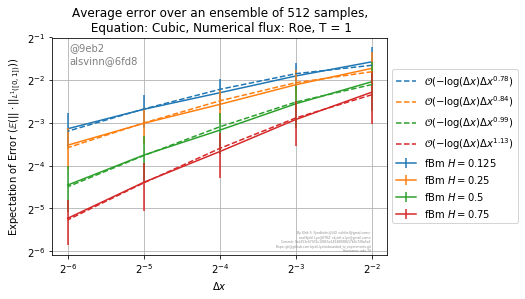

2019-04-29 13:58:14.314426 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=1, flux=rusanov, equation=linear
2019-04-29 14:41:29.872129 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml linear rusanov 1
2019-04-29 14:41:29.895706 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=1, flux=rusanov, equation=linear
2019-04-29 15:24:16.325817 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml linear rusanov 1
2019-04-29 15:24:16.347207 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=1, flux=rusanov, equation=linear
2019-04-29 16:11:02.880711 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_5/fractional_brow

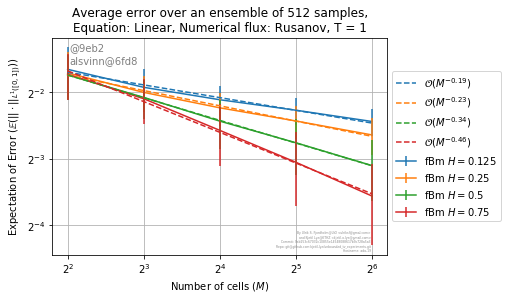

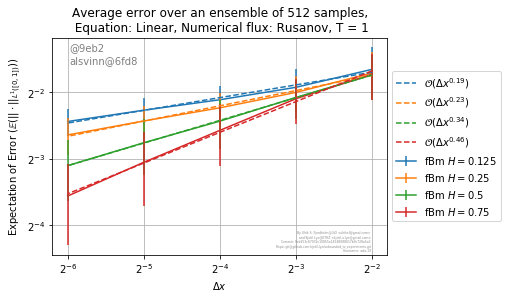

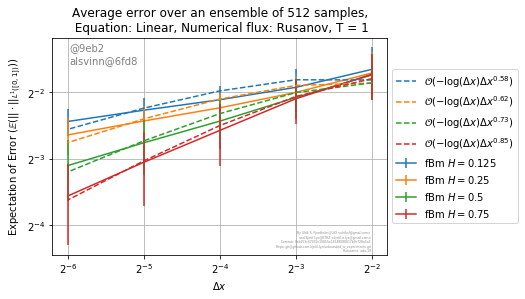

2019-04-29 16:55:49.211640 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_125/fractional_brownian.xml, T=1, flux=upwind, equation=linear
2019-04-29 17:38:24.496615 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_125/fractional_brownian.xml linear upwind 1
2019-04-29 17:38:24.517720 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_25/fractional_brownian.xml, T=1, flux=upwind, equation=linear
2019-04-29 18:21:29.935235 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_25/fractional_brownian.xml linear upwind 1
2019-04-29 18:21:29.959162 (in run_average_convergence): Running run_average_convergence for ../configs/fractional_brownian_0_5/fractional_brownian.xml, T=1, flux=upwind, equation=linear
2019-04-29 19:04:32.625434 (in run_average_convergence): Done configuration ../configs/fractional_brownian_0_5/fractional_brownian.

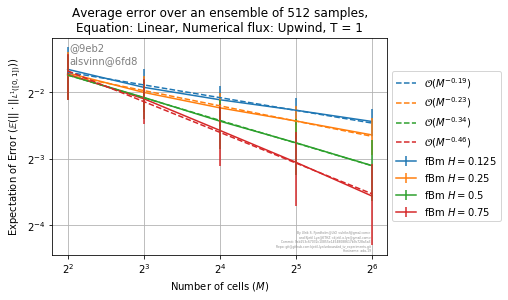

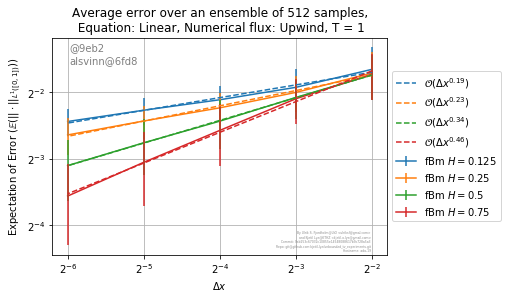

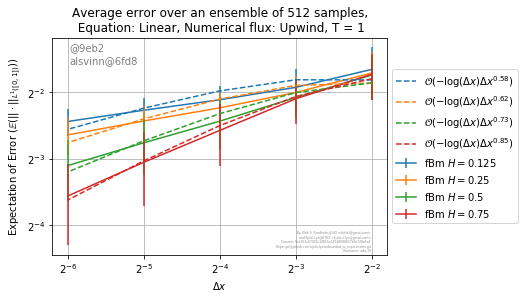

In [20]:
def run_fbm_average_convergence(equation, numerical_flux, exact_solution, T):
    Hs = [0.125, 0.25, 0.5, 0.75]

    base_xml_format_string = '../configs/fractional_brownian_{H_filename}/fractional_brownian.xml'
    number_of_samples = NUMBER_OF_SAMPLES
   
    for H in Hs:
        base_xml = base_xml_format_string.format(H_filename = str(H).replace(".","_"))
        
        name = "fBm $H={H}$".format(H=H)
        
        run_average_convergence(base_xml, name, T, number_of_samples, numerical_flux=numerical_flux,
                   equation=equation, exact_solution_class=exact_solution)
        
    plt.figure(0)
    plt.title("Average error over an ensemble of {number_of_samples} samples,\nEquation: {equation}, Numerical flux: {numerical_flux}, T = {T}"\
              .format(equation=equation.capitalize(), number_of_samples=number_of_samples, numerical_flux=numerical_flux.capitalize(), T=T))
    
    
    plot_info.legendLeft()
    plot_info.savePlot("fbm_avg_convergence_M_{equation}_{numerical_flux}_{T}"
                .format(equation=equation, numerical_flux=numerical_flux, 
                        T=str(T).replace(".", "_")))
    
    
    plt.figure(1)
    plt.title("Average error over an ensemble of {number_of_samples} samples,\n Equation: {equation}, Numerical flux: {numerical_flux}, T = {T}"\
              .format(number_of_samples=number_of_samples, equation=equation.capitalize(), numerical_flux=numerical_flux.capitalize(), T=T))
    
    
    plot_info.legendLeft()
    plot_info.savePlot("fbm_avg_convergence_dx_{equation}_{numerical_flux}_{T}"
                .format(equation=equation, numerical_flux=numerical_flux, 
                        T=str(T).replace(".", "_")))
    
    
    plt.figure(2)
    plt.title("Average error over an ensemble of {number_of_samples} samples,\n Equation: {equation}, Numerical flux: {numerical_flux}, T = {T}"\
              .format(number_of_samples=number_of_samples, equation=equation.capitalize(), numerical_flux=numerical_flux.capitalize(), T=T))
    
    
    plot_info.legendLeft()
    plot_info.savePlot("fbm_avg_convergence_log_dx_{equation}_{numerical_flux}_{T}"
                .format(equation=equation, numerical_flux=numerical_flux, 
                        T=str(T).replace(".", "_")))
    
    plt.show()
    
for T in [1/2048., 1/256., 1/8, 1.0/4, 1]:
    run_all_configurations(run_fbm_average_convergence, T)
                                             